In [3]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
display(HTML("<style>.output_result { max-width:100% !important; }</style>"))

/tmp/ipykernel_122824/3706820736.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [1]:
import os
import sys
sys.path.append('/home/thabib/htm_sequence_learning/examples')
os.chdir('/home/thabib/htm_sequence_learning/')
os.getcwd()

'/home/thabib/htm_sequence_learning'

In [2]:
from pathlib import Path
import numpy as np
from IPython.display import display

from examples.iostream_analyzer import compute_input_stats
from htm_sequence_learning.metrics import compute_network_performance

ROOT = os.getcwd() # os.path.join(Path(os.getcwd()).parent.parent)
print(ROOT)

experiments_results_path = os.path.join(ROOT, 'data', 'experiment_results')
reber_strings_dataset_path = os.path.join(ROOT, 'data', 'reber_strings_dataset')

2022-03-22 12:19:59,785 - numexpr.utils : INFO :- NumExpr defaulting to 8 threads.


/home/thabib/htm_sequence_learning


# Loading input stream and experiment results

#### Loading Reber Grammar input stream

In [3]:
rg_io_filename = 'graph2_mix_numStrings2000_ergFalse_sortFalse.npy'

with open(os.path.join(reber_strings_dataset_path, rg_io_filename), 'rb') as dt:
    rg_inputoutput = np.load(dt, allow_pickle=True)
    
print(rg_inputoutput.shape)
rg_inputoutput

(2000, 3)


array([['APSTXZ', array([[0, 0, 0, ..., 0, 0, 0],
                         [0, 0, 0, ..., 0, 0, 0],
                         [0, 0, 0, ..., 0, 1, 0],
                         [0, 0, 0, ..., 0, 0, 0],
                         [0, 1, 0, ..., 0, 0, 1]], dtype=int8),
        array([[0, 0, 0, ..., 0, 0, 0],
               [0, 0, 1, ..., 1, 1, 0],
               [0, 1, 0, ..., 0, 0, 1],
               [0, 1, 0, ..., 0, 0, 1],
               [1, 0, 0, ..., 0, 0, 0]], dtype=int8)],
       ['ATSSSSSSPVZ', array([[0, 0, 0, ..., 0, 0, 0],
                              [0, 0, 0, ..., 0, 0, 0],
                              [0, 0, 0, ..., 0, 1, 0],
                              ...,
                              [0, 0, 0, ..., 0, 1, 0],
                              [0, 0, 0, ..., 0, 0, 0],
                              [0, 0, 1, ..., 1, 0, 0]], dtype=int8),
        array([[0, 0, 0, ..., 0, 0, 0],
               [0, 0, 0, ..., 0, 1, 0],
               [0, 0, 0, ..., 0, 1, 0],
               ...,
  

#### Input stream stats

2022-03-22 11:52:54,097 - root : INFO :- Reading input stream file...
2022-03-22 11:52:54,312 - root : INFO :- The stream consists of a total of 2000 strings. 
    With: 
    Number of characters in total = 16052. 
    Mean length of string = 8.026. 
    Median length of string = 7.0. 
    
 Unique Strings = ['APSTTTTTTTTTTXZ' 'APSTTTTTTTTTXZ' 'APSTTTTTTTXZ' 'APSTTTTTTXZ'
 'APSTTTTTXZ' 'APSTTTTXZ' 'APSTTTXZ' 'APSTTXZ' 'APSTXZ' 'APSXZ' 'APVPVZ'
 'APVPXSTTTTTTTXZ' 'APVPXSTTTTTTXZ' 'APVPXSTTTXZ' 'APVPXSTTXZ' 'APVPXSTXZ'
 'APVPXSXZ' 'APVPXVPVZ' 'APVPXVPXSTTTTXZ' 'APVPXVPXSXZ' 'APVPXVPXVPVZ'
 'APVPXVPXVPXSXZ' 'APVPXVPXVSPVZ' 'APVPXVPXVSSSSPXVPXVSPVZ'
 'APVPXVPXVSSSSSPXSXZ' 'APVPXVSPVZ' 'APVPXVSPXSTTTXZ' 'APVPXVSPXSXZ'
 'APVPXVSPXVPXSXZ' 'APVPXVSPXVSSSSPVZ' 'APVPXVSPXVSSSSPXVSSSSPVZ'
 'APVPXVSSPVZ' 'APVPXVSSPXSTTXZ' 'APVPXVSSPXSTXZ' 'APVPXVSSPXVSSPXSTXZ'
 'APVPXVSSSPVZ' 'APVPXVSSSPXSTTTXZ' 'APVPXVSSSPXVSPVZ'
 'APVPXVSSSPXVSPXVPXSXZ' 'APVPXVSSSPXVSSSPXVPXVPXVSPXSTXZ' 'APVPXVSSSSPVZ'
 'APVPXVS

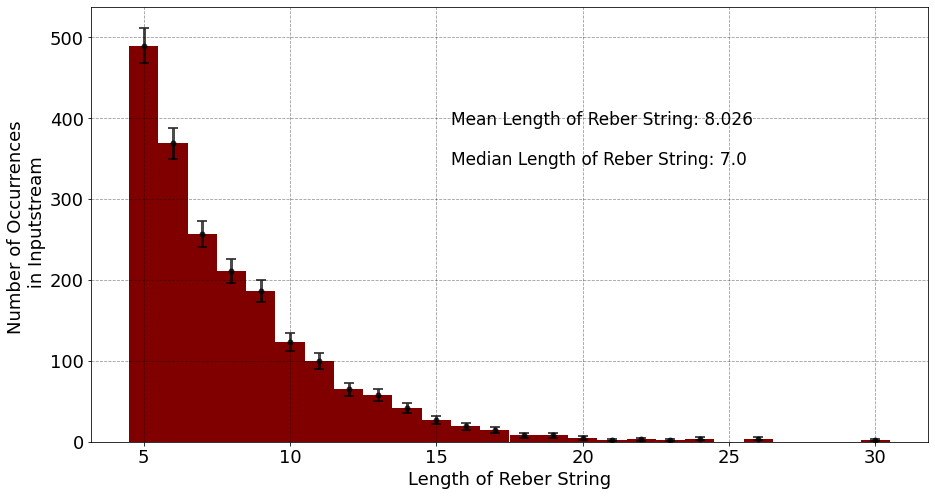

2022-03-22 11:52:54,511 - root : INFO :- Plotting distribution of possible transitions (trigrams) in reber strings in the inputstream...


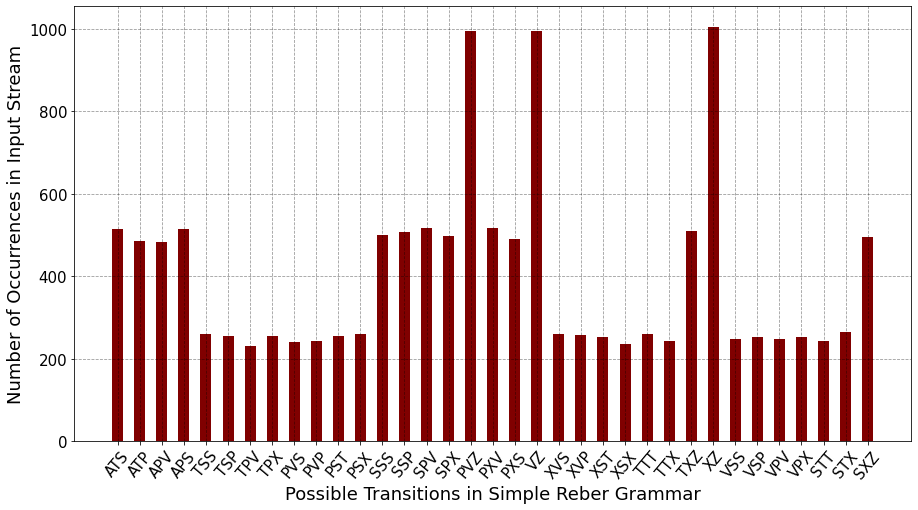

In [5]:
compute_input_stats(rg_iostream=rg_io_filename, print_all=False, make_plots=True, save_figures=False)

#### Load (pre-saved) results file from the project

In [4]:
result_filename = 'MODELdefault_config_DATASET' + rg_io_filename.replace('.npy', '') + '_NORMALIZEFalse_PRUNEFalse_RUNS5.npz'

with open(os.path.join(experiments_results_path, result_filename), 'rb') as dt:
    res = np.load(dt, allow_pickle=True)
    experiment_results = dict(res)
    
experiment_results.keys()

dict_keys(['total_len_inputstreams', 'string_step_lookups', 'df_results', 'final_networks', 'grammar'])

In [7]:
experiment_results['df_results'][0].shape

(2000, 7)

# Performance Analysis

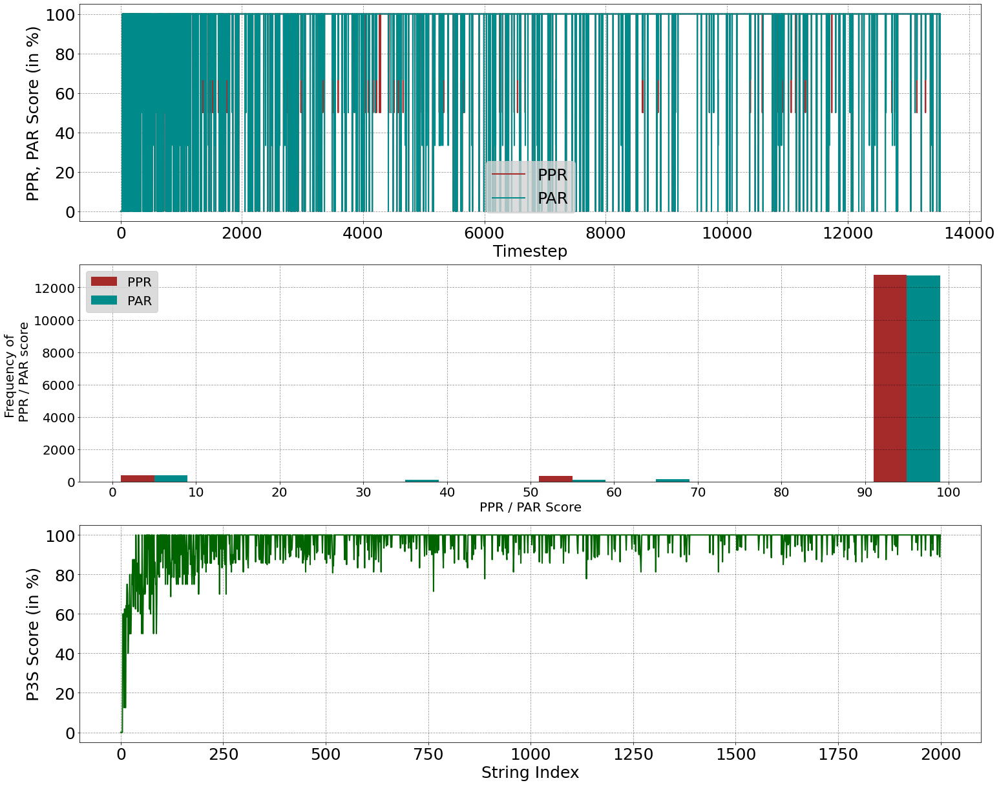

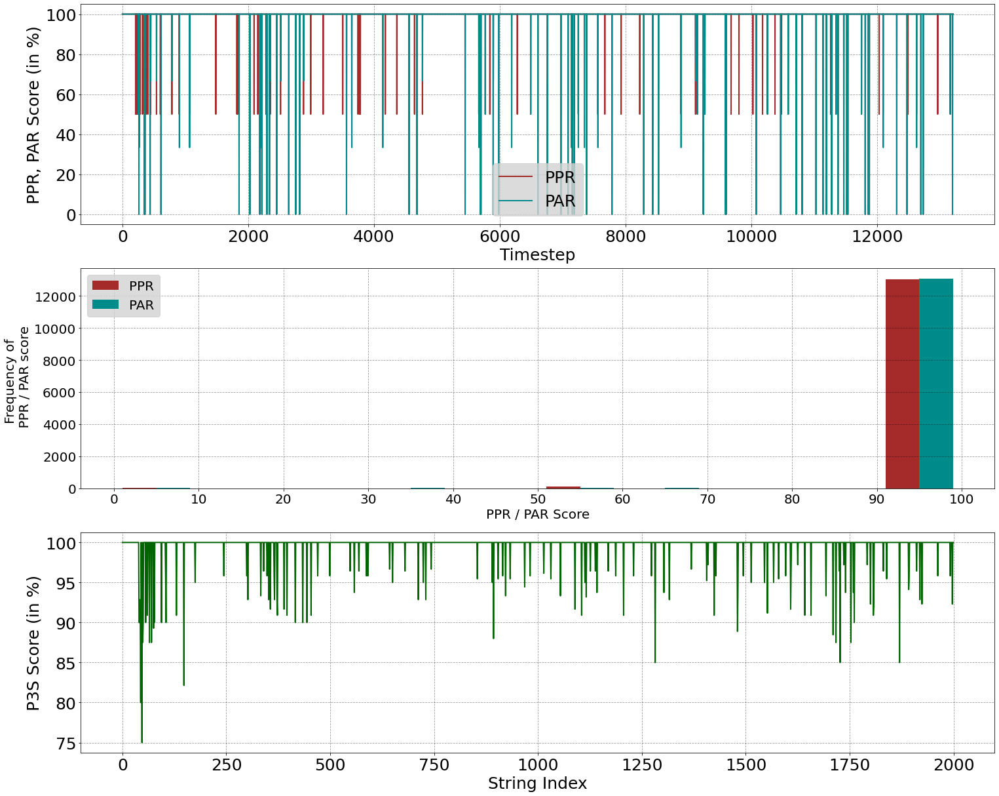

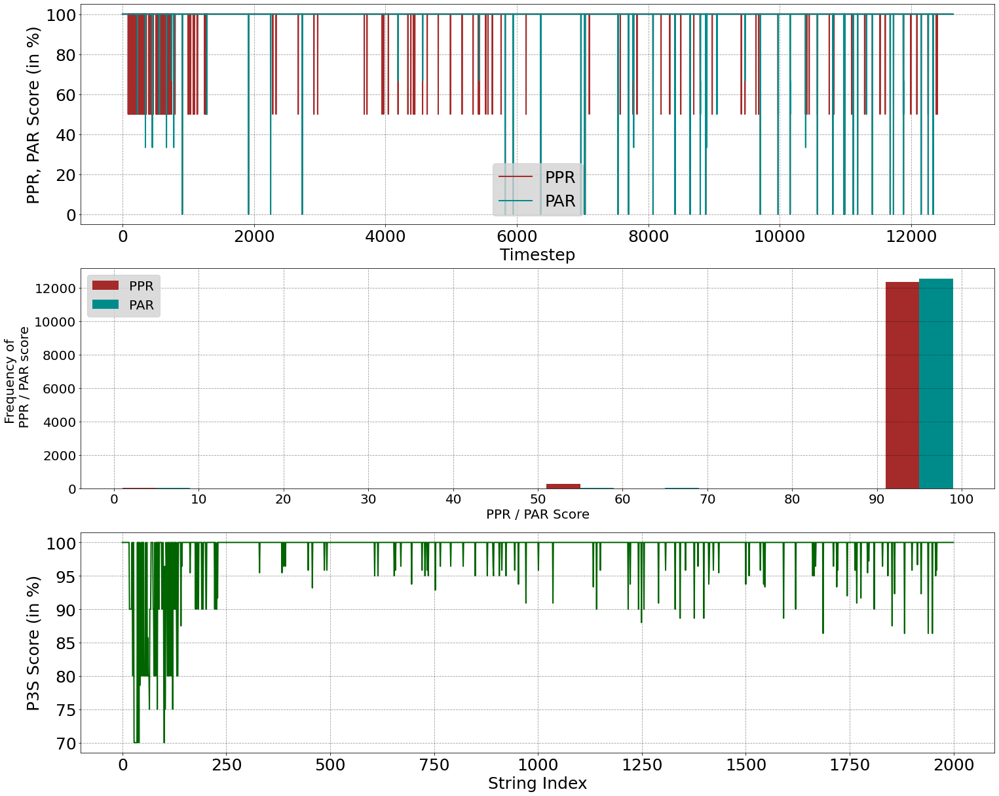

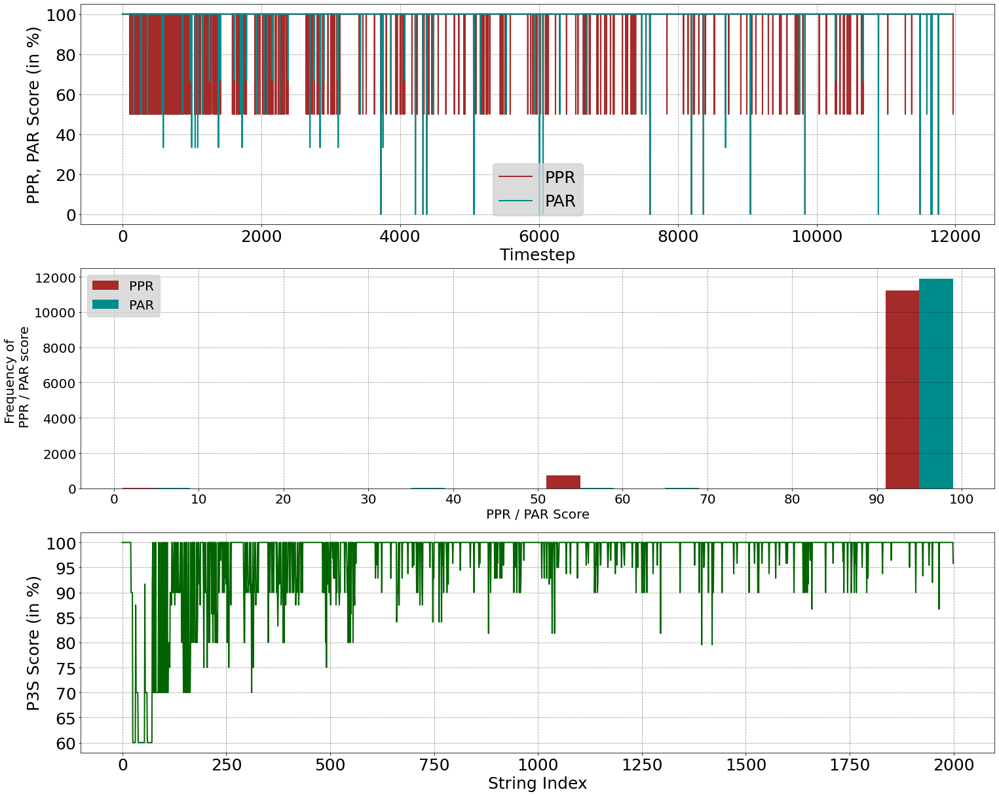

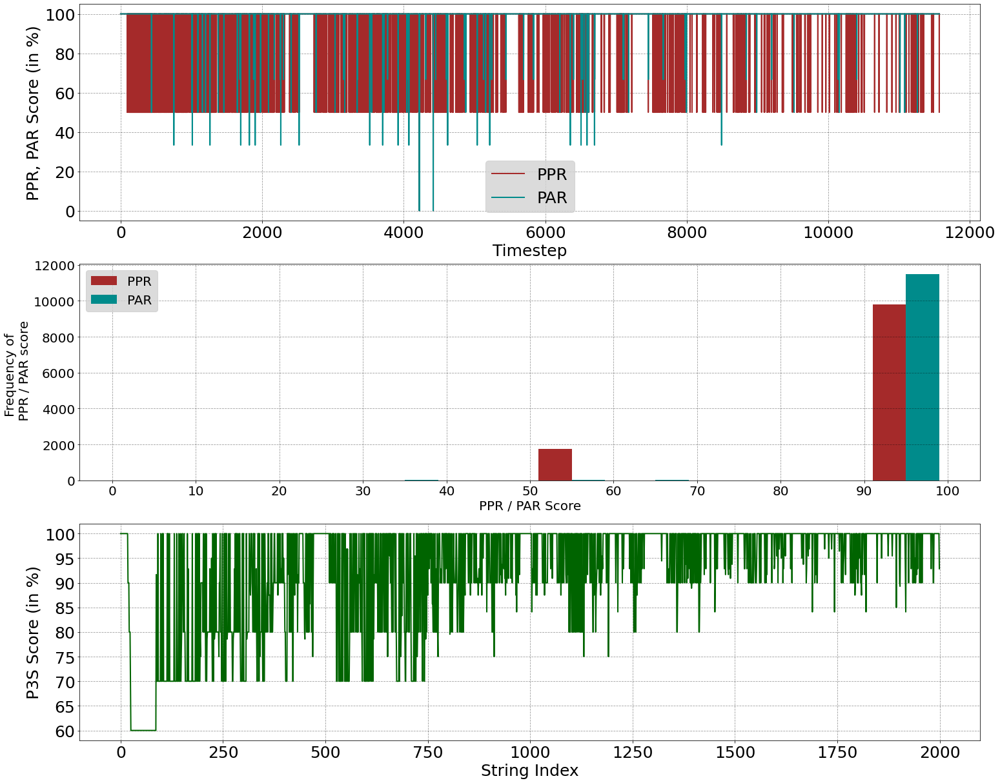

/home/thabib/htm_sequence_learning/htm_sequence_learning/metrics.py:173: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  avg_moving_average_par=avg_moving_average_par,
/home/thabib/htm_sequence_learning/htm_sequence_learning/metrics.py:174: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  sd_moving_average_par=sd_moving_average_par,


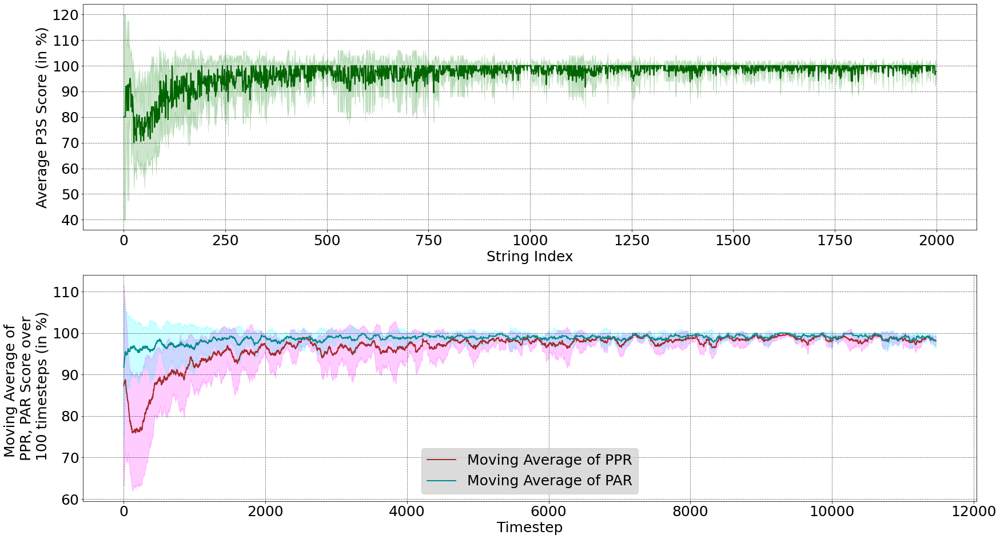

In [ ]:
performance_metrics, performance_metrics_average = compute_network_performance(results_=experiment_results,
                                                                               rg_inputoutput=rg_inputoutput,
                                                                               issue_free=False,
                                                                               compute_averages=True,
                                                                               make_plots=True,
                                                                               save_figures=True,
                                                                               fig_filename=result_filename)

# Previous

In [1]:
import os
import sys
# sys.path.append('/home/thabib/Documents/Personal/Master_Thesis/1_HTMImplementation/ufuncs.py')

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

import time
import random
import collections

from rebergrammar_generator_v3 import *
from experimentor_v4 import Experimentor
#from ufuncs import full_pickle, unpickle, compress_pickle, decompress_pickle, get_idx_nonZeroElements

os.getcwd()
# np.set_printoptions(threshold=sys.maxsize)
#-----------------------------------------------------------------------------------------------

# Network params
k = 32
N = k*7 # 7 is the number of letters in the reber grammar.
M = 16

# Cell params
maxDendritesPerCell = 128 # with 64, the max. number of synapses were restricted to 25 and max. dendrites were 6.
maxSynapsesPerDendrite = 49 # (=32 + (18-1))
nmdaThreshold = 18
permThreshold = 0.50
learningThreshold = 11
permInit = 0.25
permInit_sd = 0.002

perm_decrement = 0.1 # p-
perm_increment = 2*perm_decrement # p+
perm_decay = 0.20*perm_decrement # p--

verbose = 1
trial = 'trial_1_' 

# Generate Reber Strings For HTM Learning

In [14]:
# TO BE USED WHEN ONLY STRINGS ARE SPECIFICALLY SELECTED

# Keys are input strings. 
# Values are lists of expected output chars after each input char of the string.
# reber_strings = {
#     'ATSPVZ': [('T','P'), ('S','P'), ('P'), ('V'), ('Z')],
#     'APSTTXZ': [('T','P'), ('S','V'), ('T'), ('T'), ('X'), ('Z')],
#     'APVPVZ': [('T','P'), ('S','V'), ('P'), ('V'), ('Z')],
#     'ATPXSXZ': [('T','P'), ('S','P'), ('X'), ('S'), ('X'), ('Z')]
# }

# reber_strings = {
#     'APVPVZ': [('P'), ('V'), ('P'), ('V'), ('Z')]
# }

In [6]:
# Task params
graph = '2' # '2' is the graph used in the study

rg = Reber_Grammar(numColumns=N, columnsPerChar=k, graph=graph)
charsMC = rg.df_CharsToMinicols

do_ERG = False
nof_strings = 5000

reber_strings = 'mixed'

string_max_length = None
sort_by_length = False

# Generating Input Strings and Predictions
rg_inputoutput = rg.generate_RGInputOutput(do_ERG, nof_strings, reber_strings, string_max_length, sort_by_length)

### Input String Statistics

A total of 5000 strings were generated. 

With: 
NOF characters in total = 40070. 
Mean length of string = 8.014. 
Median length of string = 7.0. 

 Unique Strings = ['APSTTTTTTTTXZ' 'APSTTTTTTTXZ' 'APSTTTTTTXZ' 'APSTTTTTXZ' 'APSTTTTXZ'
 'APSTTTXZ' 'APSTTXZ' 'APSTXZ' 'APSXZ' 'APVPVZ' 'APVPXSTTTTTTTXZ'
 'APVPXSTTTTXZ' 'APVPXSTTTXZ' 'APVPXSTTXZ' 'APVPXSTXZ' 'APVPXSXZ'
 'APVPXVPVZ' 'APVPXVPXSTTTTTTXZ' 'APVPXVPXSTTTTTXZ' 'APVPXVPXSTTTTXZ'
 'APVPXVPXSTTTXZ' 'APVPXVPXSTTXZ' 'APVPXVPXSTXZ' 'APVPXVPXSXZ'
 'APVPXVPXVPVZ' 'APVPXVPXVPXSTXZ' 'APVPXVPXVPXSXZ' 'APVPXVPXVPXVSSPXSXZ'
 'APVPXVPXVPXVSSSSPVZ' 'APVPXVPXVSPVZ' 'APVPXVPXVSPXSTXZ'
 'APVPXVPXVSPXSXZ' 'APVPXVPXVSPXVPXVPXVSSSSPVZ' 'APVPXVPXVSPXVSSPVZ'
 'APVPXVPXVSSPVZ' 'APVPXVPXVSSPXSXZ' 'APVPXVPXVSSPXVSPXVPXSXZ'
 'APVPXVSPVZ' 'APVPXVSPXSTTTTTXZ' 'APVPXVSPXSTTXZ' 'APVPXVSPXSTXZ'
 'APVPXVSPXSXZ' 'APVPXVSPXVPVZ' 'APVPXVSPXVSPVZ'
 'APVPXVSPXVSPXVSPXVPXVSSSPXVPXVPXSXZ' 'APVPXVSPXVSSPVZ'
 'APVPXVSPXVSSPXSXZ' 'APVPXVSSPVZ' 'APVPXVSSPXSTTXZ' 'APVPXVSS

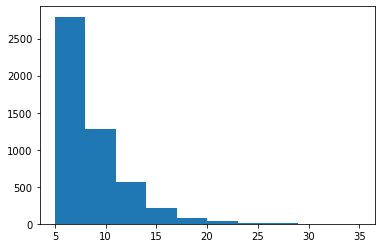

0 ATPXSXZ
1 ATPXVSSSPVZ
2 APVSPXVPXSTTXZ
3 ATSSSPVZ
4 ATPXVSPVZ
5 ATSPXSXZ
6 ATSPXVPVZ
7 APSXZ
8 ATPVZ
9 ATPVZ
10 APVSPVZ
11 ATSPXSXZ
12 APSXZ
13 ATSPXVPXVPVZ
14 ATSPVZ
15 APSTXZ
16 APVSPXVSPVZ
17 ATSPVZ
18 APSTXZ
19 ATSSPXVSPXVPVZ
20 ATPVZ
21 ATPVZ
22 APVPVZ
23 ATSSSSPXVSSPVZ
24 APSXZ
25 APSTTTTTTXZ
26 APSTTTTXZ
27 APSXZ
28 APVSSPVZ
29 APVSSSPVZ
30 APSXZ
31 ATPXSXZ
32 APSTTXZ
33 APSTTXZ
34 APVSPXSXZ
35 APSTTXZ
36 APSTTXZ
37 ATPVZ
38 APVPVZ
39 APVSSSSSPXVPXSXZ
40 APVSSSPXVPXVPXSXZ
41 APSTXZ
42 APSTXZ
43 ATPVZ
44 APSXZ
45 APVPXVSPVZ
46 APVPXVPXVSPVZ
47 APVSPVZ
48 APVPXSTTXZ
49 ATSPVZ
50 ATSSPVZ
51 ATPVZ
52 ATSSPXVPVZ
53 APSTTTXZ
54 APSXZ
55 APSTXZ
56 ATSPXSXZ
57 ATSPVZ
58 ATPVZ
59 APSTXZ
60 ATPXSTXZ
61 APSTTTXZ
62 APVPXVSPXSTTXZ
63 ATPVZ
64 ATSPXSTTTTXZ
65 ATPVZ
66 ATSPVZ
67 APVSSPXVSPVZ
68 APSTTXZ
69 ATPXVSPXSXZ
70 ATPVZ
71 APVPXVPXVSPXVSSPVZ
72 ATPVZ
73 APVSSSPXVSSPXVSSPXSTTXZ
74 APSXZ
75 APVSPVZ
76 APVSSPXVPVZ
77 ATPVZ
78 APVPXSXZ
79 ATPVZ
80 ATSPVZ
81 APSXZ
82 APVPXSXZ
83 APVPVZ
84 

714 APVSSPVZ
715 APVPVZ
716 APSXZ
717 ATSPXSXZ
718 ATPXSXZ
719 ATPXVPXSTTXZ
720 ATSSPXSTXZ
721 APVPXSTXZ
722 ATSSPXVSPXSXZ
723 ATPXVPVZ
724 APVPVZ
725 APSTTXZ
726 ATSPXVSPXSXZ
727 ATSSPXSTTXZ
728 APSXZ
729 ATSSPVZ
730 APVSSPXVSPVZ
731 ATSPVZ
732 ATPVZ
733 ATSSSSSSSPXSXZ
734 ATSSSSPXSTXZ
735 APSTXZ
736 ATPVZ
737 APSXZ
738 ATPXVPXSTXZ
739 ATSPVZ
740 APVPXVSSPVZ
741 APVPVZ
742 ATSSPXVSSSPXSXZ
743 APVSPVZ
744 ATPVZ
745 APSXZ
746 APSXZ
747 APVPVZ
748 ATPVZ
749 APVSPXVSSPXVSPVZ
750 ATSPXSTXZ
751 ATSPVZ
752 ATSPXVPXSTXZ
753 APVPXSXZ
754 ATSPVZ
755 ATSSPVZ
756 APSTTTTXZ
757 APSTTXZ
758 APVPVZ
759 ATSSSSSSSSPXVSPXVPVZ
760 APSTXZ
761 APSTTXZ
762 ATSPXSTXZ
763 APSTXZ
764 APSXZ
765 APVPXSXZ
766 APVSPXSTTTXZ
767 ATSPXSXZ
768 ATPVZ
769 APVPXSTTXZ
770 APSTXZ
771 ATSSSSPXSTTXZ
772 ATSPXSXZ
773 APSXZ
774 APSXZ
775 APVPVZ
776 APVPXSXZ
777 APSTTXZ
778 ATPXVPXVSSSPXSTTXZ
779 APSXZ
780 ATSSPXSTXZ
781 APSXZ
782 APSXZ
783 ATSPVZ
784 ATSSSSPVZ
785 APSXZ
786 APVPVZ
787 ATSSSSSPVZ
788 APVPXSTXZ
789 ATPVZ
790 AT

1601 ATPVZ
1602 ATSPVZ
1603 APSXZ
1604 APVPXVSPXVSSPVZ
1605 APVPXSTTTXZ
1606 ATSSPXVPXVSSSSPXSTXZ
1607 ATSSPVZ
1608 APVSSSPVZ
1609 APSTXZ
1610 ATPXVSSPVZ
1611 ATPVZ
1612 ATPXSTXZ
1613 APVPXVSPXSXZ
1614 APSTXZ
1615 ATPXVSSSSPXVSSPVZ
1616 ATSPVZ
1617 APVSPXVPVZ
1618 APVSPXVSSPVZ
1619 APSXZ
1620 ATSSSPVZ
1621 ATSPXSTXZ
1622 ATSSPVZ
1623 APSTTXZ
1624 ATSSSSPXVSPXSTXZ
1625 APVPXVPXSXZ
1626 ATPXSXZ
1627 APSTTXZ
1628 APVPXVSPVZ
1629 APVSPXSTTXZ
1630 ATSSSPXSXZ
1631 APSTTTXZ
1632 ATPVZ
1633 ATPVZ
1634 ATSSPVZ
1635 ATSPVZ
1636 APVPVZ
1637 ATSPVZ
1638 ATPVZ
1639 APVPXSXZ
1640 ATSSSSPXSTXZ
1641 ATPVZ
1642 APSXZ
1643 ATPXVPXVPXSTXZ
1644 ATPXVSPXVPVZ
1645 APSTXZ
1646 APVSPXSXZ
1647 APVPVZ
1648 ATSPXVSPVZ
1649 ATSSSPXSXZ
1650 ATPXVSSPVZ
1651 ATSPXSXZ
1652 APVSPVZ
1653 APVSSPVZ
1654 APVPVZ
1655 APVPXVPVZ
1656 APVPXVSSSSPVZ
1657 APVPVZ
1658 APVSSSPXVPVZ
1659 APVPVZ
1660 APVPVZ
1661 ATSSPXSTXZ
1662 ATPVZ
1663 APSTXZ
1664 ATPXSXZ
1665 ATPXVSSPXVSSPXSXZ
1666 ATPVZ
1667 APVPXVPVZ
1668 APSTXZ
1669 ATSPXVPV

2314 ATPXSXZ
2315 ATSPVZ
2316 APVSSPXVPVZ
2317 ATPXVSSPXVPXVSSSSPVZ
2318 ATPVZ
2319 APSTTTXZ
2320 ATSPVZ
2321 ATSSSSPVZ
2322 APSXZ
2323 APVPVZ
2324 APSXZ
2325 APVPVZ
2326 ATSSSSPXSTTTXZ
2327 ATSPXVPVZ
2328 APSXZ
2329 ATPVZ
2330 APSTTTTXZ
2331 APVPVZ
2332 ATSSPXSTTXZ
2333 ATPXSTXZ
2334 ATPVZ
2335 ATPXSTTTTXZ
2336 APSTXZ
2337 APSTTXZ
2338 APSTTTXZ
2339 APVSSSSPVZ
2340 APVPXSTXZ
2341 ATSSPXVSSPXVPXVSPVZ
2342 ATPVZ
2343 ATPXSXZ
2344 ATPXVSPVZ
2345 ATPXSXZ
2346 APSXZ
2347 APSXZ
2348 ATPXVSPVZ
2349 ATPVZ
2350 ATSPXSTTTTTXZ
2351 APVSPVZ
2352 APSXZ
2353 APSXZ
2354 APSXZ
2355 ATPXVPVZ
2356 ATSSSSPXVPXVPVZ
2357 ATSSPVZ
2358 ATSPVZ
2359 APSTXZ
2360 ATPVZ
2361 APSTXZ
2362 APVPVZ
2363 APSXZ
2364 APVPVZ
2365 APVPVZ
2366 ATPVZ
2367 ATSSSSPXVSSSSPXVPVZ
2368 APSTTXZ
2369 APSXZ
2370 ATSPXVPVZ
2371 APVSSPVZ
2372 APVSSSPVZ
2373 ATSPVZ
2374 APVSSSSPXSTTTTXZ
2375 APVPVZ
2376 ATPVZ
2377 ATSSPVZ
2378 ATPXVSPXSTXZ
2379 ATSPVZ
2380 ATSPXSXZ
2381 ATSSSPXSXZ
2382 APSTTXZ
2383 ATPXSTXZ
2384 APVPVZ
2385 ATSPVZ
2386

3073 ATPVZ
3074 ATSPXSTTTTTXZ
3075 APVSSSPVZ
3076 ATSPVZ
3077 APVPXSXZ
3078 ATSPVZ
3079 ATSPXVPVZ
3080 ATPVZ
3081 ATSPVZ
3082 ATPXSTTTTXZ
3083 APVSSSSSPVZ
3084 APVSSSSPVZ
3085 ATPVZ
3086 ATPXSTTXZ
3087 ATPXSTXZ
3088 APSTTTTTTXZ
3089 ATPXVPXSXZ
3090 ATSSPVZ
3091 ATSSSSPVZ
3092 APVSSSSPVZ
3093 ATSSPXVSSPXSXZ
3094 APVSSSPVZ
3095 APVPVZ
3096 ATPXSXZ
3097 APVPXSXZ
3098 ATSPVZ
3099 ATPVZ
3100 ATPXVSSPVZ
3101 ATSPVZ
3102 APVSSSPXVSSSSSPVZ
3103 ATSSSSSSSPVZ
3104 APVSSSSSPVZ
3105 APVSSSPVZ
3106 APSTXZ
3107 APSTTTTXZ
3108 APVSPXSTTXZ
3109 ATSPXVPXVPXVPXVPVZ
3110 ATSSPVZ
3111 APSTTTTTTTXZ
3112 ATPXVPVZ
3113 ATSSPXSTTTXZ
3114 ATSSPVZ
3115 APVPVZ
3116 APSTTXZ
3117 APSXZ
3118 APVSSSPXSTXZ
3119 APSXZ
3120 APSXZ
3121 ATSSSSSPXVPVZ
3122 APVPVZ
3123 APSTTXZ
3124 ATPXVPVZ
3125 APSXZ
3126 ATSPVZ
3127 APSTXZ
3128 APSTXZ
3129 APSTTTXZ
3130 APVSPVZ
3131 APSTTXZ
3132 ATSPXSTXZ
3133 APSXZ
3134 APVSPVZ
3135 APSXZ
3136 APSTXZ
3137 APVPXSXZ
3138 APVPXVPXVPXSTXZ
3139 ATPVZ
3140 ATSSPXVPXSTXZ
3141 ATPVZ
3142 APVPXS

3827 APSTXZ
3828 APVSPXSTTTXZ
3829 APVSSPVZ
3830 APVSPXVPXVSPVZ
3831 APSTTTTTXZ
3832 ATSSPVZ
3833 APSTXZ
3834 APSTXZ
3835 ATPVZ
3836 ATSSSSPXVPVZ
3837 ATPXVPXVPXSTXZ
3838 ATPXVPVZ
3839 ATSSSPXSXZ
3840 ATPVZ
3841 ATPXVPVZ
3842 APSTTXZ
3843 APSTTTXZ
3844 ATSSSSSSSPXVPXVSPXVPVZ
3845 ATSSPVZ
3846 ATSSSPXVSSPVZ
3847 ATSPVZ
3848 ATPVZ
3849 ATPVZ
3850 APSTXZ
3851 ATSPVZ
3852 ATSSSSSPXVPXVPVZ
3853 ATSPVZ
3854 ATSSPVZ
3855 APSXZ
3856 APVSPVZ
3857 ATPXVPXSTTTXZ
3858 ATSPXVSPXSTTXZ
3859 APVPVZ
3860 ATPXSXZ
3861 ATSPVZ
3862 APVPVZ
3863 ATPXSTTXZ
3864 ATSSSSPVZ
3865 APSTTXZ
3866 ATSSPVZ
3867 APSTXZ
3868 APVPXVPVZ
3869 ATSPVZ
3870 APSTTXZ
3871 APSTTXZ
3872 APSTTTTXZ
3873 ATPVZ
3874 ATPVZ
3875 APSTXZ
3876 APSXZ
3877 APVSSSSPVZ
3878 APVPXSXZ
3879 APSXZ
3880 ATSPVZ
3881 ATSSSPXVPVZ
3882 APVSSSSSSPXSTTXZ
3883 APSTXZ
3884 APVSPXSXZ
3885 APSTTXZ
3886 ATSSSSPXSTTXZ
3887 APVSSSSSPXSXZ
3888 ATSSSPXVSPVZ
3889 ATPVZ
3890 ATSPXSTTXZ
3891 ATSPXSTTXZ
3892 ATPVZ
3893 ATSPVZ
3894 APVSSPVZ
3895 ATPXSXZ
3896 ATPXSXZ


4573 APSXZ
4574 ATSPXSTTTTXZ
4575 ATSSPVZ
4576 ATPVZ
4577 ATSSPXSTTXZ
4578 ATPXSTXZ
4579 APSTTXZ
4580 APSXZ
4581 ATPXSXZ
4582 ATPXVSPVZ
4583 APSXZ
4584 ATSSPVZ
4585 ATSPXVPVZ
4586 ATPVZ
4587 ATSPXSTTTTXZ
4588 ATPXSTXZ
4589 APSXZ
4590 ATPVZ
4591 APSTTXZ
4592 APSXZ
4593 APVPVZ
4594 APSXZ
4595 APSXZ
4596 ATSSSPXVSPXVSPVZ
4597 APVSPXSTTTTTTXZ
4598 APVSPXSTXZ
4599 ATPVZ
4600 ATPXSTXZ
4601 ATSSPVZ
4602 ATPXSXZ
4603 APVPXSTXZ
4604 APVSSSPXSXZ
4605 ATPXVSPVZ
4606 APVSPVZ
4607 ATSPVZ
4608 APSTXZ
4609 ATSSPVZ
4610 ATPXSTTXZ
4611 ATSPXSXZ
4612 ATPVZ
4613 APSXZ
4614 ATSPVZ
4615 APSTTTTTTTTXZ
4616 APVPVZ
4617 APSTXZ
4618 APSTXZ
4619 ATSPVZ
4620 ATPXVPXVPVZ
4621 ATPXSXZ
4622 ATPVZ
4623 APVPVZ
4624 APSTTTXZ
4625 APVSSPVZ
4626 ATSSPVZ
4627 ATSSPXSTXZ
4628 ATPXSTXZ
4629 APSXZ
4630 ATPVZ
4631 ATSPXVPVZ
4632 ATSPVZ
4633 ATSSPVZ
4634 ATSSSSSSSPVZ
4635 APSXZ
4636 ATSSPXSTXZ
4637 ATPXVPVZ
4638 APVSPVZ
4639 APSXZ
4640 APVSPVZ
4641 APSXZ
4642 APSXZ
4643 ATPXSXZ
4644 APVSSPXVPVZ
4645 APVSPVZ
4646 APVPVZ
4647 A

In [7]:
in_strings_alpha = [rg_inputoutput[i][0] for i in range(len(rg_inputoutput))]
dict_count_allTransitions = rg.count_allTransitions(in_strings_alpha)

# NOF TOTAL CHARACTERS in the input stream
total_len_inputstream = 0
for string in in_strings_alpha:
    total_len_inputstream += len(string)
    
# Plotting HISTOGRAM of REBER STRING's LENGTH
len_rg_exs = []

for ex in in_strings_alpha:
    len_rg_exs.append(len(ex))

print(f'A total of {len(in_strings_alpha)} strings were generated. \n\n\
With: \n\
NOF characters in total = {total_len_inputstream}. \n\
Mean length of string = {np.mean(len_rg_exs)}. \n\
Median length of string = {np.median(len_rg_exs)}. \n\
\n Unique Strings = {np.unique(in_strings_alpha)}. \n\
NOF Unique Strings = {len(np.unique(in_strings_alpha))}.')

plt.figure()
plt.hist(len_rg_exs)
plt.show()
    
# Printing all input reber strings    
for i, string in enumerate(in_strings_alpha):
    print(i, string)

# Generating xticks for plots based on characters-minicols
xticks_plot = np.empty(N, dtype=object)
for ch in chars:
    xticks_plot[charsMC[ch]] = ch

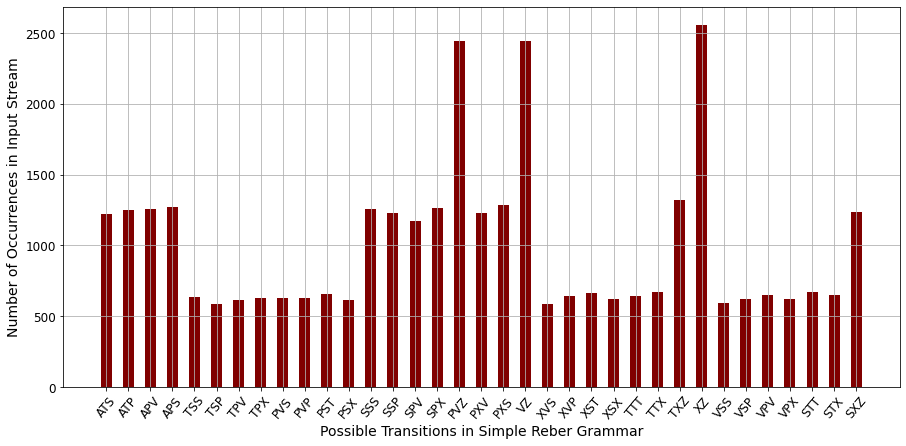

In [9]:
transitions = list(dict_count_allTransitions.keys()) 
counts = list(dict_count_allTransitions.values()) 
   
fig = plt.figure(figsize = (15, 7)) 
  
# creating the bar plot 
plt.bar(transitions, counts, color='maroon' , width = 0.5) 
plt.xlabel('Possible Transitions in Simple Reber Grammar', fontsize=14)
plt.xticks(rotation=50, fontsize=12)
plt.ylabel('Number of Occurrences in Input Stream', fontsize=14) 
plt.yticks(fontsize=12)
#plt.title('NAN')
plt.grid(True)
plt.rc('grid', linestyle="--", color='red', alpha=0.4)
plt.show() 

# Running Experiment

In [5]:
dict_params = {
    'M': M,
    'N': N,
    'k': k,
    'maxDendritesPerCell': maxDendritesPerCell,
    'maxSynapsesPerDendrite': maxSynapsesPerDendrite,
    'nmdaThreshold': nmdaThreshold,
    'permThreshold': permThreshold,
    'learningThreshold': learningThreshold,
    'permInit': permInit,
    'permInit_sd': permInit_sd,
    'perm_decrement': perm_decrement,
    'perm_increment': perm_increment,
    'perm_decay': perm_decay,
    'do_ERG': do_ERG,
    'nof_strings': nof_strings,
    'reber_strings': reber_strings,
    'string_max_length': string_max_length,
    'sort_by_length': sort_by_length,
    'verbose': verbose,
    'trial': trial
}

start = time.time()

exp = Experimentor(cellsPerColumn=M, numColumns=N, columnsPerChar=k, 
                   maxDendritesPerCell=maxDendritesPerCell, maxSynapsesPerDendrite=maxSynapsesPerDendrite, 
                   nmdaThreshold=nmdaThreshold, permThreshold=permThreshold,
                   learningThreshold=learningThreshold,
                   permInit=permInit, permInit_sd = permInit_sd,
                   perm_decrement=perm_decrement, perm_increment=perm_increment, perm_decay=perm_decay,
                   rg=rg, rg_inputoutput=rg_inputoutput,
                   htm_network=None,
                   verbose=verbose)

dict_results = exp.run_experiment()

print(time.time()-start)

# sys.getsizeof(dict_results['results'])

results = dict_results['results']
results.set_index('reber_string', inplace=True)


  String_idx:  0  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 27 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 41 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 44 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 48 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 62 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 72 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 77 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite: 

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 69 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 70 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 73 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 78 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 82 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 84 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 90 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 98 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 111 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 116 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 119 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 143

 MATCH FOUND. Cell { 12 , 177 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 180 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 181 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 212 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  2  for:  S  
 MATCH FOUND. Cell { 15 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Ex

 MATCH FOUND. Cell { 6 , 69 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 70 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 73 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 78 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 82 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 84 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

 MATCH FOUND. Cell { 14 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 44 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 48 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 101 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 131 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 147 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 159 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 160 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 171 }; dendrite:  0 . OverlapScore:  32 . Reinfor

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 30 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 34 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 53 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 58 }; dendrite:  0 . OverlapScore:  32 . Reinforcing 

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 59 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 74 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 75 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 81 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 88 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 106 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 108 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 112 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 117 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 135 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 13

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 64 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 69 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 70 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 73 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 78 } w

 MATCH FOUND. Cell { 0 , 143 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 14 143 } with  32  new synapses. 
 MATCH FOUND. Cell { 12 , 154 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 13 154 } with  32  new synapses. 
 MATCH FOUND. Cell { 15 , 157 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 5 157 } with  32  new synapses. 
 MATCH FOUND. Cell { 5 , 162 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 2 162 } with  32  new syn

 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 13 44 } with  32  new synapses. 
 MATCH FOUND. Cell { 6 , 48 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 10 48 } with  32  new synapses. 
 MATCH FOUND. Cell { 0 , 62 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 15 62 } with  32  new synapses. 
 MATCH FOUND. Cell { 6 , 72 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 8 72 } with  32  new synapses. 
 MATCH FOUND. Cell { 3 , 77 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 173 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 182 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 183 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 197 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 202 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 206 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 207 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 213 } with  32  new synapses. 
  Running for step:  2  for:  S  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 3 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 4 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 9 } with  32  new synapses. 
 NO MATCH FOUND. Grow

 MATCH FOUND. Cell { 6 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 14 2 } with  32  new synapses. 
 MATCH FOUND. Cell { 10 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 6 5 } with  32  new synapses. 
 MATCH FOUND. Cell { 4 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 13 6 } with  32  new synapses. 
 MATCH FOUND. Cell { 10 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 1 25 } with  32  new synapses. 
 MATCH

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 0 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 7 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 16 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 24 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 26 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 30 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 34 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 53 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 58 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 65 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 68 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 97 } with

 MATCH FOUND. Cell { 8 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 42 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syn

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 33 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 39 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 57 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 63 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 67 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 76 }; dendrite:  0 . OverlapScore:  32 . Reinforcing 

 MATCH FOUND. Cell { 9 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

 MATCH FOUND. Cell { 10 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 18 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 19 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 20 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (11, 222) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (12, 52) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (12, 54) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (12, 186) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (13, 9) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (13, 109) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (13, 146) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (14, 144) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (15, 200) } with  32  new synapses.  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 156 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 167 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 177 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 180 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 181 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 212 }; dendrite:  0 . OverlapScore:  32 . Reinf

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 56 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 59 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 74 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 75 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 81 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 88 }; dendrite:  0 . OverlapScore:  32 . Reinforcin

  Running for step:  1  for:  T  
 MATCH FOUND. Cell { 10 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 18 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 19 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 20 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existi

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((6, 0), 32), ((10, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  3 ::::::::::::::::::::::::::::::::::  

  String_idx:  11  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
 MATCH FOUND. Cell { 6 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existin

 MATCH FOUND. Cell { 0 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 42 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Sy

 MATCH FOUND. Cell { 3 , 202 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 206 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 207 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 213 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  2  for:  S  
 MATCH FOUND. Cell { 8 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Exist

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 122 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 125 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 127 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 128 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 129 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 130 }; dendrite:  0 . OverlapScore:  32 . Rei

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((6, 0), 32), ((10, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  3 ::::::::::::::::::::::::::::::::::  

  String_idx:  19  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
 MATCH FOUND. Cell { 6 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existin

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((6, 0), 32), ((10, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  3 ::::::::::::::::::::::::::::::::::  

  String_idx:  21  Input String:  APVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
 MATCH FOUND. Cell { 0 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 23 }; dendrite:  0 . OverlapScore:  32 

 MATCH FOUND. Cell { 6 , 129 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 EXISTING DENDRITE FOUND. Cell { 9 , 129 }; dendrite:  0 . Reinforcing  32  synapses. Existing synapses=  32 
 MATCH FOUND. Cell { 15 , 130 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 EXISTING DENDRITE FOUND. Cell { 7 , 130 }; dendrite:  0 . Reinforcing  32  synapses. Existing synapses=  32 
 MATCH FOUND. Cell { 13 , 133 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 EXISTING DENDRITE FOUND. Cell { 2 , 133 }; dendrite:  0 . Reinforcing  32  synapses. Existing synapses=  32 
 MATCH FOUND. Cell { 7 , 140 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 EXISTING DENDRITE FOUND. Cell {

  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 64 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 69 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 70 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 73 } with  32  new syna

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 162 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 165 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 169 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 187 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 193 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 199 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 203 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 214 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 217 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 223 } with  32  new synapses. 
  Running for step:  6  for: Z  

  String_idx:  24  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  fo

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { 

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 180 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 181 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 212 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  
 MATCH FOUND. Cell { 9 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FO

 MATCH FOUND. Cell { 13 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 42 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Sy

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  10  for: Z  

  String_idx:  28  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
 MATCH FOUND. Cell { 0 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. E

 MATCH FOUND. Cell { 9 , 134 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 137 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 139 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 144 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 146 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 153 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
 MATCH FOUND. Cell { 10 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 44 }; 

  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 64 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 69 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 70 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on

 MATCH FOUND. Cell { 12 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 44 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 48 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 62 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 72 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  n

  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
 MATCH FOUND. Cell { 0 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 42 }; dendrite:  0 . OverlapScore:  32 . Re

 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 12 3 } with  32  new synapses. 
 MATCH FOUND. Cell { 3 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 2 4 } with  32  new synapses. 
 MATCH FOUND. Cell { 8 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 6 9 } with  32  new synapses. 
 MATCH FOUND. Cell { 2 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 11 23 } with  32  new synapses. 
 MATCH FOUND. Cell { 7 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXI

 MATCH FOUND. Cell { 15 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 13 1 } with  32  new synapses. 
 MATCH FOUND. Cell { 4 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 7 21 } with  32  new synapses. 
 MATCH FOUND. Cell { 3 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 0 29 } with  32  new synapses. 
 MATCH FOUND. Cell { 4 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 9 45 } with  32  new synapses. 
 MAT


  String_idx:  36  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
 MATCH FOUND. Cell { 9 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Exist

 MATCH FOUND. Cell { 2 , 175 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 189 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 190 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 198 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 210 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 211 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((5, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  39  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 51 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 64 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 69 }; dendrite:  0 . OverlapScore:  32 . Reinforci


  String_idx:  41  Input String:  ATPXVSSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
 MATCH FOUND. Cell { 0 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Gro


  String_idx:  43  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
 MATCH FOUND. Cell { 13 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Exis

  Running for step:  6  for:  V  
 MATCH FOUND. Cell { 14 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing

 MATCH FOUND. Cell { 5 , 73 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 78 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 82 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 84 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 90 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 98 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new 


  String_idx:  47  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
 MATCH FOUND. Cell { 9 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Exist

 MATCH FOUND. Cell { 15 , 109 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 14 109 } with  32  new synapses. 
 MATCH FOUND. Cell { 7 , 113 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 1 113 } with  32  new synapses. 
 MATCH FOUND. Cell { 1 , 132 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 2 132 } with  32  new synapses. 
 MATCH FOUND. Cell { 10 , 134 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 3 134 } with  32  new syna

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 15 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 30 }; dendrite:  0 . OverlapScore:  32 . R

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 184 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 194 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 195 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 196 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 201 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 205 }; dendrite:  0 . OverlapScore:  32 . Reinfo

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  
 MATCH FOUND. Cell { 15 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 30 }; dendrite:  0 . OverlapScore:  32 . Re

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((5, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  5 ::::::::::::::::::::::::::::::::::  

  String_idx:  53  Input String:  ATSPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
 MATCH FOUND. Cell { 0 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remainin


  String_idx:  54  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  
 MATCH FOUND. Cell { 7 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 26 }; dendrite:  0 . OverlapScore:  3

 MATCH FOUND. Cell { 4 , 74 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 75 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 81 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 88 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 106 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 108 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  n

 MATCH FOUND. Cell { 1 , 216 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 219 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 

  String_idx:  56  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH F

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

 MATCH FOUND. Cell { 11 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

 MATCH FOUND. Cell { 11 , 54 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 61 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 66 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 71 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 104 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 107 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((11, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  60  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
 MATCH FOUND. Cell { 0 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 23 }; dendrite:  0 . OverlapScore:  32 .

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  String_idx:  61  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing

  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  65  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
 MATCH FOUND. Cell { 12 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 23 }; dendrite:  0 . OverlapScore:  32 .

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  12  for: Z  

  String_idx:  67  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 6 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 25 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 47 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 55 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 59 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 74 } with  32  

 MATCH FOUND. Cell { 0 , 221 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  69  Input String:  ATSSSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 27 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 41 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 44 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 48 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 62 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 72 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 77 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  10  for:  P  
 MATCH FOUND. Cell { 8 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 44 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existi

  Running for step:  15  for: Z  

  String_idx:  71  Input String:  ATSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Re

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  9  for:  X  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((13, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  72  Input String:  ATPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
 MATCH FOUND. Cell { 10 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapse

 MATCH FOUND. Cell { 4 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 44 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  77  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
 MATCH FOUND. Cell { 13 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cell

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 200 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 208 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 209 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 218 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 222 } with  32  new synapses. 
  Running for step:  6  for:  X  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((13, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  79  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  80  Input String:  ATPXSXZ
  Runni

  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 28 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 31 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 33 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 39 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 57 } with  32  new s

  Running for step:  13  for: Z  

  String_idx:  82  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  83  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

 MATCH FOUND. Cell { 6 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

  Running for step:  10  for: Z  

  String_idx:  86  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
 MATCH FOUND. Cell { 12 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 3

 MATCH FOUND. Cell { 6 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

 MATCH FOUND. Cell { 5 , 222 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 28 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 31 } with  32  new synapses. 
 N

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  P  
 MATCH FOUND. Cell { 8 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 44 }; 

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  10  :::::::::::::::::::::::::::::::::::::::::::  
[((13, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  16 ::::::::::::::::::::::::::::::::::  

  String_idx:  89  Input String:  ATSPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
 MATCH FOUND. Cell { 13 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  11  for: Z  

  String_idx:  90  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  91  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  92  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
 MATCH FOUND. Cell { 15 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 21 }; dendrite:  0 . OverlapSco

  Running for step:  8  for: Z  

  String_idx:  94  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  95  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  96  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
 MATCH FOUND. Cell { 10 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synaps

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  98  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . Over

 MATCH FOUND. Cell { 15 , 220 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 221 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  10  for:  V  
 MATCH FOUND. Cell { 1 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing


  String_idx:  101  Input String:  APVSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  Running for step:  8  for:  S  
 MATCH FOUND. Cell { 11 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 9 3 } with  22  new synapses. 
 MATCH FOUND. Cell { 9 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 5 4 } with  26  new synapses. 
 MATCH FOUND. Cell { 11 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 15 9 } with  23  new synapses. 
 MATCH FOUND. Cell { 5 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 0 23 

  Running for step:  11  for: Z  

  String_idx:  102  Input String:  ATPXVPXVSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
 MATCH FOUND. Cell { 5 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell

 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 15 137 } with  27  new synapses. 
 MATCH FOUND. Cell { 4 , 139 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 11 139 } with  25  new synapses. 
 MATCH FOUND. Cell { 9 , 144 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 8 144 } with  28  new synapses. 
 MATCH FOUND. Cell { 12 , 146 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 14 146 } with  27  new synapses. 
 MATCH FOUND. Cell { 15 , 153 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (0, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  7  for: Z  

  String_idx:  104  Input String:  ATSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
 MATCH FOUND. Cell { 6 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syn

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 208 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 209 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 218 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 222 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  107  Input String:  APVSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for: 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  10  for:  V  
 MATCH FOUND. Cell { 1 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((13, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  7 ::::::::::::::::::::::::::::::::::  

  String_idx:  109  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  110  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  111  Input String:  ATSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 

 MATCH FOUND. Cell { 11 , 158 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 170 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 186 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 192 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 200 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 208 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  12  for:  X  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((13, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  12 ::::::::::::::::::::::::::::::::::  

  String_idx:  113  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
 MATCH FOUND. Cell { 13 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. 

 MATCH FOUND. Cell { 2 , 157 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 162 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 165 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 169 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 187 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 193 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing 

  Running for step:  7  for: Z  

  String_idx:  116  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . 

  Running for step:  7  for: Z  

  String_idx:  117  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . O


  String_idx:  118  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syn

  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 11 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synap

  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
  Running for step:  12  for:  X  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 64 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 69 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 70 } with  32  new synapses. 
 NO MATCH

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  10  for: Z  

  String_idx:  122  Input String:  ATSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
 MATCH FOUND. Cell { 2 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 211 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 215 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 220 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 221 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  11  for: Z  

  String_idx:  123  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
 

  Running for step:  7  for: Z  

  String_idx:  125  Input String:  APSTTTTTTTTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendr

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  17  for: Z  

  String_idx:  126  Input String:  APVSSPXVSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendri

 MATCH FOUND. Cell { 4 , 210 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 211 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 215 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 220 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 221 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  8  for:  S  
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
  Running for step:  11  f

  Running for step:  15  for:  V  
  Running for step:  16  for: Z  
 MATCH FOUND. Cell { 0 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 30 }; dendrite:  0 . OverlapScore:  32 . 

 MATCH FOUND. Cell { 2 , 192 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 200 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 208 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 209 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 218 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 222 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  


  String_idx:  131  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  132  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  Running for step:  8  for: Z  

  String_idx:  133  Input String:  APVPXVSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 3 } with  32  new synapses. 
 MATCH FOUND. Cell { 13 , 4 }; dendrite:  0 . OverlapScore:  15 . Reinforcing  15  synapses. Existing synapses=  26 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 9 } with  32  new synapses. 
 MATCH FOUND. Cell { 0 , 23 }; dendrite:  0 . OverlapScore:  14 . Reinforcing  14  synapses. Existing synapses=  23 
 MATCH FOUND. Cell { 11 , 32 }; dendrite:  0 . OverlapScore:  14 . Reinforcing  14  synapses. Existing synapses=  26 
 MATCH FOUND. Cell { 14 , 42 }; dendrite:  0 . OverlapScore:  14 . Reinforcing  14  synapses. Existing synapses=  24 
 NO MATCH FOUND. Growing new dendrite:

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  12  for: Z  

  String_idx:  135  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . 


  String_idx:  137  Input String:  ATSSSSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exist

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
 MATCH FOUND. Cell { 11 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 42 }; de

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  139  Input String:  APSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  10  for: Z  

  String_idx:  140  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 .

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  
 MATCH FOUND. Cell { 0 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 30 }; dendrite:  0 . OverlapScore:  32 . Re

 MATCH FOUND. Cell { 2 , 143 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 154 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 157 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 162 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 165 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 169 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 0 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 30 }; dendrite:  0 . OverlapScore:  32 . R

  Running for step:  7  for: Z  

  String_idx:  144  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  145  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 187 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 193 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 199 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 203 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 214 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 217 }; dendrite:  0 . OverlapScore:  32 . Reinf

  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  


  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 198 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 210 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 211 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 215 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 220 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 221 }; dendrite:  0 . OverlapScore:  32 . Reinf

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 198 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 210 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 211 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 215 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 220 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 221 }; dendrite:  0 . OverlapScore:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  18  for: Z  

  String_idx:  154  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  155  Input String:  ATSSPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses: 

 MATCH FOUND. Cell { 0 , 199 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 203 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 214 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 217 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 223 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  T  
  REPETITION / MATCH FOU


  String_idx:  156  Input String:  ATSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing 

 MATCH FOUND. Cell { 9 , 98 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 111 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 116 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 119 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 143 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 154 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
 MATCH FOUND. Cell { 11 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 42 }; den

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  162  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  163  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  164  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATC

  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (1, 134) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (1, 208) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 113) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (3, 3) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (5, 4) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (5, 66) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (5, 71) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (5, 132) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (5, 218) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (6,

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  168  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  169  Input String:  ATSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dend

  Running for step:  10  for: Z  

  String_idx:  170  Input String:  APVSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
 MATCH FOUND. Cell { 6 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 42 }; dendrite:  0 . OverlapScore:  32 . Re

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  172  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  173  Input String:  APVSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 3 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 4 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 9 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 23 } with  32  new syna


  String_idx:  174  Input String:  APVSSSPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . R

  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
 MATCH FOUND. Cell { 12 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 44 }; dendrite:  0 . OverlapScore:  32 .

 MATCH FOUND. Cell { 14 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new 

  Running for step:  6  for: Z  

  String_idx:  178  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
 MATCH FOUND. Cell { 4 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing syna

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  13  for:  V  
  Running for step:  14  for: Z  

  String_idx:  180  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
 MATCH FOUND. Cell { 15 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 18 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner


  String_idx:  181  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
 MATCH FOUND. Cell { 15 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 49 }; dendrite:  0 . OverlapScore: 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 0 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 7 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 16 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 24 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 26 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 30 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 34 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 53 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 58 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 65 } with  

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  9  for: Z  

  String_idx:  191  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  192  Input String:  APVSSSSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendr

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
 MATCH FOUND. Cell { 4 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 42 }; den

  Running for step:  13  for:  V  
  Running for step:  14  for: Z  

  String_idx:  193  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite: 


  String_idx:  195  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  196  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
 MATCH FOUND. Cell { 0 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synaps


  String_idx:  198  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH F


  String_idx:  199  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  200  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MAT


  String_idx:  202  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
 MATCH FOUND. Cell { 10 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 32 }; dendrite:  0 . OverlapSco

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  
 MATCH FOUND. Cell { 5 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synaps

  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  
 MATCH FOUND. Cell { 12 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 30 }; den

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for: Z  

  String_idx:  207  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . 

  Running for step:  8  for: Z  
 MATCH FOUND. Cell { 12 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 30 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing 

 MATCH FOUND. Cell { 0 , 98 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 111 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 116 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 119 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 143 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 154 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0 

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

 MATCH FOUND. Cell { 3 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 44 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new S

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for:  V  
  Running for step:  12  for: Z  

  String_idx:  215  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  216  Input String:  ATPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing 

 MATCH FOUND. Cell { 2 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 51 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new 

  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  
 MATCH FOUND. Cell { 12 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 11 0 } with  32  new synapses. 
 MATCH FOUND. Cell { 14 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 7 7 } with  32  new synapses. 
 MATCH FOUND. Cell { 4 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 5 16 } with  32  new synapses. 
 MATCH FOUND. Cell { 6 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA thresh

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  
 MATCH FOUND. Cell { 12 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  8  for: Z  

  String_idx:  221  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  222  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  
 MATCH FOUND. Cell { 12 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 16 }; dendrite:  0 . OverlapScore:

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for: Z  

  String_idx:  225  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  226  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  
 MATCH FOUND. Cell { 11 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Ex

  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32 

 MATCH FOUND. Cell { 3 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new S

  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 6 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 25 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 47 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 55 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 59 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 74 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 75 } with  32  new synapses. 
 NO MATCH FO


  String_idx:  231  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  232  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  233  Input String:  ATPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
 MATCH FOUND. Cell { 5 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 11 }; dendrite:  0 . Ov

  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  3

  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
 MATCH FOUND. Cell { 3 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 M

  Running for step:  9  for: Z  

  String_idx:  237  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
 MATCH FOUND. Cell { 0 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Ce

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  240  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  241  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  
 MATCH FOUND. Cell { 11 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  ne


  String_idx:  243  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 6 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 25 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 47 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 55 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 59 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for: Z  

  String_idx:  245  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 200 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 208 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 209 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 218 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 222 } with  32  new synapses. 
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  252  Input String:  APVSSSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  R

  Running for step:  8  for:  V  
  Running for step:  9  for:  S  
 MATCH FOUND. Cell { 4 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 42 }; dendrite:  0 . OverlapScore:  32 . Rei

  Running for step:  6  for: Z  

  String_idx:  254  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . O

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 27 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 41 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 44 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 48 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 62 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 72 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 77 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 85 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 93 } wit

  Running for step:  13  for: Z  

  String_idx:  256  Input String:  APVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 28 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on ce

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  P  
 MATCH FOUND. Cell { 9 , 8 }; dendrite:  0 . OverlapScore:  17 . Reinforcing  17  synapses. Existing synapses=  26 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 22 } with  32  new synapses. 
 MATCH FOUND. Cell { 5 , 27 }; dendrite:  0 . OverlapScore:  18 . Reinforcing  18  synapses. Existing synapses=  24 
 MATCH FOUND. Cell { 7 , 41 }; dendrite:  0 . OverlapScore:  15 . Reinforcing  15  synapses. Existing synapses=  24 
 MATCH FOUND. Cell { 9 , 44 }; dendrite:  0 . OverlapScore:  14 . Reinforcing  14  synapses. Existing synapses=  24 
 MATCH FOUND. Cell { 7 , 48 }; dendrite:  0 . OverlapScore:  15 . Reinforcing  15  synapses. Existing synapses=  24 
 MATCH FOUND. Cell { 4 , 62 }; dendrite:  0 . OverlapScore:  18 . Reinforcing  18  synapses. Existing synapses=  25 
 NO MATCH FOUND. Growing 

  Running for step:  6  for: Z  

  String_idx:  262  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  263  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  265  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfor

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  266  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
 MATCH FOUND. Cell { 2 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synap

 MATCH FOUND. Cell { 12 , 157 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 162 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 165 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 169 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 187 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 193 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  11  for: Z  
 MATCH FOUND. Cell { 8 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 30 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing 

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 199 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 203 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 214 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 217 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 223 } with  32  new synapses. 
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  271  Input String:  ATPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
 MATCH FOUND. Cell { 5 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 32 }; dendrite:  0 .

  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  272  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  273  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
 MATCH FOUND. Cell { 1 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell {


  String_idx:  274  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syn


  String_idx:  276  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  277  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  278  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  279  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  282  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
 MATCH FOUND. Cell { 8 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  284  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  285  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  286  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  
 MATCH FOUND. Cell { 8 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapse

  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  290  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  291  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  292  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  293  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for 

  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  3

 MATCH FOUND. Cell { 3 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 44 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new S


  String_idx:  298  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
 MATCH FOUND. Cell { 2 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 

  Running for step:  6  for: Z  

  String_idx:  301  Input String:  ATSPXVSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
 MATCH FOUND. Cell { 3 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (15, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  305  Input String:  APSTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  10  for:  V  
  Running for step:  11  for: Z  

  String_idx:  308  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  310  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite: 

  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  313  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  314  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  315  Input String:  ATSSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exi

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  P  
 MATCH FOUND. Cell { 3 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 

  Running for step:  8  for: Z  

  String_idx:  317  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  318  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  319  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  320  Input String:  ATSSPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETI

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  12  for: Z  
 MATCH FOUND. Cell { 5 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 30 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing 

  Running for step:  10  for:  X  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 64 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 69 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 70 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 73 } with  32  new synapses. 
 NO MATCH FOUND. Growing new 

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  324  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND


  String_idx:  327  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing 

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  328  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapse

  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  X  
 MATCH FOUND. Cell { 8 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 50 }; d


  String_idx:  331  Input String:  ATPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH

  Running for step:  10  for: Z  

  String_idx:  332  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 .

  Running for step:  7  for: Z  

  String_idx:  333  Input String:  APVSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 .

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  337  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  338  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  339  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  340  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for 

  Running for step:  7  for: Z  

  String_idx:  341  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  345  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  346  Input String:  ATSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 190 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 198 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 210 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 211 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 215 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 220 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 221 } with  32  new synapses. 
  Running for step:  10  for: Z  

  String_idx:  347  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 1

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  348  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  349  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  350  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  351  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for 


  String_idx:  354  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  355  Input String:  ATSPXVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
 MATCH FOUND. Cell { 5 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 29 }; dendrite:  0 . Overlap


  String_idx:  357  Input String:  APVPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 64 } with  32  new synaps

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  6  for: Z  

  String_idx:  360  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . O

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
 MATCH FOUND. Cell { 8 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 50 }; dendrite:  0 . OverlapScore:  32 . R

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  10  for: Z  

  String_idx:  364  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  365  Input String:  APVSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
 MATCH FOUND. Cell { 12 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 22 }; dendrite:  0 . Overlap


  String_idx:  367  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  368  Input String:  ATPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MAT

  Running for step:  9  for: Z  

  String_idx:  369  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  370  Input String:  APVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 5 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses.

  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
 MATCH FOUND. Cell { 10 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  

  Running for step:  16  for: Z  

  String_idx:  372  Input String:  APVSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
 MATCH FOUND. Cell { 14 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 18 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 19 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 20 };

 MATCH FOUND. Cell { 5 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Sy

  Running for step:  6  for: Z  

  String_idx:  375  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  376  Input String:  ATSSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exis

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 119 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 143 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 154 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 157 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 162 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 165 }; dendrite:  0 . OverlapScore:  32 . Reinfo

  Running for step:  8  for: Z  

  String_idx:  378  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  379  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (0, 197) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (0, 202) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (1, 160) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (1, 207) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (2, 89) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (2, 101) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (2, 182) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (3, 17) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (3, 131) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell {


  String_idx:  386  Input String:  ATSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  387  Input String:  ATPXVSSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  Running for step:  11  for:  X  
  Running for step:  12  for:  V  
 MATCH FOUND. Cell { 12 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 55 }; dendrite:  0 . OverlapScore:  32 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  394  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  395  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  
 MATCH FOUND. Cell { 10 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syna


  String_idx:  401  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  402  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existin

  Running for step:  7  for: Z  

  String_idx:  403  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . 

  Running for step:  7  for: Z  

  String_idx:  404  Input String:  APSTTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=


  String_idx:  405  Input String:  ATSSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existi

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  X  
  Running for step:  12  for: Z  

  String_idx:  406  Input String:  APVPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
 MATCH FOUND. Cell { 4 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner 

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for: Z  

  String_idx:  412  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
 MATCH FOUND. Cell { 3 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  ne

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  415  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  416  Input String:  APVPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 5 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses.

  Running for step:  10  for: Z  

  String_idx:  418  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 .

  Running for step:  7  for: Z  

  String_idx:  419  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  420  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  423  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  425  Input String:  APVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 4 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 11 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 51 } with  32

  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  428  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for: Z  

  String_idx:  429  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  430  Input String:  APVPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  431  Input String:  ATPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running 

 MATCH FOUND. Cell { 3 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syn

  Running for step:  6  for: Z  

  String_idx:  433  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  434  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . R

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  435  Input String:  APVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 146 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 153 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 158 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 170 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 186 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 192 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 200 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 208 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 209 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 218 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 222 } with  32  new synapses. 
  Running for step:  10  for:  X  
  Running for ste

  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 10 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  447  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  448  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  449  Input String:  APVSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  P  
 MATCH FOUND. Cell { 9 , 8 }; dendrite:  0 . Overl

  Running for step:  7  for: Z  

  String_idx:  451  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  452  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  453  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 


  String_idx:  457  Input String:  ATSSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 10 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syn

  Running for step:  10  for: Z  

  String_idx:  459  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  460  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  461  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  462  Input String:  APVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running 


  String_idx:  464  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  11  for: Z  

  String_idx:  468  Input String:  ATSSPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 .

  Running for step:  11  for:  V  
 MATCH FOUND. Cell { 11 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existi

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (7, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  15  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  REPETITION / MATCH FOUND. Cell { (14, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  20  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=


  String_idx:  471  Input String:  APVPXVSSSSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  472  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  473  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Runnin

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

 MATCH FOUND. Cell { 13 , 98 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 111 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 116 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 119 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 143 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 154 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0

  REPETITION / MATCH FOUND. Cell { (11, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  479  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  480  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  481  Input String:  ATSPXVSSSSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running 

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  482  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforc


  String_idx:  483  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  484  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  485  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  486  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  

  Running for step:  10  for: Z  

  String_idx:  488  Input String:  APVSSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite: 

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  489  Input String:  APVPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 13 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 42 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell {

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  494  Input String:  APVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
 MATCH FOUND. Cell { 2 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 45 }; dendrite:  1 . OverlapScore: 

  Running for step:  10  for: Z  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 0 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 7 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 16 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 24 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 26 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 30 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 34 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 53 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 58 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 65 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 68 } with  32  new synapses. 
 NO MATCH FOUND. Growing new

  Running for step:  7  for: Z  

  String_idx:  498  Input String:  ATSSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . R

 MATCH FOUND. Cell { 11 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (12, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  10  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  502  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . Ov

  Running for step:  7  for: Z  

  String_idx:  503  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . O

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  506  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  507  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  508  Input String:  APVPXVSSPXVPXVSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 

  REPETITION / MATCH FOUND. Cell { (13, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN


  String_idx:  512  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  513  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  514  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  515  Input String:  ATSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  9  for:  P  
  Running for step:  10  for:  V  
  Running for step:  11  for: Z  

  String_idx:  518  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  519  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  520  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 .

  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  522  Input String:  APVSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  P  
 MATCH FOUND. Cell { 9 , 8 }; dendrite:  0 . OverlapScore:  17 . Reinforcing  17  synapses. Existing synapses=  17 
 Growing  15  new Synapses. Remaining Winner Cells:  3 
 MATCH FOUND. Cell { 12 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  526  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  527  Input String:  ATPXVSSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exis

  REPETITION / MATCH FOUND. Cell { (13, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syn

 MATCH FOUND. Cell { 13 , 98 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 111 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 116 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 119 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 143 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 154 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0

 MATCH FOUND. Cell { 3 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syn

 MATCH FOUND. Cell { 5 , 90 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 98 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 111 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 116 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 119 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 143 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  

  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 28 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 31 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 33 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 39 } with  32  new synapses. 
 NO MATCH 


  String_idx:  533  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforci

  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=


  String_idx:  535  Input String:  ATPXVSPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 7 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 3 6 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 25 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 47 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 3 55 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on 

  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . Ove

 MATCH FOUND. Cell { 14 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 30 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new 

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  538  Input String:  ATSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  540  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.


  String_idx:  541  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
 MATCH FOUND. Cell { 4 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 4 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 30 }; dendrite:  0 . OverlapScore:  32 . 

  Running for step:  7  for: Z  

  String_idx:  546  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  547  Input String:  ATPXSTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  550  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  551  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna

  Running for step:  8  for: Z  

  String_idx:  552  Input String:  ATPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 7 6 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 25 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 47 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 55 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cel

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  562  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 0 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 7 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 16 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 24 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 26 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 30 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 34 } with  32  n

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . Overla

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  568  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo


  String_idx:  571  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  572  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  573  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  574  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  

  Running for step:  10  for: Z  

  String_idx:  577  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  578  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  579  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 .

  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  582  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapse


  String_idx:  584  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  585  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  
 MATCH FOUND. Cell { 13 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing 

  Running for step:  6  for:  V  
 MATCH FOUND. Cell { 8 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing sy

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 132 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 134 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 137 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 139 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 144 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 146 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 153 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 158 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 170 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 186 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 192 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell {

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  9  for:  S  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  596  Input String:  APVPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  597  Input String:  APVSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / 


  String_idx:  598  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syn


  String_idx:  600  Input String:  ATSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 9 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 51 } with  32  new synapses. 
 NO MATCH FOUND.

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

 MATCH FOUND. Cell { 7 , 117 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 135 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 138 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 141 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 142 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 161 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  12  for: Z  

  String_idx:  605  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  606  Input String:  ATPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 3 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 4 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 9 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 23 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 32 } 


  String_idx:  608  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  609  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  610  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  611  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running f


  String_idx:  612  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  613  Input String:  ATSPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MAT

  Running for step:  10  for:  V  
  Running for step:  11  for: Z  
 MATCH FOUND. Cell { 4 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 30 }; dendrite:  0 . OverlapScore:  32 .

  Running for step:  7  for: Z  

  String_idx:  615  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  616  Input String:  APVSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  617  Input String:  ATPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU


  String_idx:  618  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforc


  String_idx:  619  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforci

  Running for step:  11  for: Z  

  String_idx:  622  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  623  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  624  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  625  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for 

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  6  for: Z  

  String_idx:  633  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . 

  Running for step:  7  for: Z  

  String_idx:  634  Input String:  APVSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  

  Running for step:  11  for: Z  

  String_idx:  635  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 4 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 30 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existin

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 178 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 184 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 194 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 195 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 196 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 201 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 205 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 216 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 219 } with  32  new synapses. 

  String_idx:  639  Input String:  APVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Runn

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for: Z  

  String_idx:  643  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  644  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATC


  String_idx:  647  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  648  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 0 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 7 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 16 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 24 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 26 } with  32  new synapses. 
 NO MATCH FOUN

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  650  Input String:  APVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 4 51 } with  32  new synapses. 
 NO MATCH FOUND. Gr

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  13  for:  X  
  Running for step:  14  for:  V  
  Running for step:  15  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  15 ::::::::::::::::::::::::::::::::::  

  String_idx:  654  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  655  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  
 MATCH FOUND. Cell { 1 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. 

  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  T  
  Running for step:  13  for:  X  
 MATCH FOUND. Cell { 6 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells: 

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  11  for:  X  
  Running for step:  12  for:  S  
  Running for step:  13  for:  X  
  Running for step:  14  for: Z  
 MATCH FOUND. Cell { 3 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  3

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  12  for:  P  
  Running for step:  13  for:  X  
  Running for step:  14  for:  S  
  Running for step:  15  for:  X  
  Running for step:  16  for: Z  

  String_idx:  664  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Re

  Running for step:  6  for: Z  

  String_idx:  667  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  668  Input String:  ATPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
 MATCH FOUND. Cell { 7 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 124 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 126 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 145 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 151 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 155 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 166 }; dendrite:  0 . OverlapScore:  32 . Reinf

  Running for step:  6  for: Z  

  String_idx:  675  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  676  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  677  Input String:  ATPXVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
 MATCH FOUND. Cell { 7 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Gro

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  8  for: Z  

  String_idx:  679  Input String:  ATSPXVSSSPXVPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  3

  Running for step:  11  for:  V  
 MATCH FOUND. Cell { 8 , 2 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 5 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 6 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 25 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 47 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 55 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing 

  Running for step:  19  for:  P  
  Running for step:  20  for:  V  
  Running for step:  21  for: Z  

  String_idx:  680  Input String:  ATSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATC

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  684  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
 MATCH FOUND. Cell { 13 , 2 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 5 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 6 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 25 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 47 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 55 }; dendrite:  1 . OverlapScore:  32 . Re

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 100 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 103 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 122 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 125 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 127 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 128 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 129 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 130 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 133 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 140 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 149 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell {

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  690  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  691  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1

  Running for step:  8  for: Z  

  String_idx:  692  Input String:  APVPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforci

  Running for step:  10  for: Z  

  String_idx:  693  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  694  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendri

  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
  Running for step:  12  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  119  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  12 ::::::::::::::::::::::::::::::::::  

  String_idx:  696  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  697  Input String:  APVPXVSSPVZ
  Running for step:  0  for

  Running for step:  11  for:  S  
 MATCH FOUND. Cell { 7 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 42 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existi

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  9  for: Z  

  String_idx:  704  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 .

  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  11  for:  V  
  Running for step:  12  for: Z  

  String_idx:  707  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  708  Input String:  ATSPXVPXVSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
 MATCH FOUND. Cell { 12 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining

  Running for step:  16  for: Z  
 MATCH FOUND. Cell { 14 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 30 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existin

  Running for step:  11  for:  X  
  Running for step:  12  for: Z  

  String_idx:  710  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  711  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  712  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MA

  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (10, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN


  String_idx:  717  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH F


  String_idx:  719  Input String:  APVSSPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Re

 MATCH FOUND. Cell { 9 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 44 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 48 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 62 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Sy

  Running for step:  11  for:  V  
  Running for step:  12  for:  P  
  Running for step:  13  for:  X  
  Running for step:  14  for:  V  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((9, 1), 32), ((12, 0), 32), ((12, 1), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  14 ::::::::::::::::::::::::::::::::::  

  String_idx:  722  Input String:  APVSSSSSSPXVSSSSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  3

  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapse

  Running for step:  11  for:  V  
  Running for step:  12  for:  S  
  Running for step:  13  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . Ov

  Running for step:  16  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  

  REPETITION / MATCH FOUND. Cell { (4, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  724  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  725  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  7  for: Z  

  String_idx:  726  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . 

  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  REPETITION / MATCH FOUND. Cell { (13, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (

  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  Running for step:  11  for: Z  

  String_idx:  736  Input String:  APVSPXVPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
 MATCH FOUND. Cell { 10 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  sy

  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  739  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  740  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 

  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  X  
 MATCH FOUND. Cell { 5 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Sy

  Running for step:  10  for:  V  
  Running for step:  11  for:  P  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 27 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 41 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 44 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 48 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 62 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 72 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 77 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 85 } with  32  new syn

  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . Overla

  Running for step:  12  for: Z  

  String_idx:  749  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  753  Input String:  ATPXVSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
 MATCH FOUND. Cell { 7 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Exist

  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  756  Input String:  ATSSSSSPXVSSSSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETIT

  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6 

  REPETITION / MATCH FOUND. Cell { (5, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  19  for:  V  
  Running for step:  20  for:  P  
  Running for step:  21  for:  V  
  Running for step:  22  for: Z  

  String_idx:  757  Input String:  ATPXVSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  S  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 3 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 4 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 3 9 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 1 23 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 32 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on

  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  P  
 MATCH FOUND. Cell { 1 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing 

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
 MATCH FOUND. Cell { 12 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syna

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  


  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  763  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing 

  Running for step:  6  for: Z  

  String_idx:  765  Input String:  ATSSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Re

  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  766  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  767  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . 

  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  768  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 

  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . Overla

  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  771  Input String:  APVSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
 MATCH FOUND. Cell { 7 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 25 };

  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  776  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C


  String_idx:  777  Input String:  ATPXVSSSPXVSSSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION

  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
 MATCH FOUND. Cell { 10 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 23 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 32 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 42 }; dendrite:  1 . OverlapScore:  32 .

  REPETITION / MATCH FOUND. Cell { (0, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 23) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 158) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 9) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 61) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 208) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 23) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 158) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 9) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 61) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 208) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (14, 4) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 222) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 66) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 146) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  18  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 23) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 158) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  REPETITION / MATCH FOUND. Cell { (13, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  779  Input String:  ATPXSXZ
  Running for s

  Running for step:  11  for:  V  
  Running for step:  12  for:  S  
  Running for step:  13  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  119  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  13 ::::::::::::::::::::::::::::::::::  

  String_idx:  781  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  782  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU


  String_idx:  784  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  785  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  11  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses= 

  Running for step:  15  for: Z  

  String_idx:  787  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  788  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  789  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / M


  String_idx:  790  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  791  Input String:  ATPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
 MATCH FOUND. Cell { 12 , 2 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 5 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 6 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synap

  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  796  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  797  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  798  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  799  Input String:  APSTXZ
  Running fo


  String_idx:  802  Input String:  ATSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  3

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (14, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  10  for:  P  
  Running for step:  11  for:  X  
  Running for step:  12  for:  V  
  Running for step:  13  for:  P  
 MATCH FOUND. Cell { 1 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Ex

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  810  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforc

  Running for step:  7  for: Z  

  String_idx:  811  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . Overla

  Running for step:  10  for:  P  
  Running for step:  11  for:  X  
  Running for step:  12  for:  S  
  Running for step:  13  for:  X  
  Running for step:  14  for: Z  

  String_idx:  817  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  818  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  819  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  82

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  6  for: Z  

  String_idx:  829  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  830  Input String:  ATSPXVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MA

  Running for step:  12  for:  X  
  Running for step:  13  for: Z  

  String_idx:  831  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  832  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  833  Input String:  APVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  834  Input String:  ATSPXVSPXVPVZ
  R


  String_idx:  836  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  837  Input String:  APVSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATC

  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  838  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  839  Input String:  ATSSSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; d

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  P  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 27 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 41 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 44 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 48 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 62 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 1 72 } with  32  new synapses. 
 NO MATCH FOUND. Growing ne

  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  845  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  846  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  847  Input String:  APVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for 

  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synap

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  853  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  P  
 MATCH FOUND. Cell { 6 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 22 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Sy

  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  860  Input String:  ATSSPXVSSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / M

  Running for step:  10  for:  X  
  Running for step:  11  for:  V  
  Running for step:  12  for:  S  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 3 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 4 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 9 9 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 23 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 32 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 42 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 46 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 52 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 54 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 61 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  14  for: Z  

  String_idx:  862  Input String:  ATSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfor

  REPETITION / MATCH FOUND. Cell { (4, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  872  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  873  In

  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32 

  REPETITION / MATCH FOUND. Cell { (13, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapB

  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . Overl


  String_idx:  880  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  881  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MAT


  String_idx:  885  Input String:  APVSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  886  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  887  Input String:  APVSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syn

  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  889  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  890  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  891  Input String:  ATSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATC

  Running for step:  9  for: Z  
 MATCH FOUND. Cell { 7 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 26 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 30 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing sy

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  f


  String_idx:  900  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforci

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (15, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  

  Running for step:  10  for: Z  

  String_idx:  907  Input String:  ATSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
 MATCH FOUND. Cell { 5 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 45 }; dendrite:  1 . OverlapScore

  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . Overla

  REPETITION / MATCH FOUND. Cell { (14, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  11  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (13, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN


  String_idx:  915  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  916  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  917  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
 MATCH FOUND. Cell { 4 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Wi

  Running for step:  8  for: Z  

  String_idx:  919  Input String:  ATSSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . R

  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  9  for:  P  
  Running for step:  10  for:  V  
  Running for step:  11  for: Z  

  String_idx:  920  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  923  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  924  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATC

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
 MATCH FOUND. Cell { 10 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 23 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 32 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 42 }; d

 MATCH FOUND. Cell { 5 , 78 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 82 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 84 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 90 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 98 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 111 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  ne

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  934  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . O

  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  935  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  936  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  937  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running fo

  Running for step:  6  for: Z  

  String_idx:  939  Input String:  APVSSSSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite: 

  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  

  Running for step:  10  for:  V  
  Running for step:  11  for:  P  
  Running for step:  12  for:  V  
  Running for step:  13  for: Z  
 MATCH FOUND. Cell { 10 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 26 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:

  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  941  Input String:  ATSSSSSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; 

  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  15  for: Z  

  String_idx:  942  Input String:  ATSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  943  Input String:  APSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . 

  REPETITION / MATCH FOUND. Cell { (3, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell


  String_idx:  946  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  947  Input String:  ATSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION 

  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  T  
 MATCH FOUND. Cell { 6 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 18 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Exist

  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  950  Input String:  APVSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MAT


  String_idx:  951  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  952  Input String:  ATSPXVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / M

  Running for step:  13  for: Z  

  String_idx:  953  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  954  Input String:  ATSSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  3

  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses= 

  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
 MATCH FOUND. Cell { 10 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 23 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 32 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 42 }; dendrite:  1 . OverlapScore:  32 . 

  REPETITION / MATCH FOUND. Cell { (12, 132) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 134) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 32) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 170) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 218) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 4) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (14, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses

  Running for step:  14  for: Z  

  String_idx:  958  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 9 0 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 7 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 16 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 24 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 26 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 30 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 34 } with  32  new synapses. 
 NO MATCH FOUND. Gro

  Running for step:  7  for: Z  

  String_idx:  960  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . O

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  963  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  964  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  965  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH

  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  967  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  968  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  969  Input String:  APVSSSSSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. E

  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
  Running for step:  12  for:  P  
  Running for step:  13  for:  X  
 MATCH FOUND. Cell { 7 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new 

  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  972  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  973  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  974  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATC

  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  979  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  980  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  981  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Re

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  984  Input String:  ATSSPVZ
  Running for ste

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for: Z  

  String_idx:  987  Input String:  APVSPXVSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:

  REPETITION / MATCH FOUND. Cell { (15, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  10  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses= 


  String_idx:  988  Input String:  ATSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synap

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  993  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  994  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  


  String_idx:  995  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  996  Input String:  ATSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exis

  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  997  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcin

  Running for step:  8  for: Z  

  String_idx:  998  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . O

  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  syn

  REPETITION / MATCH FOUND. Cell { (11, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1005  Input String:  APVSSPXSTTTXZ
  Running 

  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  1011  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite

  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1013  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  

  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6 

  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
 MATCH FOUND. Cell { 10 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 50 }; 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6 

  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1024  Input String:  ATSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 0 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells: 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  14  for: Z  

  String_idx:  1026  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1027  Input String:  ATSSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  X  
  Running for step:  12  for: Z  

  String_idx:  1028  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1029  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1030  Input String:  APVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; d

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1032  Input String:  ATSSSSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . 

  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  S  
  Running for step:  10  f

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (12, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  11  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  T  
  Running for step:  13  for:  X  
  Running for step:  14  for: Z  

  String_idx:  1039  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1040  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . R

  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1041  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for ste

  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1044  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1045  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  
 MATCH FOUND. Cell { 9 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 7 }; dendrite:  1 . OverlapScore: 

  Running for step:  8  for: Z  

  String_idx:  1048  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1049  Input String:  APVSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 9 3 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 4 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 9 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1 

 MATCH FOUND. Cell { 1 , 99 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 110 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 114 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 115 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 120 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 124 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1063  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1064  Input String:  APVSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 1 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses.

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN


  String_idx:  1071  Input String:  ATSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1073  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses

  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 61 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 66 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 71 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 104 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 107 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 109 }; dendrite:  1 . OverlapScore:  32 . Reinforc

  Running for step:  17  for:  S  
  Running for step:  18  for:  X  
  Running for step:  19  for: Z  

  String_idx:  1077  Input String:  ATSSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / M

  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (12, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO


  String_idx:  1085  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1086  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1087  Input String:  APVSSSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses.

  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for: Z  

  String_idx:  1093  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . 

  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1096  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1097  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite

  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  9 


  String_idx:  1099  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1100  Input String:  ATSPXVPXSTTTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
 MATCH FOUND. Cell { 6 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Rema

  REPETITION / MATCH FOUND. Cell { (8, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  REPETITION / MATCH FOUND. Cell { (0, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (13, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  17  for:  X  
  Running for step:  18  for: Z  

  String_idx:  1101  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; den

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  6  for: Z  

  String_idx:  1103  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1104  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1105  Input String:  ATSPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running 

  REPETITION / MATCH FOUND. Cell { (11, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  11  for: Z  

  String_idx:  1108  Input String:  ATPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  REPETITION / MATCH FOUND. Cell { (13, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN


  String_idx:  1111  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1112  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1113  Input String:  ATPXSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETIT

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (13, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND


  String_idx:  1115  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1116  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1117  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1118  Input String:  ATPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  R


  String_idx:  1119  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1120  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / M

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
  Running for step:  12  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . Ov


  String_idx:  1122  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1123  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1124  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exist

  REPETITION / MATCH FOUND. Cell { (7, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for: Z  

  String_idx:  1126  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1127  Input String:  ATSPXVSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
 MATCH FOUND. Cell { 9 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 15 }; dendrite:  0 . Over


  String_idx:  1128  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  Running for step:  6  for: Z  

  String_idx:  1131  Input String:  APVSPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite

  REPETITION / MATCH FOUND. Cell { (9, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1135  Input String:  ATSSSPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dend

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  13  for: Z  

  String_idx:  1136  Input String:  APVSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite: 

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  1138  Input String:  APVSSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  REPETITION / MATCH FOUND. Cell { (7, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

 MATCH FOUND. Cell { 12 , 46 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 52 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 54 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 61 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 66 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 71 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

  REPETITION / MATCH FOUND. Cell { (13, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (5, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  1144  Input String:  ATPXVSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH

  Running for step:  10  for:  S  
  Running for step:  11  for:  X  
 MATCH FOUND. Cell { 9 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 50 }; dendrite:  1 . OverlapScore:  32 . 

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (3, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1147  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1148  Input String:  ATSSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; d

  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  P  
  Running for step:  10  for:  V  
  Running for step:  11  for: Z  

  String_idx:  1149  Input String:  APVSPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:

  Running for step:  12  for:  X  
  Running for step:  13  for: Z  

  String_idx:  1150  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1151  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrit


  String_idx:  1152  Input String:  ATPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
 MATCH FOUND. Cell { 12 , 2 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 5 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 6 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 25 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner

 MATCH FOUND. Cell { 3 , 75 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 81 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 88 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 106 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 108 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 112 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0 

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  8  for: Z  

  String_idx:  1159  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1160  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existi

  Running for step:  6  for: Z  

  String_idx:  1165  Input String:  APVSSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite: 

  Running for step:  12  for: Z  

  String_idx:  1166  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1167  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1168  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  3

  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  8  for: Z  

  String_idx:  1171  Input String:  ATSSSPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 

  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
  Running for step:  12  for:  X  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 7 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 64 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 69 } with  32  new synapses. 
 NO MATCH FOUND. Growing

  REPETITION / MATCH FOUND. Cell { (9, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 28 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 31 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 33 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 39 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  

  REPETITION / MATCH FOUND. Cell { (4, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1178  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1179  Input String:  ATSSSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses: 

  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
 MATCH FOUND. Cell { 12 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
 MATCH FOUND. Cell { 5 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synap

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel


  String_idx:  1185  Input String:  APVSSPXVSSSPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  3

  REPETITION / MATCH FOUND. Cell { (7, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1187  Input String:  ATSSSSSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . 

  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
  Running for step:  12  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . Ove

  Running for step:  6  for: Z  

  String_idx:  1192  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1193  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1194  Input String:  ATSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses.

  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  Running for step:  7  for: Z  

  String_idx:  1197  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1198  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1199  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1200  Input String:  APSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Ru

  REPETITION / MATCH FOUND. Cell { (7, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell


  String_idx:  1201  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1202  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION /

  Running for step:  7  for: Z  

  String_idx:  1206  Input String:  ATSSSSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32

  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (9, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel


  String_idx:  1211  Input String:  ATSSSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exis

  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  X  
 MATCH FOUND. Cell { 1 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existin

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (5, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1218  Input String:  ATPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU


  String_idx:  1219  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1221  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1222  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1223  Input String:  ATSSSPXVSSSSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1

  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (5, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

 MATCH FOUND. Cell { 15 , 74 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 75 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 81 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 88 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 106 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 108 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0 

  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . Overl

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1229  Input String:  ATSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (0, 146) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 3) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 46) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 186) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 71) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 134) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 153) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 192) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (3, 222) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU


  String_idx:  1238  Input String:  ATSSPXVPXVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. 

  REPETITION / MATCH FOUND. Cell { (0, 146) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 3) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 46) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 186) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 134) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 153) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1241  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing

  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
 MATCH FOUND. Cell { 11 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 18 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 19 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 20 }; dendrite:  0 . OverlapScore:  32

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 52 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 54 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 61 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 66 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 71 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 104 }; dendrite:  0 . OverlapScore:  32 . Reinforcin

  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1249  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1250  Input String:  APVPXVPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
 MATCH FOUND. Cell { 9 , 2 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 5 }; dendrite:  1 . Overla

  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
 

  Running for step:  10  for: Z  

  String_idx:  1252  Input String:  APVSPXVSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dend

  REPETITION / MATCH FOUND. Cell { (4, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  15  for:  X  
  Running for step:  16  for: Z  

  String_idx:  1253  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1254  Input String:  APSTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendr

  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1256  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1257  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1258  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1259  Input String:  APVPXVSPXVSPXVS

  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1263  Input String:  ATPXVSPXVSPXVPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  S  
 MATCH FOUND. Cell { 10 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  syn

  REPETITION / MATCH FOUND. Cell { (0, 146) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 3) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 46) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 186) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 134) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 153) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  20  for:  V  
  Running for step:  21  for: Z  

  String_idx:  1264  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1265  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrit

  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1266  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1267  Input String:  APVSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running fo

  Running for step:  9  for:  T  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  192  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  1269  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1270  Input String:  ATSSPXVSSSPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3

  REPETITION / MATCH FOUND. Cell { (4, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
  Running for step:  11  for:  V  
  Running for step:  12  for:  S  
 MATCH FOUND. Cell { 1 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 23 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 32 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Sy

  Running for step:  12  for:  X  
  Running for step:  13  for: Z  

  String_idx:  1275  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrit

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1277  Input String:  ATSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for: Z  

  String_idx:  1287  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1291  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses

  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1294  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1295  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1296  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1297  Input String:  APSTXZ
  Running

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  X  
 MATCH FOUND. Cell { 9 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 50 }; de

  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1308  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH F

  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  10  for:  V  
  Running for step:  11  for: Z  

  String_idx:  1310  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:

  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  8  for: Z  

  String_idx:  1315  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1316  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; de

  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1317  Input String:  ATSSPXVPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / M

  REPETITION / MATCH FOUND. Cell { (0, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel


  String_idx:  1318  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1319  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1320  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:

  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  1324  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1325  Input String:  APVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1326  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel


  String_idx:  1331  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1332  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1333  Input String:  APVSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION 

  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1334  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (4, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1337  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (3, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  1341  Input String:  ATPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
 MATCH FOUND. Cell { 15 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 23 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winne

 MATCH FOUND. Cell { 13 , 33 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 39 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 57 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 63 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 67 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 76 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

  Running for step:  9  for: Z  

  String_idx:  1349  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (6, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1353  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1354  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1355  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1356  Input String:  APVSSPXSXZ
  Ru

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1361  Input String:  APSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  12  for:  V  
  Running for step:  13  for: Z  

  String_idx:  1363  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1364  Input String:  APVPXVPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 1 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrit

  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  13  for:  T  
  Running for step:  14  for:  T  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  160  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  14 ::::::::::::::::::::::::::::::::::  

  String_idx:  1375  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1376  Input String:  APVSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1382  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1383  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1384  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1385  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running fo


  String_idx:  1387  Input String:  ATPXVPXVPXSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
 MATCH FOUND. Cell { 12 , 2 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 5 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 6 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 25 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remainin

  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1390  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH F

  Running for step:  9  for: Z  

  String_idx:  1393  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1394  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existin

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1395  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . 

  Running for step:  10  for: Z  

  String_idx:  1400  Input String:  ATSPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  Running for step:  10  for:  V  
  Running for step:  11  for: Z  

  String_idx:  1401  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  8  for: Z  

  String_idx:  1402  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  14  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  213  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  14 ::::::::::::::::::::::::::::::::::  

  String_idx:  1405  Input String:  ATPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
 MATCH FOUND. Cell { 10 , 8 }; dendrite:  1 . OverlapScore:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  12  for:  S  
  Running for step:  13  for:  T  
 MATCH FOUND. Cell { 11 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 18 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 19 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 20 }; dendrite:  0 . OverlapScore:  3

  Running for step:  16  for: Z  

  String_idx:  1408  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1409  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32


  String_idx:  1411  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1412  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1413  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1414  Input String:  APVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Run

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (6, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND


  String_idx:  1420  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforc

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  14  for:  V  
  Running for step:  15  for: Z  

  String_idx:  1422  Input String:  APVSSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATC

  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . Ov


  String_idx:  1423  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1424  Input String:  APVPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  1425  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETIT


  String_idx:  1426  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1427  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1428  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION


  String_idx:  1429  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1430  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendr

  REPETITION / MATCH FOUND. Cell { (5, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  8  for: Z  

  String_idx:  1432  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for: Z  

  String_idx:  1436  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (7, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  16  for:  T  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  224  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  16 ::::::::::::::::::::::::::::::::::  

  String_idx:  1438  Input String:  ATSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  sy


  String_idx:  1439  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1440  Input String:  ATSSPXVSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETI

  Running for step:  13  for:  V  
  Running for step:  14  for: Z  

  String_idx:  1441  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1442  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1443  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION /

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (3, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  Running for step:  14  for: Z  

  String_idx:  1446  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 .

  REPETITION / MATCH FOUND. Cell { (4, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (6, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  REPETITION / MATCH FOUND. Cell { (12, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 9) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 42) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 61) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 132) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 208) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 209) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  11 

  REPETITION / MATCH FOUND. Cell { (3, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  11  for:  V  
  Running for step:  12  for:  P  
  Running for step:  13  for:  X  
  Running for step:  14  for:  V  
  Running for step:  15  for:  S  
  Running for step:  16  for:  P  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 9 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 27 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 1 41 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 44 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 48 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 62 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 72 } with  32  new synapses. 
 NO MATCH FOUND. Growing


  String_idx:  1461  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1462  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MAT


  String_idx:  1463  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1464  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1465  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1466  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Run

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  Running for step:  10  for: Z  

  String_idx:  1469  Input String:  ATSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 0 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . Overl

  Running for step:  6  for: Z  

  String_idx:  1473  Input String:  APVSPXVSSSSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; den

  REPETITION / MATCH FOUND. Cell { (5, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (6, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

 MATCH FOUND. Cell { 11 , 42 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 46 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 52 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 54 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 61 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 66 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  n

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (3, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel


  String_idx:  1476  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1477  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1478  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1479  Input String:  ATPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Ru


  String_idx:  1480  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1481  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1482  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; de

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  13  for:  P  
  Running for step:  14  for:  V  
  Running for step:  15  for: Z  

  String_idx:  1484  Input String:  APVSSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  REPETITION / MATCH FOUND. Cell { (6, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (2, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  1488  Input String:  ATSSSSSPVZ
  Running for step:  0  for:  A  
  Running f

  REPETITION / MATCH FOUND. Cell { (4, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  9  for: Z  

  String_idx:  1489  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1490  Input String:  APVSPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
 MATCH FOUND. Cell { 9 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  syna

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1494  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1495  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1496  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for 

  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 


  String_idx:  1504  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1505  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1506  Input String:  ATSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 0 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  s

  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1509  Input String:  ATSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1517  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1518  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrit

  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  1525  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcin

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (4, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  8  for: Z  

  String_idx:  1532  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1533  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1534  Input String:  ATSPXVSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Runni

  REPETITION / MATCH FOUND. Cell { (0, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  P  
  Running for step:  11  for:  X  
 MATCH FOUND. Cell { 8 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  

  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
 

  Running for step:  10  for: Z  

  String_idx:  1543  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1544  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existin

  REPETITION / MATCH FOUND. Cell { (14, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
 MATCH FOUND. Cell { 9 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Exis

  Running for step:  14  for: Z  

  String_idx:  1548  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1549  Input String:  ATPXVSSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. E

  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
  Running for step:  12  for:  P  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 4 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 27 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 41 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 9 44 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 48 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 62 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 72 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 77 } with  32  new synapses. 
 NO MA

  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  8  for: Z  

  String_idx:  1552  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1553  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1554  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1555  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETIT

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1556  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite: 

  Running for step:  7  for: Z  

  String_idx:  1557  Input String:  APVSPXVSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrit

  Running for step:  13  for:  V  
  Running for step:  14  for: Z  

  String_idx:  1558  Input String:  ATSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendr

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1559  Input String:  ATPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna


  String_idx:  1560  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1561  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1562  Input String:  APVSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION

  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  1564  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1569  Input String:  ATPXVSSPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite

  REPETITION / MATCH FOUND. Cell { (11, 104) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 132) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 134) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 32) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 170) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 218) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 28 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 31 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 33 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 39 } with  32  new synapses. 
 NO MATCH FO

  REPETITION / MATCH FOUND. Cell { (0, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (0, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  9  for: Z  

  String_idx:  1577  Input String:  ATSSSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 .

  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1581  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
  Running for step:  11  for:  P  
 MATCH FOUND. Cell { 9 , 8 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 22 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 27 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 41 }; dendrite:  1 . OverlapScore:  32 . Re

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1587  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  

  Running for step:  6  for: Z  

  String_idx:  1591  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1592  Input String:  APVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  1593  Input String:  ATSPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Runn

  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1595  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps


  String_idx:  1598  Input String:  ATSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1599  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1600  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendr

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  1604  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1605  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfor


  String_idx:  1606  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  Running for step:  6  for: Z  

  String_idx:  1609  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1610  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1611  Input String:  APSTTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Ex

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for: Z  

  String_idx:  1612  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1613  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1616  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1617  Input String:  ATPXVSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; den

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1623  Input String:  ATSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1624  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . R

  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
  Running for step:  12  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1632  Input String:  APVPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1635  Input String:  ATSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1636  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND


  String_idx:  1637  Input String:  ATSSPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exis

  Running for step:  13  for: Z  

  String_idx:  1638  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1639  Input String:  ATPXVPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
 MATCH FOUND. Cell { 12 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remainin

  REPETITION / MATCH FOUND. Cell { (0, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  13  for: Z  

  String_idx:  1640  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1641  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1642  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  3

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1644  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1645  Input String:  APVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  1649  Input String:  ATSSSSSSSPXVPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  10  for:  X  
  Running for step:  11  for:  V  
  Running for step:  12  for:  P  
  Running for step:  13  for:  X  
  Running for step:  14  for:  V  
  Running for step:  15  for:  P  
 MATCH FOUND. Cell { 6 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 22 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Exist

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1652  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing

  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1656  Input String:  APVPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  1657  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for st

  Running for step:  9  for: Z  

  String_idx:  1661  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1662  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1663  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  


  String_idx:  1667  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1668  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1669  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1670  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Runnin

  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1675  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1676  Input String:  ATPXVSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for:  V  
  Running for step:  12  for: Z  

  String_idx:  1677  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 

  REPETITION / MATCH FOUND. Cell { (12, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapse

  REPETITION / MATCH FOUND. Cell { (5, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  1681  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1682  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1683  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION 

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell


  String_idx:  1686  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1687  Input String:  ATSSSPXVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPET

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 


  String_idx:  1688  Input String:  ATSSSSSSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Ex

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  T  
  Running for step:  13  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1691  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1692  Input String:  APVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1696  Input String:  ATSSPXSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; den

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  14  for: Z  

  String_idx:  1697  Input String:  ATSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . 

  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1702  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  

  Running for step:  8  for: Z  

  String_idx:  1705  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1706  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1708  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1709  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1710  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  17

  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
  Running for step:  12  for:  P  
  Running for step:  13  for:  V  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 1 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 6 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 25 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 3 47 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 55 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 59 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 3 74 } with  32  new synap

  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  11  for: Z  

  String_idx:  1714  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . R

  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1715  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1716  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1717  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; d

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
 MATCH FOUND. Cell { 2 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 23 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 32 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 42 }; dendrite:  1 . OverlapScore:  32 .

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1725  Input String:  ATPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 3 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 4 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 9 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 23 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 32 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 42 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 7 46 } with  32 

  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
  Running for step:  12  for:  X  
 MATCH FOUND. Cell { 0 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  3

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1732  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1733  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite

  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapse

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1735  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  11  for: Z  

  String_idx:  1737  Input String:  APVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  

  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (0, 109) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (0, 186) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 42) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 52) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 54) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 139) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 192) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (3, 4) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (3, 104) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (3

  REPETITION / MATCH FOUND. Cell { (0, 109) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 186) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 42) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 139) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 192) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  16  for:  X  
  Running for step:  17  for:  V  
  Running for step:  18  for:  S  
  Running for step:  19  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  19 ::::::::::::::::::::::::::::::::::  

  String_idx:  1740  Input String:  ATPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  


  Running for step:  11  for: Z  

  String_idx:  1741  Input String:  ATSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1747  Input String:  ATPXVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  X  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 4 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 11 50 } with  32  new synapse

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  10  for:  X  
  Running for step:  11  for:  V  
  Running for step:  12  for:  P  
  Running for step:  13  for:  V  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 6 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 25 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 47 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 55 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 11 59 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 74 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 75 } with  32  new synapses. 
 NO MATC

  REPETITION / MATCH FOUND. Cell { (6, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 222) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  8  for: Z  

  String_idx:  1752  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1753  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1754  Input String:  APVPXSTTTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapse

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  12  for: Z  

  String_idx:  1756  Input String:  APVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1757  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  Running for step:  11  for: Z  

  String_idx:  1759  Input String:  APVPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  S  
 MATCH FOUND. Cell { 6 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 23 }; dendrite:  1 . OverlapScore:

  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32

  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  3

  Running for step:  9  for: Z  

  String_idx:  1762  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1763  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1764  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exist

  REPETITION / MATCH FOUND. Cell { (14, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1768  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
  Running for step:  11  for:  P  
  Running for step:  12  for:  V  
  Running for step:  13  for: Z  

  String_idx:  1774  Input String:  ATPXVSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  REPETITION / MATCH FOUND. Cell { (13, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  

  Running for step:  6  for: Z  

  String_idx:  1776  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1777  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Re

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  11  for:  X  
  Running for step:  12  for:  V  
  Running for step:  13  for:  P  
  Running for step:  14  for:  X  
  Running for step:  15  for:  S  
  Running for step:  16  for:  X  
  Running for step:  17  for: Z  

  String_idx:  1779  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATC

  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  X  
 MATCH FOUND. Cell { 15 , 1 

  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  1783  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1784  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1785  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1786  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existi

  Running for step:  10  for: Z  

  String_idx:  1788  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1789  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1790  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1791  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Runni

  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  14  for: Z  

  String_idx:  1796  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1797  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1798  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION 

  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1804  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synap

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1805  Input String:  APVPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
 MATCH FOUND. Cell { 1 , 8 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 22 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 ,

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1812  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step: 

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 53 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 58 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 65 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 68 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 97 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 99 }; dendrite:  1 . OverlapScore:  32 . Reinforcin

  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  3

  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  P  
  Running for step:  12  for:  X  
  Running for step:  13  for:  S  
  Running for step:  14  for:  X  
  Running for step:  15  for: Z  

  String_idx:  1821  Input String:  ATPXVSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
 MATCH FOUND. Cell { 8 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Win

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  14  for: Z  

  String_idx:  1824  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1825  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1826  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1827  Input String:  ATPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  R

  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1829  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1830  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1831  Input String:  APVPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 5 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1837  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite: 

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1838  Input String:  ATSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite

  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1840  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATC

  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5 

  REPETITION / MATCH FOUND. Cell { (10, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  12  for: Z  

  String_idx:  1843  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1844  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 .

  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1846  Input String:  ATPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 12 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 ,

  Running for step:  6  for: Z  

  String_idx:  1848  Input String:  APVSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1849  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1850  Input String:  APVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing sy

  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  3

  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  14  for:  X  
  Running for step:  15  for:  S  
  Running for step:  16  for:  T  
  Running for step:  17  for:  X  
  Running for step:  18  for: Z  

  String_idx:  1855  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1856  Input String:  ATSSSSSSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  10  for:  X  
  Running for step:  11  for:  V  
  Running for step:  12  for:  P  
  Running for step:  13  for:  V  
  Running for step:  14  for: Z  

  String_idx:  1857  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1858  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1859  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx: 

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32

  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell


  String_idx:  1873  Input String:  APVPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1881  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  3

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1885  Input String:  ATSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1886  Input String:  APVSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  P  
 MATCH FOUND. Cell { 13 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Gr

  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1889  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1890  Input String:  ATSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1891  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  14  for: Z  

  String_idx:  1904  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1905  Input String:  ATSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1906  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  10  for:  T  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  288  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  1909  Input String:  APVPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  sy

  REPETITION / MATCH FOUND. Cell { (10, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  X  
  Running for step:  12  for: Z  

  String_idx:  1912  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1913  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1914  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1915  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Runn

  REPETITION / MATCH FOUND. Cell { (14, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1917  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1918  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1921  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1922  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1923  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; den

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
  Running for step:  11  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  16  for: Z  

  String_idx:  1929  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 .

  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1931  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step

  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
  Running for step:  12  for:  X  
 MATCH FOUND. Cell { 0 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 50 }; 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  11  for: Z  

  String_idx:  1937  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1943  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  Running for step:  11  for: Z  

  String_idx:  1945  Input String:  ATSPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 0 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 9 7 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 1 16 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 7 24 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 11 26 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 11 30 } with  32  new synapse

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1948  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1949  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1950  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  12  for: Z  

  String_idx:  1954  Input String:  ATPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  11  for: Z  

  String_idx:  1956  Input String:  APVSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1957  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1958  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx: 

  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1961  Input String:  APVPXVPXSXZ
  Running fo

  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1964  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1965  Input String:  ATSSSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; den

  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1967  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . 

  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  3

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1982  Input String:  ATSSSSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dend

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
  Running for step:  11  for:  P  
  Running for step:  12  for:  V  
  Running for step:  13  for: Z  

  String_idx:  1983  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1984  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  1988  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1989  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1990  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for ste

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1992  Input String:  ATSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  X  
 MATCH FOUND. Cell { 1 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner C

  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1994  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  

  Running for step:  12  for:  X  
  Running for step:  13  for: Z  

  String_idx:  1996  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1997  Input String:  ATPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
 MATCH FOUND. Cell { 11 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Win

  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2006  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  16  for:  X  
  Running for step:  17  for:  V  
  Running for step:  18  for:  S  
  Running for step:  19  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  19 ::::::::::::::::::::::::::::::::::  

  String_idx:  2011  Input String:  APVPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 5 , 3 }; dend

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  10  for: Z  

  String_idx:  2020  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2021  Input String:  ATSSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {


  String_idx:  2022  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2023  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2024  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2025  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Runni

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2027  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2028  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2029  Input String:  ATSPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  2031  Input String:  APVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  2032  Input String:  APVSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  2033  Input String:  APVPXSTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synap

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  12  for: Z  

  String_idx:  2034  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2036  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2040  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  2046  Input String:  APVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  2047  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syn

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2048  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  2049  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  17  for:  T  
  Running for step:  18  for:  T  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  256  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  18 ::::::::::::::::::::::::::::::::::  

  String_idx:  2051  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2052  Input String:  ATPXSXZ
  Running for step:  0  for: 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  2057  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2058  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2059  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2060  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running 

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2063  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  

  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2066  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2067  Input String:  APVPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite

  Running for step:  10  for: Z  

  String_idx:  2068  Input String:  APVSSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  13  for: Z  

  String_idx:  2069  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 .

  REPETITION / MATCH FOUND. Cell { (13, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (7, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  X  
  Running for step:  12  for: Z  

  String_idx:  2080  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  S  
  Running for step:  10  for:  P  
  Running for step:  11  for:  X  
  Running for step:  12  for:  V  
  Running for step:  13  for:  S  
 MATCH FOUND. Cell { 13 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 23 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 32 }; dendrite:  1 . OverlapScore:  32 .

  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2083  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2084  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for s

  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  2087  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2088  Input String:  ATPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
 MATCH FOUND. Cell { 10 , 8 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining W

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  13  for: Z  

  String_idx:  2092  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2093  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2094  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2095  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  6  for: Z  

  String_idx:  2100  Input String:  ATSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  2101  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2102  Input String:  ATSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 109) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 186) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 42) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 139) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 192) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  16  for:  X  
  Running for step:  17  for:  V  
  Running for step:  18  for:  S  
  Running for step:  19  for:  P  
  Running for step:  20  for:  X  
  Running for step:  21  for:  S  
  Running for step:  22  for:  X  
  Running for step:  23  for: Z  
 MATCH FOUND. Cell { 13 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 26 

  Running for step:  6  for: Z  

  String_idx:  2107  Input String:  APVSSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite: 

  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  S  
  Running for step:  10  for:  P  
  Running for step:  11  for:  V  
  Running for step:  12  for: Z  

  String_idx:  2108  Input String:  ATSSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendri

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2118  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2119  Input String:  ATSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  3

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2122  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for st

  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (13, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  17  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2129  Input String:  ATSPXVSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  12  for:  V  
  Running for step:  13  for: Z  

  String_idx:  2130  Input String:  APVPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  2131  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2132  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running

  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses= 


  String_idx:  2136  Input String:  ATPXVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH


  String_idx:  2137  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2138  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2139  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exi

  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synap

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for:  X  
  Running for step:  12  for:  V  
  Running for step:  13  for:  P  
  Running for step:  14  for:  V  
  Running for step:  15  for: Z  
 MATCH FOUND. Cell { 5 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 26 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new S

  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2147  Input String:  APVPVZ
  Running for ste

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  14  for: Z  

  String_idx:  2152  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2153  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2154  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2155  Input String:  ATSSSSSSSSSSSPVZ
  Running for step:  0  for:  A

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  14  for:  V  
  Running for step:  15  for: Z  

  String_idx:  2156  Input String:  APVSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  P  
 MATCH FOUND. Cell { 13 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winne

  Running for step:  8  for: Z  

  String_idx:  2158  Input String:  APVSPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new

  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2161  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2162  Input String:  APVPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  2163 

  REPETITION / MATCH FOUND. Cell { (2, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel


  String_idx:  2171  Input String:  ATPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
  Running for step:  11  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 23) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 158) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 9) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 61) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 23) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 158) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 9) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 61) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 208) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (12, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  11  for: Z  

  String_idx:  2185  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2186  Input String:  APVSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  2187  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running fo

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  6  for: Z  

  String_idx:  2191  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2192  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Re

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySy

  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  X  
  Running for step:  12  for: Z  

  String_idx:  2199  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2200  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2201  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 


  String_idx:  2203  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2204  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2205  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2206  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Ru

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for: Z  

  String_idx:  2216  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2217  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . 

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  2220  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2221  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2222  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2223  Input String:  APVPXVSPVZ
  Runni

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 


  String_idx:  2226  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2227  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2228  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2229  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Run

  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2234  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2235  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  Running for step:  7  for: Z  

  String_idx:  2236  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2237  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2238  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2239  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  X  
  Running for step:  13  for: Z  

  String_idx:  2242  Input String:  APVSPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
 MATCH FOUND. Cell { 12 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synaps


  String_idx:  2246  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2247  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2248  Input String:  ATPXVSSPXVSSSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  


  REPETITION / MATCH FOUND. Cell { (12, 132) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 134) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 32) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 170) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 218) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 4) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (0, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 23) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 158) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 9) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 61) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 208) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

 MATCH FOUND. Cell { 13 , 8 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 22 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 27 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 41 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 44 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  10  for: Z  

  String_idx:  2254  Input String:  ATSPXVSSSPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32

  Running for step:  10  for:  X  
  Running for step:  11  for:  V  
  Running for step:  12  for:  P  
  Running for step:  13  for:  X  
 MATCH FOUND. Cell { 12 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  14  for: Z  

  String_idx:  2256  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 

  Running for step:  7  for: Z  

  String_idx:  2257  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna

  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapB

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  12  for:  X  
  Running for step:  13  for:  S  
  Running for step:  14  for:  T  
  Running for step:  15  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2263  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2264  Input String:  ATSPXVPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
 MATCH FOUND. Cell { 13 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Gro

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  2267  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2268  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2269  Input String:  APVSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4 

  Running for step:  11  for:  V  
  Running for step:  12  for: Z  

  String_idx:  2274  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2275  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2276  Input String:  ATPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
 MATCH FOUND. Cell { 11 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  

  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  s

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {


  String_idx:  2282  Input String:  APVSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { 

  Running for step:  7  for: Z  

  String_idx:  2285  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  2290  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (0, 32) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (0, 71) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 137) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 222) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 4) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 9) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 107) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 186) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (4, 66) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (5, 

  Running for step:  12  for:  V  
  Running for step:  13  for: Z  

  String_idx:  2293  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  2294  Input String:  APVSSSSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  11  for:  X  
  Running for step:  12  for:  S  
  Running for step:  13  for:  T  
  Running for step:  14  for:  X  
  Running for step:  15  for: Z  

  String_idx:  2295  Input String:  APVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite: 

  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {


  String_idx:  2304  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2305  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2306  Input String:  APVSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exi

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  2307  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2308  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrit

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  2311  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2312  Input String:  ATPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  2313  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  8  for: Z  

  String_idx:  2317  Input String:  ATPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
 MATCH FOUND. Cell { 10 , 8 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 22 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 27 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  2322  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcin

  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
  Running for step:  12  for:  X  
  Running for step:  13  for: Z  
 MATCH FOUND. Cell { 8 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 26 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syn

  Running for step:  12  for:  S  
  Running for step:  13  for:  P  
  Running for step:  14  for:  X  
  Running for step:  15  for:  S  
  Running for step:  16  for:  T  
  Running for step:  17  for:  T  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  17 ::::::::::::::::::::::::::::::::::  

  String_idx:  2326  Input String:  ATSSSSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . O

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  14  for: Z  

  String_idx:  2327  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2328  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  11  for: Z  

  String_idx:  2335  Input String:  ATPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  2336  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendri

  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  12  for:  X  
  Running for step:  13  for:  V  
  Running for step:  14  for:  P  
  Running for step:  15  for:  V  
  Running for step:  16  for: Z  
 MATCH FOUND. Cell { 5 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 26 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new S

  Running for step:  6  for: Z  

  String_idx:  2342  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2345  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  12  for: Z  

  String_idx:  2349  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2350  Input String:  APVPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 5 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0

  Running for step:  6  for: Z  

  String_idx:  2352  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2353  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2354  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses: 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 28 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 31 } with  32  new synapses. 
 NO MATCH 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  8  for: Z  

  String_idx:  2360  Input String:  APSTTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite: 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for: Z  

  String_idx:  2361  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  REPETITION / MATCH FOUND. Cell { (10, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 170) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 


  String_idx:  2363  Input String:  APVSSSSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  11  for:  X  
  Running for step:  12  for:  S  
  Running for step:  13  for:  T  
  Running for step:  14  for:  X  
  Running for step:  15  for: Z  

  String_idx:  2364  Input String:  ATSSPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  3

  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  X  
  Running for step:  13  for: Z  

  String_idx:  2365  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2366  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2367  Input String:  APVSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Runni

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2371  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  14  for: Z  

  String_idx:  2373  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  Running for step:  6  for: Z  

  String_idx:  2379  Input String:  ATPXVSSSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing 

  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
  Running for step:  12  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 23) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 158) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 9) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 61) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  15  for: Z  

  String_idx:  2380  Input String:  APVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  


  String_idx:  2382  Input String:  ATPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  5  for: Z  

  String_idx:  2394  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . 

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for:  V  
  Running for step:  12  for: Z  

  String_idx:  2397  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2398  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2399  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx: 

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
  Running for step:  12  for:  X  
  Running for step:  13  for: Z  
 MATCH FOUND. Cell { 8 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 

  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  2408  Input String:  APVSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  2409  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2410  Input String:  ATPXVSSPXVSSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPET

 MATCH FOUND. Cell { 13 , 8 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 22 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 27 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 41 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 44 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new


  String_idx:  2411  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2412  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  2413  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  Running for step:  12  for:  V  
  Running for step:  13  for: Z  

  String_idx:  2415  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2416  Input String:  ATSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  2417  Input String:  ATSSSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0,

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  12  for: Z  

  String_idx:  2418  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for: Z  

  String_idx:  2420  Input String:  APVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  X  
  Running for step:  12  for: Z  
 MATCH FOUND. Cell { 15 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 26 }; den

  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU


  String_idx:  2428  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2429  Input String:  ATSSSSPXSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPE

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  16  for: Z  

  String_idx:  2430  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2431  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exis

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  2432  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2433  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syn

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  2436  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2437  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2438  Input String:  ATPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running fo

  REPETITION / MATCH FOUND. Cell { (6, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  X  
  Running for step:  12  for: Z  

  String_idx:  2440  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2441  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existin

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2442  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  2443  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2444  Input String:  APVSPXVSSSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Runn

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  2445  Input String:  APVPXVSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 5 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 

  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  2448  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfor

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  8  for: Z  

  String_idx:  2452  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2453  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2456  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2457  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2458  Input String:  APVSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running fo

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  2464  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2465  Input String:  APVSSPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendri

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2476  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2477  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . R

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  17  for: Z  

  String_idx:  2479  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2480  Input String:  ATSSSPXVPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  P  
  Running for step:  12  for:  X  
 MATCH FOUND. Cell { 13 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 49 }; dendrite:  1 . OverlapScore:  32 

  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  2482  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing sy

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  2483  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2484  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2485  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  248

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2489  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for:  X  
  Running for step:  12  for:  S  
  Running for step:  13  for:  X  
  Running for step:  14  for: Z  

  String_idx:  2492  Input String:  ATSSSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exist

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  12  for: Z  

  String_idx:  2493  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2494  Input String:  ATPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 6 } with  32  new synapses. 
 NO MAT

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  
3701.2882952690125


### Multiple Runs 

In [2]:
n_runs = 5
# Task params
graph = '2' # '2' is the graph used in the study

rg = Reber_Grammar(numColumns=N, columnsPerChar=k, graph=graph)
charsMC = rg.df_CharsToMinicols
do_ERG = False
nof_strings = 2000
reber_strings = 'mix'
string_max_length = None
sort_by_length = False

list_rg_inputoutput = []
in_strings_stats = []
list_results = []
list_finalnet = []

for r in range(n_runs):
    #-----------------------------------------------------------------------------------------------------------------
    # Generating Input Strings and Predictions
    rg_inputoutput = rg.generate_RGInputOutput(do_ERG, nof_strings, reber_strings, string_max_length, sort_by_length)
    list_rg_inputoutput.append(rg_inputoutput)
    
    dict_in_strings_stats = {}
    dict_in_strings_stats['in_strings_alpha'] = [rg_inputoutput[i][0] for i in range(len(rg_inputoutput))]
    dict_in_strings_stats['count_allTransitions'] = rg.count_allTransitions(dict_in_strings_stats['in_strings_alpha'])
    
    total_len_inputstream = 0
    for string in dict_in_strings_stats['in_strings_alpha']:
        total_len_inputstream += len(string)
    dict_in_strings_stats['total_len_inputstream'] = total_len_inputstream
    
    len_rg_exs = []
    for ex in dict_in_strings_stats['in_strings_alpha']:
        len_rg_exs.append(len(ex))
    dict_in_strings_stats['len_rg_exs'] = len_rg_exs
    dict_in_strings_stats['mean_median_len_strings'] = (np.mean(len_rg_exs),np.median(len_rg_exs))
    dict_in_strings_stats['nof_unique_strings'] = len(np.unique(dict_in_strings_stats['in_strings_alpha']))
    
    in_strings_stats.append(dict_in_strings_stats)
    #-----------------------------------------------------------------------------------------------------------------
    
    start = time.time()
    exp = Experimentor(cellsPerColumn=M, numColumns=N, columnsPerChar=k, 
                       maxDendritesPerCell=maxDendritesPerCell, maxSynapsesPerDendrite=maxSynapsesPerDendrite, 
                       nmdaThreshold=nmdaThreshold, permThreshold=permThreshold,
                       learningThreshold=learningThreshold,
                       permInit=permInit, permInit_sd = permInit_sd,
                       perm_decrement=perm_decrement, perm_increment=perm_increment, perm_decay=perm_decay,
                       rg=rg, rg_inputoutput=rg_inputoutput,
                       htm_network=None,
                       verbose=verbose)

    dict_results = exp.run_experiment()

    print('\n \033[1m Time for run: ', r, 'is: ', time.time()-start, '\033[0m')

    results = dict_results['results']
    results.set_index('reber_string', inplace=True)
    list_results.append(results)
    list_finalnet.append(dict_results['final_net'])


  String_idx:  0  Input String:  APSTXZ

  String_idx:  1  Input String:  APVSPVZ

  String_idx:  2  Input String:  APSXZ

  String_idx:  3  Input String:  APSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 32), ((2, 0), 32)]

  String_idx:  4  Input String:  APVSSSSPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 32), ((2, 0), 32)]

  String_idx:  5  Input String:  APSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 32), ((2, 0), 32)]

  String_idx:  6  Input String:  ATSSPXVPXVPXSTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((5, 0), 32), ((10, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  8 ::::::::::::::::::::::::::::::::::  

  String_idx:  7  Input String: 


  String_idx:  40  Input String:  APVSSPXVSPXVSSSSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((2, 0), 32), ((5, 0), 32), ((10, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  41  Input String:  ATPVZ

  String_idx:  42  Input String:  APVPVZ

  String_idx:  43  Input String:  ATSSPVZ

  String_idx:  44  Input String:  ATPXVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((1, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  4 ::::::::::::::::::::::::::::::::::  

  String_idx:  45  Input String:  APSXZ

  String_idx:  46  Input String:  APSTXZ

  String_idx:  47  Input String:  ATSSPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((7, 0), 32), ((9, 0), 32)]
  :::::::::::::


  String_idx:  135  Input String:  ATSSSPVZ

  String_idx:  136  Input String:  ATPXSXZ

  String_idx:  137  Input String:  APVSSPXVSSPVZ

  String_idx:  138  Input String:  APVPVZ

  String_idx:  139  Input String:  ATPXSXZ

  String_idx:  140  Input String:  APSXZ

  String_idx:  141  Input String:  APVSSPVZ

  String_idx:  142  Input String:  ATSPXVSPVZ

  String_idx:  143  Input String:  APVSPXSTXZ

  String_idx:  144  Input String:  ATPVZ

  String_idx:  145  Input String:  APSTXZ

  String_idx:  146  Input String:  ATPXVSSPXVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((9, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  147  Input String:  ATSPVZ

  String_idx:  148  Input String:  ATPVZ

  String_idx:  149  Input String:  ATPVZ

  String_idx:  150  Input String:  APVPXVSSSSPVZ

  String_idx:  151  Input String:  APVSSPXV


  String_idx:  241  Input String:  ATSSSPXVPVZ

  String_idx:  242  Input String:  ATSPXVPXVSSPVZ

  String_idx:  243  Input String:  APSTXZ

  String_idx:  244  Input String:  ATSPVZ

  String_idx:  245  Input String:  APSTTTXZ

  String_idx:  246  Input String:  ATSPVZ

  String_idx:  247  Input String:  APSTXZ

  String_idx:  248  Input String:  APSTXZ

  String_idx:  249  Input String:  APVPXSTXZ

  String_idx:  250  Input String:  APVSPXSTTXZ

  String_idx:  251  Input String:  APVSSPVZ

  String_idx:  252  Input String:  ATPXSTTTXZ

  String_idx:  253  Input String:  ATPXSTXZ

  String_idx:  254  Input String:  ATPVZ

  String_idx:  255  Input String:  ATSPVZ

  String_idx:  256  Input String:  APSTTXZ

  String_idx:  257  Input String:  APSXZ

  String_idx:  258  Input String:  APSXZ

  String_idx:  259  Input String:  ATPVZ

  String_idx:  260  Input String:  ATPVZ

  String_idx:  261  Input String:  ATPVZ

  String_idx:  262  Input String:  APSXZ

  String_idx:  263  Input St

  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  374  Input String:  APSXZ

  String_idx:  375  Input String:  APVPVZ

  String_idx:  376  Input String:  APVSPXVPVZ

  String_idx:  377  Input String:  ATSSPXSXZ

  String_idx:  378  Input String:  APVSPXVPVZ

  String_idx:  379  Input String:  ATSPVZ

  String_idx:  380  Input String:  ATSSSSPVZ

  String_idx:  381  Input String:  ATSPXVSSPVZ

  String_idx:  382  Input String:  APVSPVZ

  String_idx:  383  Input String:  APVPXSXZ

  String_i


  String_idx:  460  Input String:  APSXZ

  String_idx:  461  Input String:  ATPXSXZ

  String_idx:  462  Input String:  APSTTTTTXZ

  String_idx:  463  Input String:  ATSPVZ

  String_idx:  464  Input String:  ATPVZ

  String_idx:  465  Input String:  APSXZ

  String_idx:  466  Input String:  ATPXSTTXZ

  String_idx:  467  Input String:  ATSPXSXZ

  String_idx:  468  Input String:  APVPVZ

  String_idx:  469  Input String:  ATSSPXSTTXZ

  String_idx:  470  Input String:  ATSSPVZ

  String_idx:  471  Input String:  APSTTTXZ

  String_idx:  472  Input String:  APSXZ

  String_idx:  473  Input String:  APSXZ

  String_idx:  474  Input String:  ATSPXVSPVZ

  String_idx:  475  Input String:  ATSPVZ

  String_idx:  476  Input String:  APSTXZ

  String_idx:  477  Input String:  APVSSPVZ

  String_idx:  478  Input String:  APVPXSXZ

  String_idx:  479  Input String:  ATSSSPXVSPXVSPXSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::

  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  594  Input String:  APVSPVZ

  String_idx:  595  Input String:  APSXZ

  String_idx:  596  Input String:  APVPXSTXZ

  String_idx:  597  Input String:  ATSPVZ

  String_idx:  598  Input String:  ATSPVZ

  String_idx:  599  Input String:  ATPXSXZ

  String_idx:  600  Input String:  APSXZ

  String_idx:  601  Input String:  APVPXVSSPXSXZ

  String_idx:  602  Input String:  APVPXVSSPXVSSPXVSPXSTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::

  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  128  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  714  Input String:  ATSSPXVSPXVPXSTTTXZ

  String_idx:  715  Input String:  APVSPXSXZ

  String_idx:  716  Input String:  ATPVZ

  String_idx:  717  Input String:  ATPXVPVZ

  String_idx:  718  Input String:  ATPXSTXZ

  String_idx:  719  Input String:  ATSPVZ

  String_idx:  720  Input String:  APSTXZ

  String_idx:  721  Input String:  APSXZ

  String_idx:  722  Input String:  ATPVZ

  String_idx:  723  Input String:  APSTTTXZ

  String_id


  String_idx:  810  Input String:  ATPXSTXZ

  String_idx:  811  Input String:  ATSSPXVPXSTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  160  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  11 ::::::::::::::::::::::::::::::::::  

  String_idx:  812  Input String:  ATPVZ

  String_idx:  813  Input String:  APSXZ

  String_idx:  814  Input String:  APVSPXSTTTXZ

  String_idx:  815  Input String:  ATPVZ

  String_idx:  816  Input String:  APSXZ

  String_idx:  817  Input String:  APSXZ

  String_idx:  818  Input String:  ATSSPVZ

  String_idx:  819  Input String:  APSXZ

  String_idx:  82


  String_idx:  942  Input String:  APVSSPXSXZ

  String_idx:  943  Input String:  ATPVZ

  String_idx:  944  Input String:  APSTXZ

  String_idx:  945  Input String:  ATSSSPVZ

  String_idx:  946  Input String:  ATSSPVZ

  String_idx:  947  Input String:  APVPVZ

  String_idx:  948  Input String:  APVPXSTTXZ

  String_idx:  949  Input String:  ATSSPXVPXSXZ

  String_idx:  950  Input String:  APSXZ

  String_idx:  951  Input String:  APSXZ

  String_idx:  952  Input String:  APVSPVZ

  String_idx:  953  Input String:  ATPXSXZ

  String_idx:  954  Input String:  APVPXVPVZ

  String_idx:  955  Input String:  ATPVZ

  String_idx:  956  Input String:  APVSSPXVPXSXZ

  String_idx:  957  Input String:  ATPXVPXSXZ

  String_idx:  958  Input String:  ATSSSSPXVSSPXSXZ

  String_idx:  959  Input String:  APSTXZ

  String_idx:  960  Input String:  ATSSPVZ

  String_idx:  961  Input String:  ATSSSSPVZ

  String_idx:  962  Input String:  APSXZ

  String_idx:  963  Input String:  APVPXVPXSTXZ

  Str


  String_idx:  1072  Input String:  APSTXZ

  String_idx:  1073  Input String:  ATPVZ

  String_idx:  1074  Input String:  APSTTTTTTXZ

  String_idx:  1075  Input String:  ATPXSTXZ

  String_idx:  1076  Input String:  ATSSPXSTTTXZ

  String_idx:  1077  Input String:  APSTXZ

  String_idx:  1078  Input String:  APSTXZ

  String_idx:  1079  Input String:  ATPVZ

  String_idx:  1080  Input String:  ATPXVSPXVSPXSTTXZ

  String_idx:  1081  Input String:  ATSSSPXVPXVSSSSSSSPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  160  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  12 :::::::::::::::::::


  String_idx:  1188  Input String:  ATSSPVZ

  String_idx:  1189  Input String:  APSXZ

  String_idx:  1190  Input String:  ATPVZ

  String_idx:  1191  Input String:  APVPXVSPVZ

  String_idx:  1192  Input String:  APSTTXZ

  String_idx:  1193  Input String:  ATSSPVZ

  String_idx:  1194  Input String:  APSXZ

  String_idx:  1195  Input String:  ATPXSXZ

  String_idx:  1196  Input String:  APVPVZ

  String_idx:  1197  Input String:  ATSPVZ

  String_idx:  1198  Input String:  APVPVZ

  String_idx:  1199  Input String:  APSTTTXZ

  String_idx:  1200  Input String:  ATSSPVZ

  String_idx:  1201  Input String:  ATSPVZ

  String_idx:  1202  Input String:  APVSPXVSPXSXZ

  String_idx:  1203  Input String:  ATSSPXSTTTXZ

  String_idx:  1204  Input String:  APSTXZ

  String_idx:  1205  Input String:  APSXZ

  String_idx:  1206  Input String:  APVSSPVZ

  String_idx:  1207  Input String:  APVSSPVZ

  String_idx:  1208  Input String:  ATPXVSSSPXSXZ

  String_idx:  1209  Input String:  ATSSPXST


  String_idx:  1330  Input String:  APVPVZ

  String_idx:  1331  Input String:  ATPVZ

  String_idx:  1332  Input String:  ATPXSXZ

  String_idx:  1333  Input String:  ATSPXVSSPVZ

  String_idx:  1334  Input String:  APSTXZ

  String_idx:  1335  Input String:  APSXZ

  String_idx:  1336  Input String:  ATPVZ

  String_idx:  1337  Input String:  ATSPXVSSPXSXZ

  String_idx:  1338  Input String:  APSTXZ

  String_idx:  1339  Input String:  APSTTXZ

  String_idx:  1340  Input String:  ATSSPVZ

  String_idx:  1341  Input String:  APSXZ

  String_idx:  1342  Input String:  ATPVZ

  String_idx:  1343  Input String:  ATSPXSTTTXZ

  String_idx:  1344  Input String:  APSXZ

  String_idx:  1345  Input String:  APVSSSSSSPXSTXZ

  String_idx:  1346  Input String:  ATPXSTXZ

  String_idx:  1347  Input String:  ATSSSSPXSXZ

  String_idx:  1348  Input String:  APSTTTXZ

  String_idx:  1349  Input String:  ATSPXSXZ

  String_idx:  1350  Input String:  APVPXVSPVZ

  String_idx:  1351  Input String:  A


  String_idx:  1459  Input String:  APSTXZ

  String_idx:  1460  Input String:  APVSPXVSSSSPXSXZ

  String_idx:  1461  Input String:  ATSPVZ

  String_idx:  1462  Input String:  ATPVZ

  String_idx:  1463  Input String:  APVSSPVZ

  String_idx:  1464  Input String:  APSXZ

  String_idx:  1465  Input String:  ATPVZ

  String_idx:  1466  Input String:  ATPVZ

  String_idx:  1467  Input String:  ATPXVPXSXZ

  String_idx:  1468  Input String:  ATPVZ

  String_idx:  1469  Input String:  ATSSSPVZ

  String_idx:  1470  Input String:  ATSPXSXZ

  String_idx:  1471  Input String:  APSXZ

  String_idx:  1472  Input String:  APSTTXZ

  String_idx:  1473  Input String:  APSTXZ

  String_idx:  1474  Input String:  ATSPVZ

  String_idx:  1475  Input String:  ATPVZ

  String_idx:  1476  Input String:  APSTTXZ

  String_idx:  1477  Input String:  ATSSSSSSSPVZ

  String_idx:  1478  Input String:  APSXZ

  String_idx:  1479  Input String:  ATPVZ

  String_idx:  1480  Input String:  ATSPVZ

  String_idx


  String_idx:  1576  Input String:  APSTXZ

  String_idx:  1577  Input String:  ATPVZ

  String_idx:  1578  Input String:  ATPVZ

  String_idx:  1579  Input String:  ATSPVZ

  String_idx:  1580  Input String:  ATPVZ

  String_idx:  1581  Input String:  ATSPVZ

  String_idx:  1582  Input String:  APSTXZ

  String_idx:  1583  Input String:  ATSPXSXZ

  String_idx:  1584  Input String:  APVSPVZ

  String_idx:  1585  Input String:  APSTXZ

  String_idx:  1586  Input String:  APVSPVZ

  String_idx:  1587  Input String:  ATSSPXVPXVSSSSSSSSPXVSSPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  :::::


  String_idx:  1693  Input String:  APSTTTXZ

  String_idx:  1694  Input String:  APSXZ

  String_idx:  1695  Input String:  APSXZ

  String_idx:  1696  Input String:  APSXZ

  String_idx:  1697  Input String:  APSTXZ

  String_idx:  1698  Input String:  ATSSPXSTTXZ

  String_idx:  1699  Input String:  APSXZ

  String_idx:  1700  Input String:  APVPVZ

  String_idx:  1701  Input String:  ATSSPXSXZ

  String_idx:  1702  Input String:  ATSSPXSXZ

  String_idx:  1703  Input String:  APSXZ

  String_idx:  1704  Input String:  ATSSSSSSPXVSPXSTTXZ

  String_idx:  1705  Input String:  ATSSPVZ

  String_idx:  1706  Input String:  ATPVZ

  String_idx:  1707  Input String:  ATSSPXVSPXVPVZ

  String_idx:  1708  Input String:  ATPVZ

  String_idx:  1709  Input String:  APVSSPVZ

  String_idx:  1710  Input String:  APVSSSSSPVZ

  String_idx:  1711  Input String:  ATSPVZ

  String_idx:  1712  Input String:  ATPXSXZ

  String_idx:  1713  Input String:  APVSPVZ

  String_idx:  1714  Input String:  AT


  String_idx:  1846  Input String:  APSTXZ

  String_idx:  1847  Input String:  APVSPVZ

  String_idx:  1848  Input String:  ATSSPXSXZ

  String_idx:  1849  Input String:  ATPXVPVZ

  String_idx:  1850  Input String:  ATSPVZ

  String_idx:  1851  Input String:  APVSPXVPXSXZ

  String_idx:  1852  Input String:  ATPVZ

  String_idx:  1853  Input String:  ATPVZ

  String_idx:  1854  Input String:  ATPVZ

  String_idx:  1855  Input String:  ATSSPXVSSSSSPXVSPVZ

  String_idx:  1856  Input String:  APSTTXZ

  String_idx:  1857  Input String:  ATPVZ

  String_idx:  1858  Input String:  APSXZ

  String_idx:  1859  Input String:  ATPVZ

  String_idx:  1860  Input String:  ATSSPXVSPVZ

  String_idx:  1861  Input String:  APVPXSXZ

  String_idx:  1862  Input String:  ATPVZ

  String_idx:  1863  Input String:  APVSSSSPXSTXZ

  String_idx:  1864  Input String:  ATPXVSSSSSSSPXVPXVPVZ

  String_idx:  1865  Input String:  ATSSSPVZ

  String_idx:  1866  Input String:  ATSPXVSSSSSSSSSPXVPVZ

  String_i


  String_idx:  1999  Input String:  APSXZ

  Time for run:  0 is:  3841.0987553596497 

  String_idx:  0  Input String:  APSTXZ

  String_idx:  1  Input String:  APVSPVZ

  String_idx:  2  Input String:  APVPXVSPXVSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((3, 0), 32), ((12, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  2 ::::::::::::::::::::::::::::::::::  

  String_idx:  3  Input String:  ATSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((3, 0), 32), ((12, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  4 ::::::::::::::::::::::::::::::::::  

  String_idx:  4  Input String:  ATPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((3, 0), 32), ((12, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  3 ::::::::::::::::::::::

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((2, 0), 32), ((13, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  4 ::::::::::::::::::::::::::::::::::  

  String_idx:  33  Input String:  APSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((2, 0), 32), ((14, 0), 32)]

  String_idx:  34  Input String:  APSTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((6, 0), 32), ((9, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  35  Input String:  APVPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((10, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx: 


  String_idx:  66  Input String:  APSXZ

  String_idx:  67  Input String:  ATSPVZ

  String_idx:  68  Input String:  ATSPVZ

  String_idx:  69  Input String:  ATPXSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((6, 0), 32), ((9, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  70  Input String:  ATPVZ

  String_idx:  71  Input String:  ATPXSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((6, 0), 32), ((9, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  72  Input String:  APVSPXVPXSXZ

  String_idx:  73  Input String:  APVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((4, 0), 32), ((9, 0), 32), ((10, 0), 32), ((11, 0), 32)]

  String_


  String_idx:  149  Input String:  APSTXZ

  String_idx:  150  Input String:  ATSSPVZ

  String_idx:  151  Input String:  APSTTXZ

  String_idx:  152  Input String:  APSXZ

  String_idx:  153  Input String:  ATSSSSPXVPVZ

  String_idx:  154  Input String:  APSTTXZ

  String_idx:  155  Input String:  ATPVZ

  String_idx:  156  Input String:  ATSPXVSPXVSSSPVZ

  String_idx:  157  Input String:  APVPXSTXZ

  String_idx:  158  Input String:  APSXZ

  String_idx:  159  Input String:  ATPXSXZ

  String_idx:  160  Input String:  APVPVZ

  String_idx:  161  Input String:  APVPVZ

  String_idx:  162  Input String:  ATPXSXZ

  String_idx:  163  Input String:  APSXZ

  String_idx:  164  Input String:  APVSPVZ

  String_idx:  165  Input String:  ATSPVZ

  String_idx:  166  Input String:  APVPVZ

  String_idx:  167  Input String:  APVSSPVZ

  String_idx:  168  Input String:  ATSPXSTTXZ

  String_idx:  169  Input String:  APSTXZ

  String_idx:  170  Input String:  APVPVZ

  String_idx:  171  Input 


  String_idx:  274  Input String:  APSXZ

  String_idx:  275  Input String:  APVPVZ

  String_idx:  276  Input String:  APSXZ

  String_idx:  277  Input String:  APVPXSTXZ

  String_idx:  278  Input String:  APVSPVZ

  String_idx:  279  Input String:  ATSSPXVSPVZ

  String_idx:  280  Input String:  APVPVZ

  String_idx:  281  Input String:  APVSSPVZ

  String_idx:  282  Input String:  ATSPVZ

  String_idx:  283  Input String:  ATSSSSSSSSPXSTTTXZ

  String_idx:  284  Input String:  ATSPXVPXSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 32), ((6, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  285  Input String:  ATSSSPXVSSPVZ

  String_idx:  286  Input String:  APSTXZ

  String_idx:  287  Input String:  ATPVZ

  String_idx:  288  Input String:  APVPVZ

  String_idx:  289  Input String:  APVPVZ

  String_idx:  290  Input String:  APSXZ


  String_idx:  370  Input String:  APSXZ

  String_idx:  371  Input String:  ATSPXSTXZ

  String_idx:  372  Input String:  APVPVZ

  String_idx:  373  Input String:  ATSSSSSPXVSPVZ

  String_idx:  374  Input String:  ATSSPXSTXZ

  String_idx:  375  Input String:  APSTXZ

  String_idx:  376  Input String:  ATPXVPXSXZ

  String_idx:  377  Input String:  ATPXSTTXZ

  String_idx:  378  Input String:  ATPVZ

  String_idx:  379  Input String:  ATPVZ

  String_idx:  380  Input String:  ATSPXSTTTTXZ

  String_idx:  381  Input String:  ATSPXSTTXZ

  String_idx:  382  Input String:  APSTTTXZ

  String_idx:  383  Input String:  APVPVZ

  String_idx:  384  Input String:  ATPVZ

  String_idx:  385  Input String:  ATPVZ

  String_idx:  386  Input String:  APSXZ

  String_idx:  387  Input String:  ATSSSSPXVPXVPXSXZ

  String_idx:  388  Input String:  APVSPXSTXZ

  String_idx:  389  Input String:  ATPVZ

  String_idx:  390  Input String:  APSTXZ

  String_idx:  391  Input String:  ATSPVZ

  String_id


  String_idx:  497  Input String:  APSTXZ

  String_idx:  498  Input String:  APVPXVSSSSPVZ

  String_idx:  499  Input String:  ATPXSXZ

  String_idx:  500  Input String:  ATPXVPVZ

  String_idx:  501  Input String:  ATSSPXSXZ

  String_idx:  502  Input String:  APSTTTXZ

  String_idx:  503  Input String:  ATPVZ

  String_idx:  504  Input String:  ATSSSSSSPVZ

  String_idx:  505  Input String:  APSTXZ

  String_idx:  506  Input String:  APVSPVZ

  String_idx:  507  Input String:  APVSSSPXSTXZ

  String_idx:  508  Input String:  APVSSPXVPVZ

  String_idx:  509  Input String:  APVPVZ

  String_idx:  510  Input String:  ATPXSXZ

  String_idx:  511  Input String:  ATSPXVSPVZ

  String_idx:  512  Input String:  APSXZ

  String_idx:  513  Input String:  ATSSPVZ

  String_idx:  514  Input String:  APVSPXVSSPXSXZ

  String_idx:  515  Input String:  ATSSSPXVPXSTXZ

  String_idx:  516  Input String:  ATPVZ

  String_idx:  517  Input String:  APSXZ

  String_idx:  518  Input String:  APVPXVSPVZ



  String_idx:  623  Input String:  APSXZ

  String_idx:  624  Input String:  APSTTTTTXZ

  String_idx:  625  Input String:  APSTXZ

  String_idx:  626  Input String:  ATSPVZ

  String_idx:  627  Input String:  APSTTXZ

  String_idx:  628  Input String:  ATSSPXSTTTXZ

  String_idx:  629  Input String:  APVPXSXZ

  String_idx:  630  Input String:  APSXZ

  String_idx:  631  Input String:  ATPXSXZ

  String_idx:  632  Input String:  ATPVZ

  String_idx:  633  Input String:  ATSSSPXVPVZ

  String_idx:  634  Input String:  APSTXZ

  String_idx:  635  Input String:  ATPVZ

  String_idx:  636  Input String:  ATSPVZ

  String_idx:  637  Input String:  APSTXZ

  String_idx:  638  Input String:  ATPVZ

  String_idx:  639  Input String:  ATSPVZ

  String_idx:  640  Input String:  ATPVZ

  String_idx:  641  Input String:  APVSPXVPXSXZ

  String_idx:  642  Input String:  ATSSSPVZ

  String_idx:  643  Input String:  ATSSSPXSXZ

  String_idx:  644  Input String:  APSXZ

  String_idx:  645  Input Str


  String_idx:  744  Input String:  ATPVZ

  String_idx:  745  Input String:  ATPXVSPVZ

  String_idx:  746  Input String:  APSTXZ

  String_idx:  747  Input String:  APSTTXZ

  String_idx:  748  Input String:  APSTXZ

  String_idx:  749  Input String:  ATSPXVPXSXZ

  String_idx:  750  Input String:  APVSPVZ

  String_idx:  751  Input String:  ATPXVPXVSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  128  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  752  Input String:  ATSPVZ

  String_idx:  753  Input String:  APVPVZ

  String_idx:  


  String_idx:  841  Input String:  APVSSSPVZ

  String_idx:  842  Input String:  ATSSSSPXVSSSPVZ

  String_idx:  843  Input String:  ATPXVPXSXZ

  String_idx:  844  Input String:  APSTTTXZ

  String_idx:  845  Input String:  APVSSPXVPVZ

  String_idx:  846  Input String:  ATSSPXSXZ

  String_idx:  847  Input String:  APSXZ

  String_idx:  848  Input String:  ATSSPVZ

  String_idx:  849  Input String:  ATPVZ

  String_idx:  850  Input String:  ATSSPVZ

  String_idx:  851  Input String:  ATPVZ

  String_idx:  852  Input String:  APVPXSXZ

  String_idx:  853  Input String:  ATSPVZ

  String_idx:  854  Input String:  ATSSPXVPXVSSPXVPXSXZ

  String_idx:  855  Input String:  ATSSSSSPVZ

  String_idx:  856  Input String:  APSTTTTXZ

  String_idx:  857  Input String:  APSTTTTTXZ

  String_idx:  858  Input String:  ATPXVPVZ

  String_idx:  859  Input String:  APSXZ

  String_idx:  860  Input String:  APVSPXVSSSSSSPXSXZ

  String_idx:  861  Input String:  APSXZ

  String_idx:  862  Input String


  String_idx:  948  Input String:  ATPVZ

  String_idx:  949  Input String:  APVPXSTXZ

  String_idx:  950  Input String:  ATSSPVZ

  String_idx:  951  Input String:  APSTTTTTTTTTXZ

  String_idx:  952  Input String:  APSXZ

  String_idx:  953  Input String:  APVPXSTTTXZ

  String_idx:  954  Input String:  ATSSSPVZ

  String_idx:  955  Input String:  APSXZ

  String_idx:  956  Input String:  APVPXSXZ

  String_idx:  957  Input String:  APVPVZ

  String_idx:  958  Input String:  ATPXSTTXZ

  String_idx:  959  Input String:  ATSSPXSTTTXZ

  String_idx:  960  Input String:  ATPVZ

  String_idx:  961  Input String:  APVSPXVPVZ

  String_idx:  962  Input String:  APSTXZ

  String_idx:  963  Input String:  ATSPVZ

  String_idx:  964  Input String:  ATPXVPXVSSSSSSPVZ

  String_idx:  965  Input String:  ATPXSXZ

  String_idx:  966  Input String:  ATSPVZ

  String_idx:  967  Input String:  ATSSPXVPVZ

  String_idx:  968  Input String:  APVPXSXZ

  String_idx:  969  Input String:  APSTTTTXZ

  


  String_idx:  1079  Input String:  APSXZ

  String_idx:  1080  Input String:  APSTTTTXZ

  String_idx:  1081  Input String:  APSXZ

  String_idx:  1082  Input String:  APVSSPXVPXVSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  160  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  12 ::::::::::::::::::::::::::::::::::  

  String_idx:  1083  Input String:  ATPXSXZ

  String_idx:  1084  Input String:  APVPXVSPVZ

  String_idx:  1085  Input String:  ATPXSTXZ

  String_idx:  1086  Input String:  APVPXVPXSTXZ

  String_idx:  1087  Input String:  ATPXVPVZ

  String_idx:  1088  Input String:  AT


  String_idx:  1197  Input String:  APVSPVZ

  String_idx:  1198  Input String:  ATPVZ

  String_idx:  1199  Input String:  ATPXVSPXSTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  160  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  1200  Input String:  ATSSPXSTTXZ

  String_idx:  1201  Input String:  ATSSSPVZ

  String_idx:  1202  Input String:  APSXZ

  String_idx:  1203  Input String:  ATSSPXVPVZ

  String_idx:  1204  Input String:  ATPXSXZ

  String_idx:  1205  Input String:  APVPXVPXSTTXZ
  ::::::::::::::::::::::::::::::::::::::


  String_idx:  1315  Input String:  ATSSSPXSXZ

  String_idx:  1316  Input String:  ATPVZ

  String_idx:  1317  Input String:  ATSPXSTTXZ

  String_idx:  1318  Input String:  APSXZ

  String_idx:  1319  Input String:  ATPXSTTXZ

  String_idx:  1320  Input String:  APSXZ

  String_idx:  1321  Input String:  ATSSSPXSTXZ

  String_idx:  1322  Input String:  ATSPXSXZ

  String_idx:  1323  Input String:  ATSSSPXVPVZ

  String_idx:  1324  Input String:  APVPXVSSSPVZ

  String_idx:  1325  Input String:  ATSPVZ

  String_idx:  1326  Input String:  ATPXSTTTXZ

  String_idx:  1327  Input String:  ATPVZ

  String_idx:  1328  Input String:  APVPVZ

  String_idx:  1329  Input String:  ATPXVSPVZ

  String_idx:  1330  Input String:  ATSSSSPXVSSSSPXVPVZ

  String_idx:  1331  Input String:  APVPXVSSSSPVZ

  String_idx:  1332  Input String:  ATSSSPVZ

  String_idx:  1333  Input String:  ATSSPXSXZ

  String_idx:  1334  Input String:  ATSPVZ

  String_idx:  1335  Input String:  APSXZ

  String_idx:  1336


  String_idx:  1456  Input String:  ATSPVZ

  String_idx:  1457  Input String:  ATPXSTTXZ

  String_idx:  1458  Input String:  ATPVZ

  String_idx:  1459  Input String:  APVSSPVZ

  String_idx:  1460  Input String:  ATSPXSXZ

  String_idx:  1461  Input String:  APVPXVPVZ

  String_idx:  1462  Input String:  APVSPXVSSSPXVSSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  128  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  14 ::::::::::::::::::::::::::::::::::  

  String_idx:  1463  Input String:  APVSSSSSPXSTTTTTTXZ

  String_idx:  1464  Input String:  ATSSPVZ

  String_idx:  1465  Input S


  String_idx:  1567  Input String:  APVPVZ

  String_idx:  1568  Input String:  APVPXSXZ

  String_idx:  1569  Input String:  APSTXZ

  String_idx:  1570  Input String:  APSXZ

  String_idx:  1571  Input String:  APSXZ

  String_idx:  1572  Input String:  APSXZ

  String_idx:  1573  Input String:  APSTTTXZ

  String_idx:  1574  Input String:  APVSSSPXSTXZ

  String_idx:  1575  Input String:  APSTTXZ

  String_idx:  1576  Input String:  ATSSSSPVZ

  String_idx:  1577  Input String:  APVSSSPVZ

  String_idx:  1578  Input String:  ATPVZ

  String_idx:  1579  Input String:  ATPXVPXVPXVSPXSXZ

  String_idx:  1580  Input String:  ATPVZ

  String_idx:  1581  Input String:  APVPXVSSSSPXVPXVPVZ

  String_idx:  1582  Input String:  APVPXSTXZ

  String_idx:  1583  Input String:  ATSSPXVPXVPXSXZ

  String_idx:  1584  Input String:  ATPVZ

  String_idx:  1585  Input String:  APVSSSPXVPVZ

  String_idx:  1586  Input String:  ATPXVSSPVZ

  String_idx:  1587  Input String:  ATPXSXZ

  String_idx:  15


  String_idx:  1708  Input String:  ATSSSPVZ

  String_idx:  1709  Input String:  APSTXZ

  String_idx:  1710  Input String:  ATSSSSSPXSXZ

  String_idx:  1711  Input String:  ATPXVPXSXZ

  String_idx:  1712  Input String:  APVPXVSSPVZ

  String_idx:  1713  Input String:  APVSSPXVPXSTXZ

  String_idx:  1714  Input String:  ATSPXVSPXSTTTTXZ

  String_idx:  1715  Input String:  ATSSSSPVZ

  String_idx:  1716  Input String:  APSXZ

  String_idx:  1717  Input String:  APSTXZ

  String_idx:  1718  Input String:  APSTTXZ

  String_idx:  1719  Input String:  APVPXVSSPXSTXZ

  String_idx:  1720  Input String:  ATPVZ

  String_idx:  1721  Input String:  ATPXVSSPVZ

  String_idx:  1722  Input String:  ATSSPXVSPXSTTTTTXZ

  String_idx:  1723  Input String:  APVSPXSXZ

  String_idx:  1724  Input String:  APSXZ

  String_idx:  1725  Input String:  APVSSSSSPVZ

  String_idx:  1726  Input String:  APSTTXZ

  String_idx:  1727  Input String:  ATPXVPXSXZ

  String_idx:  1728  Input String:  ATSSSSPXVP


  String_idx:  1849  Input String:  ATPXSTTTXZ

  String_idx:  1850  Input String:  APSTXZ

  String_idx:  1851  Input String:  ATSSPVZ

  String_idx:  1852  Input String:  APVSSPVZ

  String_idx:  1853  Input String:  ATPVZ

  String_idx:  1854  Input String:  ATSSPVZ

  String_idx:  1855  Input String:  APVSSPVZ

  String_idx:  1856  Input String:  APSXZ

  String_idx:  1857  Input String:  ATPVZ

  String_idx:  1858  Input String:  ATSPXSXZ

  String_idx:  1859  Input String:  APSXZ

  String_idx:  1860  Input String:  APSXZ

  String_idx:  1861  Input String:  APVSSSSPVZ

  String_idx:  1862  Input String:  ATSPXVSSPXSXZ

  String_idx:  1863  Input String:  APSXZ

  String_idx:  1864  Input String:  ATSPVZ

  String_idx:  1865  Input String:  ATSSPVZ

  String_idx:  1866  Input String:  ATPVZ

  String_idx:  1867  Input String:  ATPXVPVZ

  String_idx:  1868  Input String:  ATSPXSXZ

  String_idx:  1869  Input String:  ATSPXSXZ

  String_idx:  1870  Input String:  ATSPXSXZ

  Stri


  String_idx:  1991  Input String:  APSXZ

  String_idx:  1992  Input String:  ATPXVPXVPVZ

  String_idx:  1993  Input String:  ATPXVPVZ

  String_idx:  1994  Input String:  ATPVZ

  String_idx:  1995  Input String:  APSTXZ

  String_idx:  1996  Input String:  ATSPXVPXSTTXZ

  String_idx:  1997  Input String:  APVSPXVSPVZ

  String_idx:  1998  Input String:  ATSPXVSSPVZ

  String_idx:  1999  Input String:  ATSSPVZ

  Time for run:  1 is:  3722.49844956398 

  String_idx:  0  Input String:  ATPVZ

  String_idx:  1  Input String:  ATSSPVZ

  String_idx:  2  Input String:  ATSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((11, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  5 ::::::::::::::::::::::::::::::::::  

  String_idx:  3  Input String:  ATSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((11, 0


  String_idx:  41  Input String:  APSTTTXZ

  String_idx:  42  Input String:  ATSSSPVZ

  String_idx:  43  Input String:  ATPXSXZ

  String_idx:  44  Input String:  ATPXVPXSTTXZ

  String_idx:  45  Input String:  ATSPXSXZ

  String_idx:  46  Input String:  ATSSSPXSTTTTTTXZ

  String_idx:  47  Input String:  ATSPVZ

  String_idx:  48  Input String:  APVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 32), ((15, 0), 32)]

  String_idx:  49  Input String:  ATPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 32), ((9, 0), 32), ((15, 0), 32)]

  String_idx:  50  Input String:  APSTTTTTXZ

  String_idx:  51  Input String:  APVSPVZ

  String_idx:  52  Input String:  APSTTTXZ

  String_idx:  53  Input String:  ATPXSXZ

  String_idx:  54  Input String:  ATSSSPVZ

  String_idx:  55  Input String:  APVPVZ

  String_idx:  56  Input String:  APV


  String_idx:  155  Input String:  APVSSPVZ

  String_idx:  156  Input String:  APSTXZ

  String_idx:  157  Input String:  ATPVZ

  String_idx:  158  Input String:  ATSPVZ

  String_idx:  159  Input String:  APSTTXZ

  String_idx:  160  Input String:  ATSPXSTTXZ

  String_idx:  161  Input String:  ATSSSPXVSPVZ

  String_idx:  162  Input String:  APVPXVPVZ

  String_idx:  163  Input String:  ATPVZ

  String_idx:  164  Input String:  ATSPXSTXZ

  String_idx:  165  Input String:  ATSPVZ

  String_idx:  166  Input String:  ATPVZ

  String_idx:  167  Input String:  ATSPXVSPVZ

  String_idx:  168  Input String:  ATSSSPXSXZ

  String_idx:  169  Input String:  APVPXVPVZ

  String_idx:  170  Input String:  ATPVZ

  String_idx:  171  Input String:  APSTXZ

  String_idx:  172  Input String:  ATPXVPVZ

  String_idx:  173  Input String:  ATPVZ

  String_idx:  174  Input String:  ATSPXVSPVZ

  String_idx:  175  Input String:  APVPXSTXZ

  String_idx:  176  Input String:  APVSSPXSTXZ

  String_idx: 


  String_idx:  281  Input String:  APVPXSXZ

  String_idx:  282  Input String:  APVPVZ

  String_idx:  283  Input String:  ATSSSPXSTTXZ

  String_idx:  284  Input String:  ATSPVZ

  String_idx:  285  Input String:  ATSPVZ

  String_idx:  286  Input String:  ATPVZ

  String_idx:  287  Input String:  APVPVZ

  String_idx:  288  Input String:  APSXZ

  String_idx:  289  Input String:  ATPXSXZ

  String_idx:  290  Input String:  APVPXSXZ

  String_idx:  291  Input String:  ATSSPVZ

  String_idx:  292  Input String:  ATSPVZ

  String_idx:  293  Input String:  APSTTXZ

  String_idx:  294  Input String:  APSXZ

  String_idx:  295  Input String:  ATPVZ

  String_idx:  296  Input String:  APSTTXZ

  String_idx:  297  Input String:  ATSSSPVZ

  String_idx:  298  Input String:  ATPVZ

  String_idx:  299  Input String:  ATPVZ

  String_idx:  300  Input String:  APVPVZ

  String_idx:  301  Input String:  ATPXVSPXVPXVPXSXZ

  String_idx:  302  Input String:  ATSPVZ

  String_idx:  303  Input String


  String_idx:  413  Input String:  ATSPXSXZ

  String_idx:  414  Input String:  APVPVZ

  String_idx:  415  Input String:  ATPVZ

  String_idx:  416  Input String:  ATPVZ

  String_idx:  417  Input String:  ATPXSTTXZ

  String_idx:  418  Input String:  ATPXVPVZ

  String_idx:  419  Input String:  ATSPXSTXZ

  String_idx:  420  Input String:  APVPXVSPVZ

  String_idx:  421  Input String:  ATPVZ

  String_idx:  422  Input String:  ATSPXVPVZ

  String_idx:  423  Input String:  ATSSSSSPXVPXVPVZ

  String_idx:  424  Input String:  APSXZ

  String_idx:  425  Input String:  APSXZ

  String_idx:  426  Input String:  ATPVZ

  String_idx:  427  Input String:  APSXZ

  String_idx:  428  Input String:  APVPVZ

  String_idx:  429  Input String:  ATPVZ

  String_idx:  430  Input String:  ATPVZ

  String_idx:  431  Input String:  APSXZ

  String_idx:  432  Input String:  ATPVZ

  String_idx:  433  Input String:  APSTXZ

  String_idx:  434  Input String:  ATSPVZ

  String_idx:  435  Input String:  AT


  String_idx:  544  Input String:  ATPXVPXVSPXSTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  160  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  13 ::::::::::::::::::::::::::::::::::  

  String_idx:  545  Input String:  APSTXZ

  String_idx:  546  Input String:  APVSPVZ

  String_idx:  547  Input String:  ATSPXSXZ

  String_idx:  548  Input String:  ATSSSSSPVZ

  String_idx:  549  Input String:  ATPXSXZ

  String_idx:  550  Input String:  APVSPVZ

  String_idx:  551  Input String:  ATPXVPXSTXZ

  String_idx:  552  Input String:  ATSPXSTXZ

  String_idx:  553  Input String:  APVPXVPXVSP


  String_idx:  646  Input String:  APVSPVZ

  String_idx:  647  Input String:  ATPXVPVZ

  String_idx:  648  Input String:  APVSPVZ

  String_idx:  649  Input String:  ATPXSXZ

  String_idx:  650  Input String:  APVPXSTXZ

  String_idx:  651  Input String:  ATPXSTTTXZ

  String_idx:  652  Input String:  ATSSSPVZ

  String_idx:  653  Input String:  ATSPVZ

  String_idx:  654  Input String:  APVSPXVPVZ

  String_idx:  655  Input String:  APSTXZ

  String_idx:  656  Input String:  APVPXVSSSPVZ

  String_idx:  657  Input String:  APVPVZ

  String_idx:  658  Input String:  ATPXVPXVPVZ

  String_idx:  659  Input String:  ATSSPXVSPVZ

  String_idx:  660  Input String:  ATSPXVPVZ

  String_idx:  661  Input String:  APSTXZ

  String_idx:  662  Input String:  APVPXVSSPVZ

  String_idx:  663  Input String:  ATSSSSPVZ

  String_idx:  664  Input String:  APVSPVZ

  String_idx:  665  Input String:  APVSSSSSPVZ

  String_idx:  666  Input String:  ATSSPXSXZ

  String_idx:  667  Input String:  APSXZ




  String_idx:  747  Input String:  ATPXVSPXVPXVSPXVPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((2, 0), 32), ((13, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  18 ::::::::::::::::::::::::::::::::::  

  String_idx:  748  Input String:  ATPVZ

  String_idx:  749  Input String:  APSTTXZ

  String_idx:  750  Input String:  APVSPVZ

  String_idx:  751  Input String:  ATSSSPXSXZ

  String_idx:  752  Input String:  APVPXVSSPXVSPXVPVZ

  String_idx:  753  Input String:  ATSPVZ

  String_idx:  754  Input String:  APVSSSSSSSSSPVZ

  String_idx:  755  Input String:  ATSPVZ

  String_idx:  756  Input String:  ATPXSXZ

  String_idx:  757  Input String:  APSTTTTXZ

  String_idx:  758  Input String:  APSTTXZ

  String_idx:  759  Input String:  APVSPVZ

  String_idx:  760  Input String:  ATPVZ

  String_idx:  761  Input String:  ATPXSTXZ

  String_idx:  762  Input String:  APVSPXVPXVSPVZ

  String_idx:  7


  String_idx:  873  Input String:  ATPXSXZ

  String_idx:  874  Input String:  ATPVZ

  String_idx:  875  Input String:  ATSPVZ

  String_idx:  876  Input String:  ATSPXSXZ

  String_idx:  877  Input String:  ATPXVSPXSXZ

  String_idx:  878  Input String:  APSXZ

  String_idx:  879  Input String:  ATPVZ

  String_idx:  880  Input String:  ATPXVPXSTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  160  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  881  Input String:  APSTTXZ

  String_idx:  882  Input String:  APSXZ

  String_idx:  883  


  String_idx:  1011  Input String:  ATPXVPXSTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  160  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  1012  Input String:  APVSPXSXZ

  String_idx:  1013  Input String:  ATPXVPVZ

  String_idx:  1014  Input String:  ATSSPXSTXZ

  String_idx:  1015  Input String:  APVSSPXSTTTTTXZ

  String_idx:  1016  Input String:  ATPVZ

  String_idx:  1017  Input String:  APVPXSXZ

  String_idx:  1018  Input String:  APSTXZ

  String_idx:  1019  Input String:  ATPVZ

  String_idx:  1020  Input String:  ATP


  String_idx:  1129  Input String:  ATSPXVSPVZ

  String_idx:  1130  Input String:  APVPXVSSSSSSPXSXZ

  String_idx:  1131  Input String:  APSXZ

  String_idx:  1132  Input String:  ATPVZ

  String_idx:  1133  Input String:  APVSPXSTTTTXZ

  String_idx:  1134  Input String:  APVPVZ

  String_idx:  1135  Input String:  APSTXZ

  String_idx:  1136  Input String:  ATSSPVZ

  String_idx:  1137  Input String:  APVSSSSSPXVPXSTXZ

  String_idx:  1138  Input String:  ATSSSPXSXZ

  String_idx:  1139  Input String:  ATSSSPXSXZ

  String_idx:  1140  Input String:  APSXZ

  String_idx:  1141  Input String:  ATPXSXZ

  String_idx:  1142  Input String:  ATPVZ

  String_idx:  1143  Input String:  APSXZ

  String_idx:  1144  Input String:  APVPXVSSSPVZ

  String_idx:  1145  Input String:  ATPVZ

  String_idx:  1146  Input String:  APSTTXZ

  String_idx:  1147  Input String:  APVSPVZ

  String_idx:  1148  Input String:  ATSSPVZ

  String_idx:  1149  Input String:  APSXZ

  String_idx:  1150  Input Str


  String_idx:  1259  Input String:  APVPXSTTTXZ

  String_idx:  1260  Input String:  APSTTXZ

  String_idx:  1261  Input String:  APVPXSTTXZ

  String_idx:  1262  Input String:  APVPVZ

  String_idx:  1263  Input String:  ATSPXSXZ

  String_idx:  1264  Input String:  APSXZ

  String_idx:  1265  Input String:  ATPXSXZ

  String_idx:  1266  Input String:  ATSSPVZ

  String_idx:  1267  Input String:  ATSSSPVZ

  String_idx:  1268  Input String:  APSTXZ

  String_idx:  1269  Input String:  ATPVZ

  String_idx:  1270  Input String:  APSXZ

  String_idx:  1271  Input String:  ATSPXSTXZ

  String_idx:  1272  Input String:  APSTTXZ

  String_idx:  1273  Input String:  APSXZ

  String_idx:  1274  Input String:  APVSPVZ

  String_idx:  1275  Input String:  ATPVZ

  String_idx:  1276  Input String:  ATPVZ

  String_idx:  1277  Input String:  APVPXSXZ

  String_idx:  1278  Input String:  APVSPXVSPVZ

  String_idx:  1279  Input String:  ATSSPXSTXZ

  String_idx:  1280  Input String:  ATPXSXZ

  St


  String_idx:  1401  Input String:  APVSPVZ

  String_idx:  1402  Input String:  APVSSSSSPVZ

  String_idx:  1403  Input String:  ATSSPXSTTXZ

  String_idx:  1404  Input String:  ATPXVSSSPXVSSSPXSTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  18 ::::::::::::::::::::::::::::::::::  

  String_idx:  1405  Input String:  ATSPXSXZ

  String_idx:  1406  Input String:  APVPXVSPVZ

  String_idx:  1407  Input String:  APVPVZ

  String_idx:  1408  Input String:  ATPXVSPVZ

  String_idx:  1409  Input String:  APSXZ

  String_idx:  1410  Input St


  String_idx:  1524  Input String:  ATPVZ

  String_idx:  1525  Input String:  APSXZ

  String_idx:  1526  Input String:  ATSSSPXVSPVZ

  String_idx:  1527  Input String:  APVPVZ

  String_idx:  1528  Input String:  ATPVZ

  String_idx:  1529  Input String:  APVPVZ

  String_idx:  1530  Input String:  APSXZ

  String_idx:  1531  Input String:  APVPVZ

  String_idx:  1532  Input String:  ATSPXSXZ

  String_idx:  1533  Input String:  APVPXSXZ

  String_idx:  1534  Input String:  APSTXZ

  String_idx:  1535  Input String:  APSTTXZ

  String_idx:  1536  Input String:  APVSSPVZ

  String_idx:  1537  Input String:  APSTTXZ

  String_idx:  1538  Input String:  ATPVZ

  String_idx:  1539  Input String:  APSXZ

  String_idx:  1540  Input String:  ATSPXVSSSPVZ

  String_idx:  1541  Input String:  APSTTXZ

  String_idx:  1542  Input String:  ATSSPVZ

  String_idx:  1543  Input String:  APVPXSXZ

  String_idx:  1544  Input String:  ATSSPXSTTXZ

  String_idx:  1545  Input String:  ATPVZ

  String_


  String_idx:  1671  Input String:  APVSPVZ

  String_idx:  1672  Input String:  APSTTTXZ

  String_idx:  1673  Input String:  ATPXVSPXVSSSSSPXSXZ

  String_idx:  1674  Input String:  ATPVZ

  String_idx:  1675  Input String:  APSXZ

  String_idx:  1676  Input String:  APSXZ

  String_idx:  1677  Input String:  APSXZ

  String_idx:  1678  Input String:  ATPVZ

  String_idx:  1679  Input String:  APSTXZ

  String_idx:  1680  Input String:  APSTXZ

  String_idx:  1681  Input String:  APVPXVSSPXVSPXVPVZ

  String_idx:  1682  Input String:  ATPXVPVZ

  String_idx:  1683  Input String:  APVSSPXSTXZ

  String_idx:  1684  Input String:  ATPXSTTTTXZ

  String_idx:  1685  Input String:  APVSPVZ

  String_idx:  1686  Input String:  APSTXZ

  String_idx:  1687  Input String:  APVSSPVZ

  String_idx:  1688  Input String:  APVPXVPVZ

  String_idx:  1689  Input String:  ATPVZ

  String_idx:  1690  Input String:  APVSSSPXVPXSXZ

  String_idx:  1691  Input String:  ATPVZ

  String_idx:  1692  Input S


  String_idx:  1824  Input String:  APSTXZ

  String_idx:  1825  Input String:  APVSPVZ

  String_idx:  1826  Input String:  APSXZ

  String_idx:  1827  Input String:  APVPXVPXVSSSSSSSSSPVZ

  String_idx:  1828  Input String:  ATPVZ

  String_idx:  1829  Input String:  ATSPVZ

  String_idx:  1830  Input String:  APVPVZ

  String_idx:  1831  Input String:  ATPXVSSSPXVSPXVPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((4, 1), 32), ((12, 1), 32), ((15, 1), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  18 ::::::::::::::::::::::::::::::::::  

  String_idx:  1832  Input String:  ATSPXVSSPVZ

  String_idx:  1833  Input String:  ATSSSPXSTXZ

  String_idx:  1834  Input String:  ATPVZ

  String_idx:  1835  Input String:  ATPVZ

  String_idx:  1836  Input String:  APVSPXSTTXZ

  String_idx:  1837  Input String:  ATSPXSXZ

  String_idx:  1838  Input String:  ATSSPVZ

  String_idx:  1839  Input String:  APVSP


  String_idx:  1935  Input String:  APSXZ

  String_idx:  1936  Input String:  ATPXVSSPXVPXSTXZ

  String_idx:  1937  Input String:  APSXZ

  String_idx:  1938  Input String:  ATPXSTTXZ

  String_idx:  1939  Input String:  ATPXVPXVSPVZ

  String_idx:  1940  Input String:  APSTTTTTXZ

  String_idx:  1941  Input String:  APSTTTTXZ

  String_idx:  1942  Input String:  ATPVZ

  String_idx:  1943  Input String:  APSTXZ

  String_idx:  1944  Input String:  ATSPVZ

  String_idx:  1945  Input String:  ATSSSSPVZ

  String_idx:  1946  Input String:  APVPVZ

  String_idx:  1947  Input String:  ATSSSPVZ

  String_idx:  1948  Input String:  ATSSSSSSPVZ

  String_idx:  1949  Input String:  APVPXVSSPXSTTTTTTXZ

  String_idx:  1950  Input String:  ATSPXSTXZ

  String_idx:  1951  Input String:  APVPXVPXSTTXZ

  String_idx:  1952  Input String:  ATSPVZ

  String_idx:  1953  Input String:  ATSSPXVPXVPVZ

  String_idx:  1954  Input String:  APVPXSXZ

  String_idx:  1955  Input String:  ATSPVZ

  String_i

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((3, 0), 32), ((8, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  4 ::::::::::::::::::::::::::::::::::  

  String_idx:  25  Input String:  ATSSSPVZ

  String_idx:  26  Input String:  ATSSPVZ

  String_idx:  27  Input String:  APSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((5, 0), 32), ((11, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  4 ::::::::::::::::::::::::::::::::::  

  String_idx:  28  Input String:  ATSPXVSPVZ

  String_idx:  29  Input String:  APVPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((3, 0), 32), ((8, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  4 ::::::::::::::::::::::::::::::::::  

  String_idx:  30  Input String:  APVPXVSSPXSXZ
  ::::::::::::::::::


  String_idx:  100  Input String:  APVSSSSSPXVSPVZ

  String_idx:  101  Input String:  ATPVZ

  String_idx:  102  Input String:  APVPXSXZ

  String_idx:  103  Input String:  APVSPVZ

  String_idx:  104  Input String:  APVPXVPVZ

  String_idx:  105  Input String:  ATPVZ

  String_idx:  106  Input String:  APVPVZ

  String_idx:  107  Input String:  APVSPXSXZ

  String_idx:  108  Input String:  APSTXZ

  String_idx:  109  Input String:  ATPXVPXSTXZ

  String_idx:  110  Input String:  APSXZ

  String_idx:  111  Input String:  ATSPVZ

  String_idx:  112  Input String:  ATSSSPVZ

  String_idx:  113  Input String:  ATSPXSXZ

  String_idx:  114  Input String:  ATSPXSXZ

  String_idx:  115  Input String:  APVSSSSPVZ

  String_idx:  116  Input String:  ATSSPXVPVZ

  String_idx:  117  Input String:  ATSSSPVZ

  String_idx:  118  Input String:  ATPVZ

  String_idx:  119  Input String:  APSXZ

  String_idx:  120  Input String:  ATPXSTXZ

  String_idx:  121  Input String:  APSTXZ

  String_idx:  12


  String_idx:  220  Input String:  ATSPXSTTTTTXZ

  String_idx:  221  Input String:  APVSSPVZ

  String_idx:  222  Input String:  ATSSPXVPVZ

  String_idx:  223  Input String:  APVPXVPXSXZ

  String_idx:  224  Input String:  APVSSSPVZ

  String_idx:  225  Input String:  ATSPVZ

  String_idx:  226  Input String:  ATSPXSTXZ

  String_idx:  227  Input String:  ATSSSPXVSSSPVZ

  String_idx:  228  Input String:  APVPXSTXZ

  String_idx:  229  Input String:  ATSPXVPVZ

  String_idx:  230  Input String:  ATSPVZ

  String_idx:  231  Input String:  APSXZ

  String_idx:  232  Input String:  APVSSPVZ

  String_idx:  233  Input String:  ATPXSXZ

  String_idx:  234  Input String:  ATPXSTXZ

  String_idx:  235  Input String:  ATSSSPXSTTXZ

  String_idx:  236  Input String:  ATSPVZ

  String_idx:  237  Input String:  APSXZ

  String_idx:  238  Input String:  ATPXVSPVZ

  String_idx:  239  Input String:  ATPVZ

  String_idx:  240  Input String:  APSXZ

  String_idx:  241  Input String:  APVPXSXZ

  S


  String_idx:  317  Input String:  APSTTXZ

  String_idx:  318  Input String:  APSXZ

  String_idx:  319  Input String:  APSXZ

  String_idx:  320  Input String:  ATSSSPVZ

  String_idx:  321  Input String:  APVPVZ

  String_idx:  322  Input String:  APVSPVZ

  String_idx:  323  Input String:  APVSSPVZ

  String_idx:  324  Input String:  APSTTTXZ

  String_idx:  325  Input String:  APVPXSXZ

  String_idx:  326  Input String:  APVSSPXVSSSPVZ

  String_idx:  327  Input String:  APVSPVZ

  String_idx:  328  Input String:  ATSPXVPVZ

  String_idx:  329  Input String:  ATSSSPVZ

  String_idx:  330  Input String:  APSXZ

  String_idx:  331  Input String:  APVSSSPVZ

  String_idx:  332  Input String:  ATPVZ

  String_idx:  333  Input String:  APVPVZ

  String_idx:  334  Input String:  APVPXVSSPVZ

  String_idx:  335  Input String:  ATPXVSSPXVPXVPVZ

  String_idx:  336  Input String:  APSTXZ

  String_idx:  337  Input String:  ATSPXSTTTTTXZ

  String_idx:  338  Input String:  ATPVZ

  String_


  String_idx:  446  Input String:  ATSSPXSTXZ

  String_idx:  447  Input String:  APSTTXZ

  String_idx:  448  Input String:  ATSPXVPXSTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  449  Input String:  ATSSSPVZ

  String_idx:  450  Input String:  APVPVZ

  String_idx:  451  Input String:  ATPXVSSSSSSPVZ

  String_idx:  452  Input String:  APVPVZ

  String_idx:  453  Input String:  APVSSSSSSSPVZ

  String_idx:  454  Input String:  ATPXSTXZ

  String_idx:  455  Input String:  APSTTT


  String_idx:  567  Input String:  ATSSSPXVPXSTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  12 ::::::::::::::::::::::::::::::::::  

  String_idx:  568  Input String:  APVPXSTXZ

  String_idx:  569  Input String:  APSTTTTTTXZ

  String_idx:  570  Input String:  APSXZ

  String_idx:  571  Input String:  ATSPVZ

  String_idx:  572  Input String:  APVPVZ

  String_idx:  573  Input String:  APSTXZ

  String_idx:  574  Input String:  APVSSSSSSSSPVZ

  String_idx:  575  Input String:  ATSPVZ

  String_idx:  576  Input String:  APVSSSPVZ

  St


  String_idx:  691  Input String:  ATPXVPXVSPVZ

  String_idx:  692  Input String:  ATSSPXVPVZ

  String_idx:  693  Input String:  APVPVZ

  String_idx:  694  Input String:  APVPXVPXSXZ

  String_idx:  695  Input String:  ATSPXVSSSPVZ

  String_idx:  696  Input String:  ATSPVZ

  String_idx:  697  Input String:  APSXZ

  String_idx:  698  Input String:  ATSPVZ

  String_idx:  699  Input String:  ATSSSSSSSPXVSPXSTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  17 ::::::::::::::::::::::::::::::::::  

  String_idx:  700  Input String:  APSTT


  String_idx:  787  Input String:  APSTTTXZ

  String_idx:  788  Input String:  APVPVZ

  String_idx:  789  Input String:  ATPXVPVZ

  String_idx:  790  Input String:  APSTXZ

  String_idx:  791  Input String:  APVPVZ

  String_idx:  792  Input String:  APVSSPVZ

  String_idx:  793  Input String:  APVPVZ

  String_idx:  794  Input String:  APVPVZ

  String_idx:  795  Input String:  APSXZ

  String_idx:  796  Input String:  APSTTXZ

  String_idx:  797  Input String:  APSTTTTXZ

  String_idx:  798  Input String:  APSTXZ

  String_idx:  799  Input String:  ATSSSSSPXSTTTTTTTXZ

  String_idx:  800  Input String:  ATSPXSTXZ

  String_idx:  801  Input String:  APSXZ

  String_idx:  802  Input String:  APSTTXZ

  String_idx:  803  Input String:  APSTXZ

  String_idx:  804  Input String:  APSTXZ

  String_idx:  805  Input String:  ATPVZ

  String_idx:  806  Input String:  APSTXZ

  String_idx:  807  Input String:  ATPVZ

  String_idx:  808  Input String:  APSXZ

  String_idx:  809  Input Strin


  String_idx:  932  Input String:  APSXZ

  String_idx:  933  Input String:  ATSSPXSTTTXZ

  String_idx:  934  Input String:  ATPXSXZ

  String_idx:  935  Input String:  APSTXZ

  String_idx:  936  Input String:  ATPXVPXVSSSPVZ

  String_idx:  937  Input String:  ATSSSPXSTXZ

  String_idx:  938  Input String:  APSTXZ

  String_idx:  939  Input String:  APSTXZ

  String_idx:  940  Input String:  APSTXZ

  String_idx:  941  Input String:  ATSSSPVZ

  String_idx:  942  Input String:  ATSPVZ

  String_idx:  943  Input String:  ATSSPXSXZ

  String_idx:  944  Input String:  APSTXZ

  String_idx:  945  Input String:  ATPVZ

  String_idx:  946  Input String:  APVPXVPXSXZ

  String_idx:  947  Input String:  APVPVZ

  String_idx:  948  Input String:  ATSPVZ

  String_idx:  949  Input String:  APSTXZ

  String_idx:  950  Input String:  APVSSSPXSTTTXZ

  String_idx:  951  Input String:  APVSPVZ

  String_idx:  952  Input String:  ATSSSPVZ

  String_idx:  953  Input String:  APVSPVZ

  String_idx:


  String_idx:  1070  Input String:  ATSSPXVSPVZ

  String_idx:  1071  Input String:  APSXZ

  String_idx:  1072  Input String:  ATPVZ

  String_idx:  1073  Input String:  APSTTTTTXZ

  String_idx:  1074  Input String:  ATPXVPVZ

  String_idx:  1075  Input String:  ATPVZ

  String_idx:  1076  Input String:  APSTXZ

  String_idx:  1077  Input String:  APSTXZ

  String_idx:  1078  Input String:  ATPXSXZ

  String_idx:  1079  Input String:  APSXZ

  String_idx:  1080  Input String:  APSTXZ

  String_idx:  1081  Input String:  APSTTTXZ

  String_idx:  1082  Input String:  ATPVZ

  String_idx:  1083  Input String:  ATPVZ

  String_idx:  1084  Input String:  APSTTTTXZ

  String_idx:  1085  Input String:  ATSSSPVZ

  String_idx:  1086  Input String:  ATPXSXZ

  String_idx:  1087  Input String:  ATPXVPVZ

  String_idx:  1088  Input String:  APVSPVZ

  String_idx:  1089  Input String:  APSXZ

  String_idx:  1090  Input String:  APSXZ

  String_idx:  1091  Input String:  APVPVZ

  String_idx:  1


  String_idx:  1200  Input String:  ATPVZ

  String_idx:  1201  Input String:  APSTXZ

  String_idx:  1202  Input String:  ATPVZ

  String_idx:  1203  Input String:  ATPVZ

  String_idx:  1204  Input String:  APVPXVPVZ

  String_idx:  1205  Input String:  APVSSSPVZ

  String_idx:  1206  Input String:  APVSSSPXVPVZ

  String_idx:  1207  Input String:  ATPXVSSSPVZ

  String_idx:  1208  Input String:  APSXZ

  String_idx:  1209  Input String:  ATPXSTTXZ

  String_idx:  1210  Input String:  APSTXZ

  String_idx:  1211  Input String:  ATPXSTTTXZ

  String_idx:  1212  Input String:  ATSPXSXZ

  String_idx:  1213  Input String:  APVPVZ

  String_idx:  1214  Input String:  ATSSPVZ

  String_idx:  1215  Input String:  APSTXZ

  String_idx:  1216  Input String:  ATSPVZ

  String_idx:  1217  Input String:  APVPXVPVZ

  String_idx:  1218  Input String:  ATSSPXSXZ

  String_idx:  1219  Input String:  APSXZ

  String_idx:  1220  Input String:  ATSSSPXSTXZ

  String_idx:  1221  Input String:  APSXZ



  String_idx:  1330  Input String:  ATSPVZ

  String_idx:  1331  Input String:  APVPVZ

  String_idx:  1332  Input String:  APSXZ

  String_idx:  1333  Input String:  ATSSSPXSTXZ

  String_idx:  1334  Input String:  ATSPXSTXZ

  String_idx:  1335  Input String:  ATPXSXZ

  String_idx:  1336  Input String:  ATPXSXZ

  String_idx:  1337  Input String:  ATSPXVSPVZ

  String_idx:  1338  Input String:  ATPXSXZ

  String_idx:  1339  Input String:  ATPVZ

  String_idx:  1340  Input String:  APVSPVZ

  String_idx:  1341  Input String:  ATPVZ

  String_idx:  1342  Input String:  APVPXVPXSTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  192  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::


  String_idx:  1459  Input String:  ATPVZ

  String_idx:  1460  Input String:  ATPXSTTTTTXZ

  String_idx:  1461  Input String:  ATPVZ

  String_idx:  1462  Input String:  APSXZ

  String_idx:  1463  Input String:  APVPVZ

  String_idx:  1464  Input String:  ATPVZ

  String_idx:  1465  Input String:  APVSPVZ

  String_idx:  1466  Input String:  ATSSSSSPVZ

  String_idx:  1467  Input String:  ATPVZ

  String_idx:  1468  Input String:  APSTTXZ

  String_idx:  1469  Input String:  APVSSPXVSPVZ

  String_idx:  1470  Input String:  APVSSSSSPXVPXSXZ

  String_idx:  1471  Input String:  APSXZ

  String_idx:  1472  Input String:  APVSSPVZ

  String_idx:  1473  Input String:  ATPXSXZ

  String_idx:  1474  Input String:  ATSPXSXZ

  String_idx:  1475  Input String:  ATPVZ

  String_idx:  1476  Input String:  APSXZ

  String_idx:  1477  Input String:  ATSSPXVPXVPVZ

  String_idx:  1478  Input String:  APSTXZ

  String_idx:  1479  Input String:  APVPVZ

  String_idx:  1480  Input String:  APVPXST


  String_idx:  1576  Input String:  ATSSSSPVZ

  String_idx:  1577  Input String:  ATSSPVZ

  String_idx:  1578  Input String:  ATPXVSPVZ

  String_idx:  1579  Input String:  ATSPXVSSSSPXVSSSSSPVZ

  String_idx:  1580  Input String:  ATPXVPXVSPXSXZ

  String_idx:  1581  Input String:  APSTTXZ

  String_idx:  1582  Input String:  APSXZ

  String_idx:  1583  Input String:  ATPVZ

  String_idx:  1584  Input String:  APSTTXZ

  String_idx:  1585  Input String:  ATSSSPXVPXVSPXVPXVPXSTXZ

  String_idx:  1586  Input String:  APVPVZ

  String_idx:  1587  Input String:  ATSSPXVPXSXZ

  String_idx:  1588  Input String:  APSTXZ

  String_idx:  1589  Input String:  ATPVZ

  String_idx:  1590  Input String:  ATSSPXVSPVZ

  String_idx:  1591  Input String:  APVPVZ

  String_idx:  1592  Input String:  APVPVZ

  String_idx:  1593  Input String:  APVPVZ

  String_idx:  1594  Input String:  ATPXVPVZ

  String_idx:  1595  Input String:  ATSPVZ

  String_idx:  1596  Input String:  APVSPXSXZ

  String_idx


  String_idx:  1718  Input String:  ATSSPXSTXZ

  String_idx:  1719  Input String:  ATSPVZ

  String_idx:  1720  Input String:  APSXZ

  String_idx:  1721  Input String:  ATSPXVSSPXVPXVSSSSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  128  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  15 ::::::::::::::::::::::::::::::::::  

  String_idx:  1722  Input String:  APVPXSXZ

  String_idx:  1723  Input String:  APSXZ

  String_idx:  1724  Input String:  APSTTXZ

  String_idx:  1725  Input String:  APVSSPVZ

  String_idx:  1726  Input String:  ATPVZ

  String_idx:  1727  Input String:  ATPXST


  String_idx:  1859  Input String:  ATPXSTTXZ

  String_idx:  1860  Input String:  ATSSSPXVPVZ

  String_idx:  1861  Input String:  ATPVZ

  String_idx:  1862  Input String:  ATPXVSPVZ

  String_idx:  1863  Input String:  APVSSPXVSPVZ

  String_idx:  1864  Input String:  ATPXSTTTXZ

  String_idx:  1865  Input String:  APSXZ

  String_idx:  1866  Input String:  APSTTXZ

  String_idx:  1867  Input String:  APVSSPXSTXZ

  String_idx:  1868  Input String:  APVSPXSTXZ

  String_idx:  1869  Input String:  ATPXSTXZ

  String_idx:  1870  Input String:  ATPXVSPXVSSPXSXZ

  String_idx:  1871  Input String:  APSTXZ

  String_idx:  1872  Input String:  APSTXZ

  String_idx:  1873  Input String:  APVSPXVPVZ

  String_idx:  1874  Input String:  ATSSSPXVPXVSPVZ

  String_idx:  1875  Input String:  ATSSSSPXVPXSTTXZ

  String_idx:  1876  Input String:  APVPVZ

  String_idx:  1877  Input String:  APSXZ

  String_idx:  1878  Input String:  APSXZ

  String_idx:  1879  Input String:  ATPXVSSPVZ

  String_


  String_idx:  1987  Input String:  APVSPXSXZ

  String_idx:  1988  Input String:  APSTTXZ

  String_idx:  1989  Input String:  ATPXVSPVZ

  String_idx:  1990  Input String:  ATPXSXZ

  String_idx:  1991  Input String:  ATPXSXZ

  String_idx:  1992  Input String:  APSXZ

  String_idx:  1993  Input String:  APSXZ

  String_idx:  1994  Input String:  APSXZ

  String_idx:  1995  Input String:  ATSPVZ

  String_idx:  1996  Input String:  APSTTXZ

  String_idx:  1997  Input String:  APSTXZ

  String_idx:  1998  Input String:  ATSSSPXVPVZ

  String_idx:  1999  Input String:  ATPXVSSSPVZ

  Time for run:  3 is:  3675.4455893039703 

  String_idx:  0  Input String:  ATSPXVPXVSPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((2, 0), 32), ((9, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  11 ::::::::::::::::::::::::::::::::::  

  String_idx:  1  Input String:  APVSPVZ
  ::::::::::::::::::::::::::::::::::

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((2, 0), 32), ((9, 0), 32), ((11, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  3 ::::::::::::::::::::::::::::::::::  

  String_idx:  36  Input String:  ATSPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((2, 0), 32), ((9, 0), 32), ((11, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  4 ::::::::::::::::::::::::::::::::::  

  String_idx:  37  Input String:  APVSPVZ

  String_idx:  38  Input String:  ATPVZ

  String_idx:  39  Input String:  ATPXSXZ

  String_idx:  40  Input String:  APVPXVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 32), ((2, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  5 ::::::::::::::::::::::::::::::::::  

  String_idx:  41  Input String:  ATPXVPXV


  String_idx:  108  Input String:  ATSSSPXSXZ

  String_idx:  109  Input String:  APVSSPVZ

  String_idx:  110  Input String:  ATSSPVZ

  String_idx:  111  Input String:  APVPXVPXSXZ

  String_idx:  112  Input String:  APSTXZ

  String_idx:  113  Input String:  APSTXZ

  String_idx:  114  Input String:  ATSSPXSXZ

  String_idx:  115  Input String:  APSXZ

  String_idx:  116  Input String:  APSTTXZ

  String_idx:  117  Input String:  ATSSPVZ

  String_idx:  118  Input String:  ATPXVPVZ

  String_idx:  119  Input String:  APVSPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((3, 0), 32), ((6, 0), 32), ((8, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  7 ::::::::::::::::::::::::::::::::::  

  String_idx:  120  Input String:  ATPVZ

  String_idx:  121  Input String:  APSTXZ

  String_idx:  122  Input String:  APSXZ

  String_idx:  123  Input String:  ATPVZ

  String_idx:  124  Input String:  ATSSPXS


  String_idx:  236  Input String:  ATPXVPVZ

  String_idx:  237  Input String:  APSTTXZ

  String_idx:  238  Input String:  ATPXVPVZ

  String_idx:  239  Input String:  APSXZ

  String_idx:  240  Input String:  APVPVZ

  String_idx:  241  Input String:  ATPVZ

  String_idx:  242  Input String:  ATPVZ

  String_idx:  243  Input String:  APSTTTTXZ

  String_idx:  244  Input String:  APSXZ

  String_idx:  245  Input String:  ATPVZ

  String_idx:  246  Input String:  ATSSSSSSSPXSTTTTXZ

  String_idx:  247  Input String:  ATSSSSPVZ

  String_idx:  248  Input String:  ATPVZ

  String_idx:  249  Input String:  APSTXZ

  String_idx:  250  Input String:  APVSPXSXZ

  String_idx:  251  Input String:  ATSPVZ

  String_idx:  252  Input String:  ATSSPXSXZ

  String_idx:  253  Input String:  APSTXZ

  String_idx:  254  Input String:  APSTXZ

  String_idx:  255  Input String:  ATPVZ

  String_idx:  256  Input String:  ATPVZ

  String_idx:  257  Input String:  ATSPVZ

  String_idx:  258  Input String


  String_idx:  356  Input String:  APVPVZ

  String_idx:  357  Input String:  ATPVZ

  String_idx:  358  Input String:  ATPXSTXZ

  String_idx:  359  Input String:  ATSSPXVPXVPVZ

  String_idx:  360  Input String:  APVPVZ

  String_idx:  361  Input String:  APSXZ

  String_idx:  362  Input String:  APVPVZ

  String_idx:  363  Input String:  APSTXZ

  String_idx:  364  Input String:  ATSPXVSSPXSTXZ

  String_idx:  365  Input String:  APVSPVZ

  String_idx:  366  Input String:  APVSSSPVZ

  String_idx:  367  Input String:  APVPXSTXZ

  String_idx:  368  Input String:  ATSSSPVZ

  String_idx:  369  Input String:  APVSPXSTTTTXZ

  String_idx:  370  Input String:  ATPXSXZ

  String_idx:  371  Input String:  APVSPXVSPVZ

  String_idx:  372  Input String:  ATSPXSXZ

  String_idx:  373  Input String:  ATPVZ

  String_idx:  374  Input String:  APSXZ

  String_idx:  375  Input String:  APVPXVPXVSPXSTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::


  String_idx:  488  Input String:  ATPVZ

  String_idx:  489  Input String:  APVPVZ

  String_idx:  490  Input String:  ATSSSSPVZ

  String_idx:  491  Input String:  ATPVZ

  String_idx:  492  Input String:  ATSPVZ

  String_idx:  493  Input String:  ATPVZ

  String_idx:  494  Input String:  APVSSSSPVZ

  String_idx:  495  Input String:  ATSSPXSTTXZ

  String_idx:  496  Input String:  APVPXSXZ

  String_idx:  497  Input String:  ATPVZ

  String_idx:  498  Input String:  APSTTXZ

  String_idx:  499  Input String:  ATPVZ

  String_idx:  500  Input String:  ATPVZ

  String_idx:  501  Input String:  APVSPVZ

  String_idx:  502  Input String:  APSTTXZ

  String_idx:  503  Input String:  ATSPVZ

  String_idx:  504  Input String:  APVPVZ

  String_idx:  505  Input String:  ATSPVZ

  String_idx:  506  Input String:  ATPXSTXZ

  String_idx:  507  Input String:  ATPXSXZ

  String_idx:  508  Input String:  ATSSSPXVPVZ

  String_idx:  509  Input String:  APVPVZ

  String_idx:  510  Input String: 


  String_idx:  630  Input String:  APVPXSTTXZ

  String_idx:  631  Input String:  APVSSSPVZ

  String_idx:  632  Input String:  ATSPXVPXSTXZ

  String_idx:  633  Input String:  ATSSPXVPXVPXSXZ

  String_idx:  634  Input String:  APVSSSPXSTXZ

  String_idx:  635  Input String:  APSTTXZ

  String_idx:  636  Input String:  APSXZ

  String_idx:  637  Input String:  APVSSSSSSSSPVZ

  String_idx:  638  Input String:  APVPVZ

  String_idx:  639  Input String:  ATPXSXZ

  String_idx:  640  Input String:  ATSPVZ

  String_idx:  641  Input String:  APSTXZ

  String_idx:  642  Input String:  APVPVZ

  String_idx:  643  Input String:  ATPXSTTXZ

  String_idx:  644  Input String:  APSTXZ

  String_idx:  645  Input String:  APSXZ

  String_idx:  646  Input String:  APVSPVZ

  String_idx:  647  Input String:  ATPXSTXZ

  String_idx:  648  Input String:  ATSSPXVSSSPVZ

  String_idx:  649  Input String:  ATSSPVZ

  String_idx:  650  Input String:  ATSSSPVZ

  String_idx:  651  Input String:  APVPXVSSS


  String_idx:  750  Input String:  APSXZ

  String_idx:  751  Input String:  APVPXVPXSXZ

  String_idx:  752  Input String:  ATSSPVZ

  String_idx:  753  Input String:  APVSPVZ

  String_idx:  754  Input String:  APSXZ

  String_idx:  755  Input String:  ATSSSPXVPXSXZ

  String_idx:  756  Input String:  APVSSPXVPXVSPVZ

  String_idx:  757  Input String:  APSTTTTTTXZ

  String_idx:  758  Input String:  APVSSSSPVZ

  String_idx:  759  Input String:  ATSSPXSXZ

  String_idx:  760  Input String:  ATSSSSSPVZ

  String_idx:  761  Input String:  APVSSPXVPXVSPVZ

  String_idx:  762  Input String:  APSXZ

  String_idx:  763  Input String:  ATSPVZ

  String_idx:  764  Input String:  APSXZ

  String_idx:  765  Input String:  ATPVZ

  String_idx:  766  Input String:  APSXZ

  String_idx:  767  Input String:  ATSPXSTXZ

  String_idx:  768  Input String:  APSTXZ

  String_idx:  769  Input String:  ATSSPVZ

  String_idx:  770  Input String:  APSXZ

  String_idx:  771  Input String:  ATPXVSSSSPVZ

  


  String_idx:  878  Input String:  ATPXSTTTTXZ

  String_idx:  879  Input String:  APVSSPVZ

  String_idx:  880  Input String:  ATPVZ

  String_idx:  881  Input String:  APSXZ

  String_idx:  882  Input String:  APVSSSPVZ

  String_idx:  883  Input String:  ATSSPVZ

  String_idx:  884  Input String:  ATPVZ

  String_idx:  885  Input String:  APSXZ

  String_idx:  886  Input String:  APSXZ

  String_idx:  887  Input String:  ATPVZ

  String_idx:  888  Input String:  APVSPXSTTXZ

  String_idx:  889  Input String:  ATPVZ

  String_idx:  890  Input String:  ATSSPVZ

  String_idx:  891  Input String:  ATPXVSSPVZ

  String_idx:  892  Input String:  APVSSPVZ

  String_idx:  893  Input String:  APSXZ

  String_idx:  894  Input String:  ATSSPXSXZ

  String_idx:  895  Input String:  APVSSPVZ

  String_idx:  896  Input String:  ATPVZ

  String_idx:  897  Input String:  APVPVZ

  String_idx:  898  Input String:  ATPXSXZ

  String_idx:  899  Input String:  APVSSSSPXVSPXSTTTXZ
  :::::::::::::::::::


  String_idx:  980  Input String:  APSTTTTTTTTXZ

  String_idx:  981  Input String:  APSXZ

  String_idx:  982  Input String:  ATPVZ

  String_idx:  983  Input String:  APVPVZ

  String_idx:  984  Input String:  APSTXZ

  String_idx:  985  Input String:  APVPXVPVZ

  String_idx:  986  Input String:  APVSPVZ

  String_idx:  987  Input String:  ATSSPVZ

  String_idx:  988  Input String:  APVPXVSPVZ

  String_idx:  989  Input String:  ATSSSPVZ

  String_idx:  990  Input String:  APSTTTTXZ

  String_idx:  991  Input String:  APVPXVPVZ

  String_idx:  992  Input String:  ATSPXVSPVZ

  String_idx:  993  Input String:  ATSPVZ

  String_idx:  994  Input String:  ATSSPXVPVZ

  String_idx:  995  Input String:  ATSPXSXZ

  String_idx:  996  Input String:  APSTXZ

  String_idx:  997  Input String:  ATPVZ

  String_idx:  998  Input String:  APSTXZ

  String_idx:  999  Input String:  ATPVZ

  String_idx:  1000  Input String:  ATPXVPVZ

  String_idx:  1001  Input String:  APSTXZ

  String_idx:  1002


  String_idx:  1110  Input String:  APSXZ

  String_idx:  1111  Input String:  ATPVZ

  String_idx:  1112  Input String:  APSTXZ

  String_idx:  1113  Input String:  ATSPVZ

  String_idx:  1114  Input String:  ATPXVSSSSSPVZ

  String_idx:  1115  Input String:  ATSPXVSPXVSPVZ

  String_idx:  1116  Input String:  ATSPXSXZ

  String_idx:  1117  Input String:  APSXZ

  String_idx:  1118  Input String:  APSTTXZ

  String_idx:  1119  Input String:  ATSSPXSTTTXZ

  String_idx:  1120  Input String:  ATPVZ

  String_idx:  1121  Input String:  ATPXSXZ

  String_idx:  1122  Input String:  APSXZ

  String_idx:  1123  Input String:  ATPXSTXZ

  String_idx:  1124  Input String:  APVPVZ

  String_idx:  1125  Input String:  ATPXVPXVPVZ

  String_idx:  1126  Input String:  APVSSPXVSPVZ

  String_idx:  1127  Input String:  ATSSPXSXZ

  String_idx:  1128  Input String:  ATSPVZ

  String_idx:  1129  Input String:  APSTTXZ

  String_idx:  1130  Input String:  ATSPXVSSPXSXZ

  String_idx:  1131  Input Stri


  String_idx:  1237  Input String:  APSXZ

  String_idx:  1238  Input String:  APVSSSSPXSTXZ

  String_idx:  1239  Input String:  ATPXSXZ

  String_idx:  1240  Input String:  ATSPXVPVZ

  String_idx:  1241  Input String:  ATSPVZ

  String_idx:  1242  Input String:  ATSSSSPVZ

  String_idx:  1243  Input String:  ATPVZ

  String_idx:  1244  Input String:  ATPXSTTXZ

  String_idx:  1245  Input String:  ATSPVZ

  String_idx:  1246  Input String:  APVSPXSXZ

  String_idx:  1247  Input String:  APSTTTXZ

  String_idx:  1248  Input String:  ATSPVZ

  String_idx:  1249  Input String:  ATSPXSXZ

  String_idx:  1250  Input String:  APVSSPXVPVZ

  String_idx:  1251  Input String:  APVPXSTXZ

  String_idx:  1252  Input String:  ATSPXVPVZ

  String_idx:  1253  Input String:  ATPVZ

  String_idx:  1254  Input String:  ATPXSXZ

  String_idx:  1255  Input String:  APVSSSPXVPVZ

  String_idx:  1256  Input String:  APVSSSSSPXVPXVSPVZ

  String_idx:  1257  Input String:  ATPXVPXSTXZ

  String_idx:  1258


  String_idx:  1353  Input String:  APSXZ

  String_idx:  1354  Input String:  ATSSPXVSSPXVSPXVPXVSSSSPVZ

  String_idx:  1355  Input String:  ATPXSXZ

  String_idx:  1356  Input String:  ATSPXSXZ

  String_idx:  1357  Input String:  ATSPVZ

  String_idx:  1358  Input String:  ATPVZ

  String_idx:  1359  Input String:  APSTTXZ

  String_idx:  1360  Input String:  ATSSSSSPVZ

  String_idx:  1361  Input String:  APSTTTXZ

  String_idx:  1362  Input String:  ATPXVSSPVZ

  String_idx:  1363  Input String:  ATPXSTTXZ

  String_idx:  1364  Input String:  ATPVZ

  String_idx:  1365  Input String:  ATPVZ

  String_idx:  1366  Input String:  APSTXZ

  String_idx:  1367  Input String:  APVSPXSXZ

  String_idx:  1368  Input String:  APVPXSXZ

  String_idx:  1369  Input String:  APVSSPXSXZ

  String_idx:  1370  Input String:  ATPXSTXZ

  String_idx:  1371  Input String:  ATSSSPXVPXSTTTTXZ

  String_idx:  1372  Input String:  APSXZ

  String_idx:  1373  Input String:  ATSPXVPXVPVZ

  String_idx:  


  String_idx:  1505  Input String:  ATPXSTXZ

  String_idx:  1506  Input String:  APSTXZ

  String_idx:  1507  Input String:  ATPVZ

  String_idx:  1508  Input String:  ATSPXVPXSXZ

  String_idx:  1509  Input String:  ATSPVZ

  String_idx:  1510  Input String:  ATSPXVSSSPXVPVZ

  String_idx:  1511  Input String:  APVPXVPVZ

  String_idx:  1512  Input String:  ATPVZ

  String_idx:  1513  Input String:  APVSSPXSTTXZ

  String_idx:  1514  Input String:  ATPVZ

  String_idx:  1515  Input String:  APSXZ

  String_idx:  1516  Input String:  APVPXSTXZ

  String_idx:  1517  Input String:  ATSSSSSSSPVZ

  String_idx:  1518  Input String:  ATPVZ

  String_idx:  1519  Input String:  ATPVZ

  String_idx:  1520  Input String:  APVSSSSPXVSSSSSPVZ

  String_idx:  1521  Input String:  APSXZ

  String_idx:  1522  Input String:  ATPVZ

  String_idx:  1523  Input String:  ATPVZ

  String_idx:  1524  Input String:  ATPVZ

  String_idx:  1525  Input String:  ATPXVPXVSPVZ

  String_idx:  1526  Input String


  String_idx:  1645  Input String:  ATPVZ

  String_idx:  1646  Input String:  ATSPVZ

  String_idx:  1647  Input String:  APSTXZ

  String_idx:  1648  Input String:  ATPXSTXZ

  String_idx:  1649  Input String:  APSTTXZ

  String_idx:  1650  Input String:  ATSSPVZ

  String_idx:  1651  Input String:  APVPVZ

  String_idx:  1652  Input String:  APSTTTTXZ

  String_idx:  1653  Input String:  APVPXSXZ

  String_idx:  1654  Input String:  APSTXZ

  String_idx:  1655  Input String:  APVSSSPXVPVZ

  String_idx:  1656  Input String:  APVSSPXVPVZ

  String_idx:  1657  Input String:  APVPVZ

  String_idx:  1658  Input String:  ATSSPXSTTXZ

  String_idx:  1659  Input String:  ATPVZ

  String_idx:  1660  Input String:  APSXZ

  String_idx:  1661  Input String:  ATSSPVZ

  String_idx:  1662  Input String:  ATSPXVPXVSPVZ

  String_idx:  1663  Input String:  ATSSPVZ

  String_idx:  1664  Input String:  APSTTTXZ

  String_idx:  1665  Input String:  ATPVZ

  String_idx:  1666  Input String:  ATSSSSP


  String_idx:  1774  Input String:  APSXZ

  String_idx:  1775  Input String:  ATSPXSTXZ

  String_idx:  1776  Input String:  APVPVZ

  String_idx:  1777  Input String:  APSTTTTTTXZ

  String_idx:  1778  Input String:  APSXZ

  String_idx:  1779  Input String:  APVSPXVPVZ

  String_idx:  1780  Input String:  APSTTTXZ

  String_idx:  1781  Input String:  APSTXZ

  String_idx:  1782  Input String:  APSXZ

  String_idx:  1783  Input String:  APVPVZ

  String_idx:  1784  Input String:  ATPXSTXZ

  String_idx:  1785  Input String:  ATSSSPXSXZ

  String_idx:  1786  Input String:  ATPXSTXZ

  String_idx:  1787  Input String:  ATSPVZ

  String_idx:  1788  Input String:  APVSSPXSXZ

  String_idx:  1789  Input String:  APVPXSXZ

  String_idx:  1790  Input String:  ATSSSPXVPVZ

  String_idx:  1791  Input String:  APVSPVZ

  String_idx:  1792  Input String:  APVSSPXSXZ

  String_idx:  1793  Input String:  ATSSSSPVZ

  String_idx:  1794  Input String:  ATSPXVPVZ

  String_idx:  1795  Input String:


  String_idx:  1902  Input String:  APVSPVZ

  String_idx:  1903  Input String:  ATPXSTXZ

  String_idx:  1904  Input String:  ATPXVSPXSTTTXZ

  String_idx:  1905  Input String:  APSTXZ

  String_idx:  1906  Input String:  APSXZ

  String_idx:  1907  Input String:  ATSSSPXSTXZ

  String_idx:  1908  Input String:  APSXZ

  String_idx:  1909  Input String:  APSTXZ

  String_idx:  1910  Input String:  ATPVZ

  String_idx:  1911  Input String:  APVSSSPVZ

  String_idx:  1912  Input String:  APSXZ

  String_idx:  1913  Input String:  ATPVZ

  String_idx:  1914  Input String:  APSXZ

  String_idx:  1915  Input String:  ATPXSTXZ

  String_idx:  1916  Input String:  APVSPVZ

  String_idx:  1917  Input String:  APSTXZ

  String_idx:  1918  Input String:  APSTTTXZ

  String_idx:  1919  Input String:  ATPVZ

  String_idx:  1920  Input String:  ATSPVZ

  String_idx:  1921  Input String:  APVSPVZ

  String_idx:  1922  Input String:  ATPVZ

  String_idx:  1923  Input String:  APVPXSXZ

  String_idx

# Measuring Performance

In [3]:
# Generating xticks for plots based on characters-minicols
xticks_plot = np.empty(N, dtype=object)
for ch in chars:
    xticks_plot[charsMC[ch]] = ch
    
nan_counts = []
for r in range(n_runs):
    r_results = list_results[r] 
    c = 0
    for i in r_results['issue']:
        if i == 'nan':
            c+=1
        else:
            continue
    nan_counts.append(c)
        
nan_counts

[1927, 1906, 1944, 1934, 1932]

#### For Single Run

In [ ]:
pred_acc = []
pred_perf = []
pred_perf_perString = []

for string_idx in range(len(in_strings_alpha)):
    
    performancePerString = []
    
    for step in range(len(results.iloc[string_idx]['htm_preds'])):
        
        correct_preds_cols_idx = np.where(rg_inputoutput[string_idx][2][step])[0]
        # Correct expected predictions for the particular <[string_idx][step]> timestep
        
        predicted_cols_idx = np.unique(np.where(results.iloc[string_idx]['htm_preds'][step])[1])
        # Indices of the cols predicted by the network for particular <[string_idx][step]> timestep.
        
        count=0
        for col_idx in correct_preds_cols_idx:
            if col_idx in predicted_cols_idx:
                count+=1

        if len(predicted_cols_idx) == 0:
            accuracy = 0.0
        else:
            accuracy = (count/len(predicted_cols_idx))*100
        
        performance = (count/len(correct_preds_cols_idx))*100
        
        pred_acc.append((accuracy, (string_idx, step)))
        pred_perf.append((performance, (string_idx, step)))
        performancePerString.append(performance)
        
    pred_perf_perString.append(np.mean(performancePerString))
    
        
MA_pred_perf = []
i = 0
while i+100 < len(pred_acc):
    MA_pred_perf.append(np.mean([perf_[0] for perf_ in pred_perf[i:i+100]]))
    i+=1
    
#____________________________PPR and PAR PLOTS_________________________________________
plt.figure(1, figsize=(25, 7))
plt.plot([perf_[0] for perf_ in pred_perf], label='PPR', color='brown', lw=3)
plt.plot([acc_[0] for acc_ in pred_acc], label='PAR', color='darkcyan', lw=2)
plt.ylabel('PPR, PAR Score (in %)', fontsize=25)
plt.yticks(fontsize=25)
plt.xlabel('Timestep', fontsize=25)
plt.xticks(fontsize=25)
plt.legend(loc='lower center', facecolor='lightgrey', fontsize=25)
plt.grid(True, linestyle="--", color='black', alpha=0.4)
#plt.title(f'Mean prediction accuracy (in %): {np.mean([pred_[0] for pred_ in pred_acc])}')

#_____________Frequency bar_________________
plt.figure(2, figsize=(20, 5))
plt.subplot(1,2,1)
plt.hist([perf_[0] for perf_ in pred_perf], color='brown')
plt.ylabel('Frequency of PPR', fontsize=15)
plt.yticks(fontsize=15)
plt.xlabel('PPR', fontsize=15)
plt.xticks(fontsize=15)

plt.subplot(1,2,2)
plt.hist([acc_[0] for acc_ in pred_acc], color='darkcyan')
plt.ylabel('Frequency of PAR', fontsize=15)
plt.yticks(fontsize=15)
plt.xlabel('PAR', fontsize=15)
plt.xticks(fontsize=15)

#____________________________P3S PLOTS________________________________________________
plt.figure(3, figsize=(25, 7))
plt.plot(pred_perf_perString, label='PPR', color='darkgreen', lw=3)
plt.ylabel('P3S Score (in %)', fontsize=25)
plt.yticks(fontsize=25)
plt.xlabel('String Index', fontsize=25)
plt.xticks(fontsize=25)
plt.grid(True, linestyle="--", color='black', alpha=0.4)

#_____________Frequency bar_________________
plt.figure(4, figsize=(10, 5))
plt.hist(pred_perf_perString, color='darkgreen')
plt.ylabel('Frequency of P3S', fontsize=15)
plt.yticks(fontsize=15)
plt.xlabel('P3S', fontsize=15)
plt.xticks(fontsize=15)
    
plt.show()

### For multiple Runs

In [222]:
%matplotlib inline

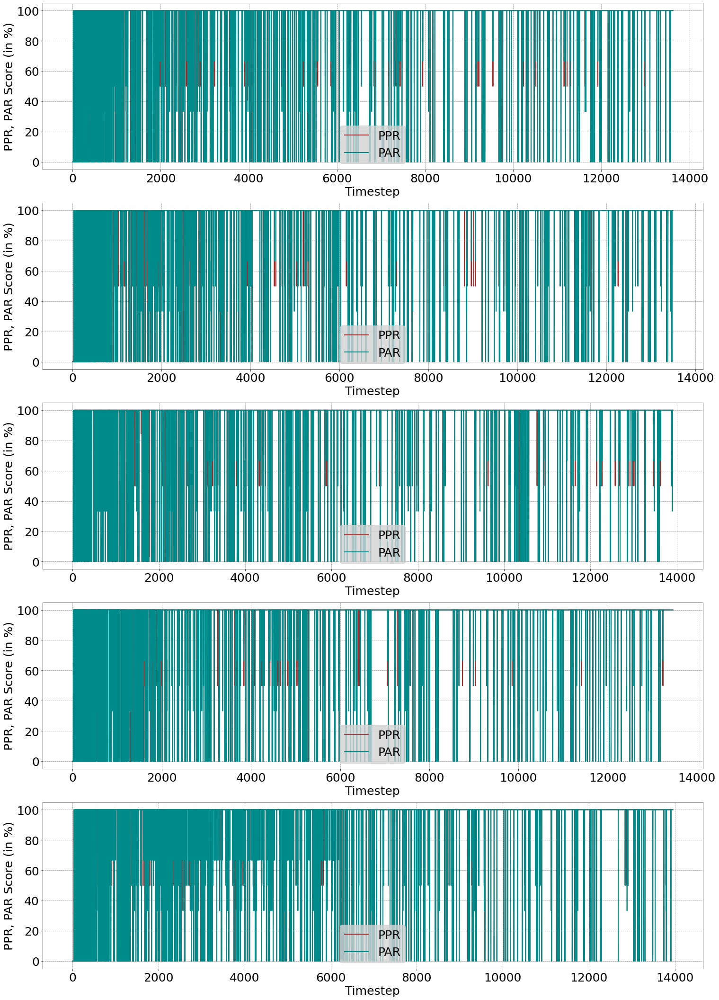

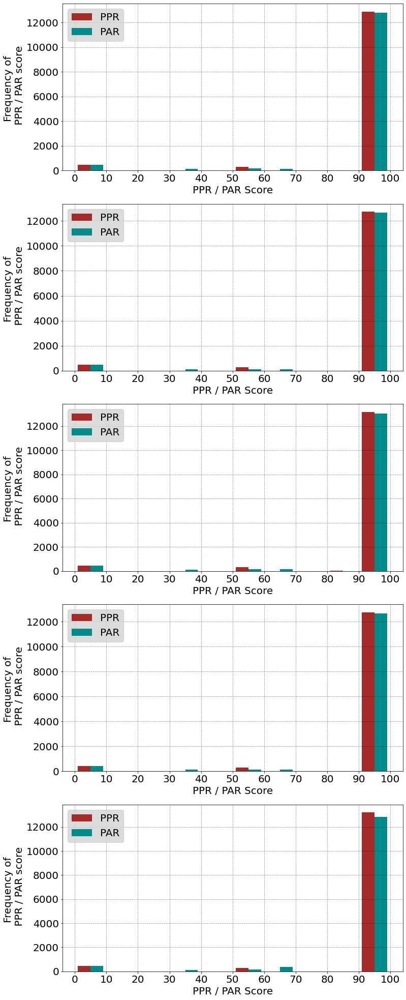

In [4]:
list_pred_acc = []
list_pred_perf = []
list_pred_perf_perString = []
list_MA_pred_acc = []
list_MA_pred_perf = []

for r in range(n_runs):    
    
    results = list_results[r]
    rg_inputoutput = list_rg_inputoutput[r]
    
    pred_acc = []
    pred_perf = []
    pred_perf_perString = []
    MA_pred_acc = []
    MA_pred_perf = []
    for string_idx in range(nof_strings):

        performancePerString = []
        for step in range(len(results.iloc[string_idx]['htm_preds'])):
            
            correct_preds_cols_idx = np.where(rg_inputoutput[string_idx][2][step])[0]
            # Correct expected predictions for the particular <[string_idx][step]> timestep

            predicted_cols_idx = np.unique(np.where(results.iloc[string_idx]['htm_preds'][step])[1])
            # Indices of the cols predicted by the network for particular <[string_idx][step]> timestep.

            count=0
            for col_idx in correct_preds_cols_idx:
                if col_idx in predicted_cols_idx:
                    count+=1

            if len(predicted_cols_idx) == 0:
                accuracy = 0.0
            else:
                accuracy = (count/len(predicted_cols_idx))*100

            performance = (count/len(correct_preds_cols_idx))*100

            pred_acc.append((accuracy, (string_idx, step)))
            pred_perf.append((performance, (string_idx, step)))
            performancePerString.append(performance)

        pred_perf_perString.append(np.mean(performancePerString))

    i = 0
    while i+100 < len(pred_perf):
        MA_pred_acc.append(np.mean([acc_[0] for acc_ in pred_acc[i:i+100]]))
        MA_pred_perf.append(np.mean([perf_[0] for perf_ in pred_perf[i:i+100]]))
        i+=1
    
    list_pred_acc.append(pred_acc)
    list_pred_perf.append(pred_perf)
    list_pred_perf_perString.append(pred_perf_perString)
    list_MA_pred_acc.append(MA_pred_acc)    
    list_MA_pred_perf.append(MA_pred_perf)    
    
    #____________________________PPR and PAR PLOTS_________________________________________
    plt.figure(1, figsize=(25, 7.5*n_runs))
    plt.subplot(n_runs,1,r+1)
    plt.plot([perf_[0] for perf_ in pred_perf], label='PPR', color='brown', lw=2)
    plt.plot([acc_[0] for acc_ in pred_acc], label='PAR', color='darkcyan', lw=2)
    plt.ylabel('PPR, PAR Score (in %)', fontsize=25)
    plt.yticks(fontsize=25)
    plt.xlabel('Timestep', fontsize=25)
    plt.xticks(fontsize=25)
    plt.legend(loc='lower center', facecolor='lightgrey', fontsize=25)
    plt.grid(True, linestyle="--", color='black', alpha=0.4)
    #plt.title(f'Mean prediction accuracy (in %): {np.mean([pred_[0] for pred_ in pred_acc])}')

    #_____________Frequency bar_________________
    plt.figure(2, figsize=(12, 7*n_runs))
    plt.subplot(n_runs,1,r+1)
    plt.hist([[perf_[0] for perf_ in pred_perf],[acc_[0] for acc_ in pred_acc]], bins=np.arange(0,110,10),
             color=['brown', 'darkcyan'], label=['PPR', 'PAR'])
    plt.ylabel('Frequency of \n PPR / PAR score', fontsize=20)
    plt.yticks(fontsize=20)
    plt.xlabel('PPR / PAR Score', fontsize=20)
    plt.xticks(np.arange(0,110,10), fontsize=20)
    plt.legend(loc='upper left', facecolor='lightgrey', fontsize=20)
    plt.grid(True, linestyle="--", color='black', alpha=0.4)

    #____________________________P3S PLOTS________________________________________________
#     plt.figure(3, figsize=(25, 7.5*n_runs))
#     plt.subplot(n_runs,1,r+1)
#     plt.plot(pred_perf_perString, label='P3S', color='darkgreen', lw=2)
#     plt.ylabel('P3S Score (in %)', fontsize=25)
#     plt.yticks(fontsize=25)
#     plt.xlabel('String Index', fontsize=25)
#     plt.xticks(fontsize=25)
#     plt.grid(True, linestyle="--", color='black', alpha=0.4)
    
    #_____________Frequency bar_________________
#     plt.figure(4, figsize=(10, 5*n_runs))
#     plt.subplot(n_runs,1,r+1)
#     plt.hist(pred_perf_perString, color='darkgreen')
#     plt.ylabel('Frequency of P3S', fontsize=15)
#     plt.yticks(fontsize=15)
#     plt.xlabel('P3S', fontsize=15)
#     plt.xticks(fontsize=15)

plt.show()
plt.close()
    
#     print('Mean PAR: ', np.mean([acc_[0] for acc_ in pred_acc]))
#     print('Mean PPR: ', np.mean([perf_[0] for perf_ in pred_perf]))

    # count_PAR = collections.Counter([acc_[0] for acc_ in pred_acc])
    # count_PPR = collections.Counter([perf_[0] for perf_ in pred_perf])

    # print('\n\nPAR Frequencies: ')
    # for key in sorted(dict(count_PAR).keys()):
    #     print(key,':: ', dict(count_PAR)[key])

    # print('\n\nPPR Frequencies: ')
    # for key in sorted(dict(count_PPR).keys()):
    #     print(key,':: ', dict(count_PPR)[key])        

### Plotting P3S and MAs of PPR, PAR scores with Mean and SD

In [5]:
shortest_inputstream = np.min([len(MA_) for MA_ in list_MA_pred_perf])
[len(MA_) for MA_ in list_MA_pred_perf]

[13524, 13399, 13811, 13361, 13852]

In [225]:
%matplotlib inline

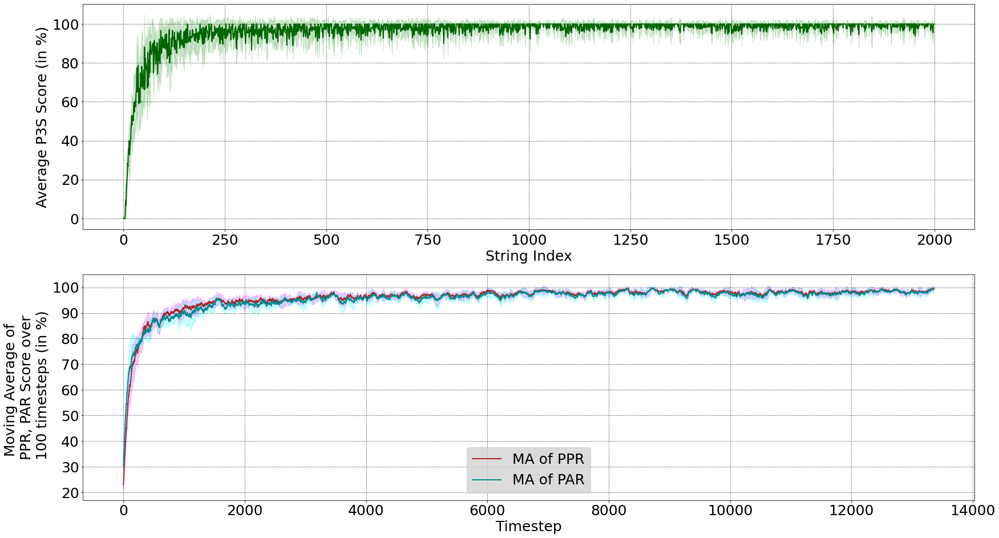

In [6]:
avg_p3s = []
sd_p3s = []
for st_ in range(nof_strings):
    avg_p3s.append(np.mean([list_pred_perf_perString[r][st_] for r in range(n_runs)]))
    sd_p3s.append(np.std([list_pred_perf_perString[r][st_] for r in range(n_runs)]))
    
avg_p3s = np.array(avg_p3s)
sd_p3s = np.array(sd_p3s)
    
avg_MAppr=[]
sd_MAppr=[]
avg_MApar=[]
sd_MApar=[]
for step in range(shortest_inputstream):
    avg_MAppr.append(np.mean([list_MA_pred_perf[r][step] for r in range(n_runs)]))
    sd_MAppr.append(np.std([list_MA_pred_perf[r][step] for r in range(n_runs)]))
    
    avg_MApar.append(np.mean([list_MA_pred_acc[r][step] for r in range(n_runs)]))
    sd_MApar.append(np.std([list_MA_pred_acc[r][step] for r in range(n_runs)]))

avg_MAppr = np.array(avg_MAppr)
sd_MAppr = np.array(sd_MAppr)
avg_MApar = np.array(avg_MApar)
sd_MApar = np.array(sd_MApar)
    
# PLOTTING THE AVERAGE P3S SCORE
plt.figure(5, figsize=(28, 8*2))
plt.subplot(2,1,1)
plt.plot(avg_p3s, label='P3S', color='darkgreen', lw=2)
plt.fill_between([i for i in range(nof_strings)], avg_p3s-sd_p3s, avg_p3s+sd_p3s, color='green', alpha=0.2)
plt.ylabel('Average P3S Score (in %)', fontsize=25)
plt.yticks(fontsize=25)
plt.xlabel('String Index', fontsize=25)
plt.xticks(fontsize=25)
plt.grid(True, linestyle="--", color='black', alpha=0.6)

# PLOTTING THE AVERAGE MAs OF PAR AND PPR SCORES
plt.subplot(2,1,2)
plt.plot(avg_MAppr, label='MA of PPR', color='brown', lw=2)
plt.fill_between([i for i in range(shortest_inputstream)], avg_MAppr-sd_MAppr, avg_MAppr+sd_MAppr, color='magenta', alpha=0.2)
plt.plot(avg_MApar, label='MA of PAR', color='darkcyan', lw=2)
plt.fill_between([i for i in range(shortest_inputstream)], avg_MApar-sd_MApar, avg_MApar+sd_MApar, color='cyan', alpha=0.2)
plt.ylabel('Moving Average of \n PPR, PAR Score over \n 100 timesteps (in %)', fontsize=25)
plt.yticks(fontsize=25)
plt.xlabel('Timestep', fontsize=25)
plt.xticks(fontsize=25)
plt.legend(loc='lower center', facecolor='lightgrey', fontsize=25)
plt.grid(True, linestyle="--", color='black', alpha=0.6)

plt.show()
plt.close()

In [15]:
display(np.mean(avg_p3s[1800:]))
display(np.mean(avg_MAppr[12000:]))

99.16473231940918

98.49121969140337

### Plotting String Length distribution

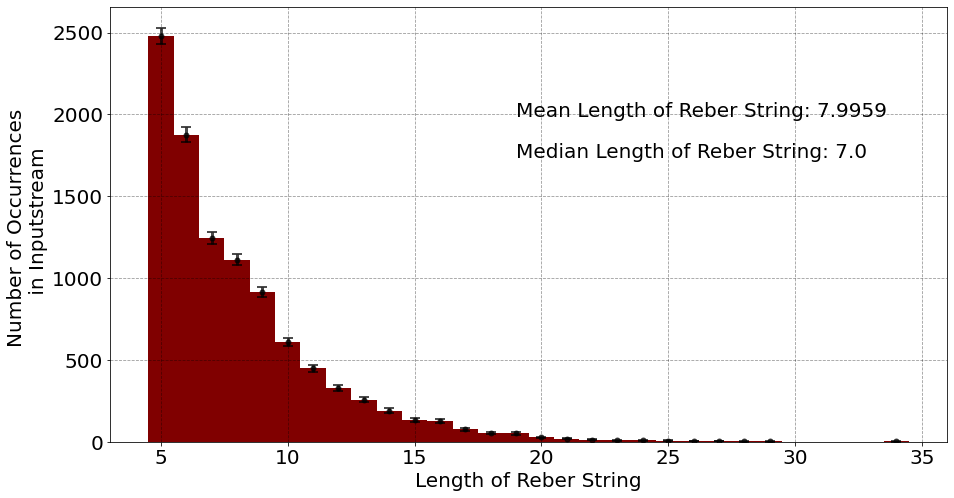

In [8]:
len_rg_examples = []
for r in range(n_runs):
    len_rg_examples += in_strings_stats[r]['len_rg_exs']
    
y,binEdges = np.histogram(len_rg_examples,bins=np.unique(len_rg_examples))

plt.figure(figsize=(15,8))
plt.bar(binEdges[:-1], y, width=1, color='maroon')
plt.errorbar(binEdges[:-1], y, yerr=np.sqrt(y), fmt='o', color='Black', elinewidth=3,capthick=2, alpha=0.7, markersize=5, capsize=5)
plt.ylabel('Number of Occurrences \n in Inputstream', fontsize=20)
plt.xlabel('Length of Reber String', fontsize=20)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.text(x=binEdges[-1]/2, y=0.8*y[0], s=f'Mean Length of Reber String: {np.mean(len_rg_examples)}', fontsize=20)
plt.text(x=binEdges[-1]/2, y=0.7*y[0], s=f'Median Length of Reber String: {np.median(len_rg_examples)}', fontsize=20)
plt.grid(True, linestyle="--", color='black', alpha=0.4)
plt.show()
plt.close()

# len_rg_examples = []
# for r in range(n_runs):
#     len_rg_examples += in_strings_stats[r]['len_rg_exs']
    
# y,binEdges = np.histogram(len_rg_examples,bins=15)
# plt.figure(figsize=(15,8))
# #plt.bar(0.05*(binEdges[1:]+binEdges[:-1]), y, width=0.1, color='green', yerr=np.sqrt(y))
# plt.bar(binEdges[:-1], y, width=1, color='maroon')
# plt.errorbar(binEdges[:-1], y, yerr=np.sqrt(y), fmt='o', color='Black', elinewidth=3,capthick=2, alpha=0.7, markersize=5, capsize=5)
# plt.ylabel('Number of Occurrences \n in Inputstream', fontsize=20)
# plt.xlabel('Length of Reber String', fontsize=20)
# plt.xticks(fontsize=20)
# plt.yticks(fontsize=20)
# plt.text(x=15, y=3500, s=f'Mean Length of Reber String: {np.mean(len_rg_examples)}', fontsize=20)
# plt.text(x=14.35, y=3180, s=f'Median Length of Reber String: {np.median(len_rg_examples)}', fontsize=20)
# plt.grid(True, linestyle="--", color='black', alpha=0.4)
# plt.show()
# plt.close()